<a href="https://colab.research.google.com/github/manognapalla/Data-Science-Methods/blob/master/Combined_DSEM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#INFO 6105: Data Science Engineering Methods

# Assignment Combine Data Cleaning, Feature Selection, Modeling and Interpretability into one report 🐾

Combine Data Cleaning, Feature Selection, Modeling, and Interpretability into one report (Every assignment except TMINST) and make it a cohesive readable report.

The focus is readability and clarity.

The following must be answered:

1. What is the question?

2. What did you do?

3. How well did it work?

4. What did you learn?



# ML Data Cleaning and Feature Selection

In this assignment, we used a dataset for predictive learning and check the quality of the data and determine which features are important.

The dataset used is Dataset: https://archive.ics.uci.edu/dataset/10/automobile

The Automobile Dataset offers insights into the characteristics of automobiles and their pricing. This dataset encompasses a range of attributes related to automobiles, including details about their make, model, fuel type, engine specifications, and more. The primary focus of analysis within this dataset is predicting the price of automobiles based on the available features.

In [ ]:
!pip install ucimlrepo

from ucimlrepo import fetch_ucirepo

# fetch dataset
automobile = fetch_ucirepo(id=10)

# data (as pandas dataframes)
X = automobile.data.features
y = automobile.data.targets

# metadata
print(automobile.metadata)

# variable information
print(automobile.variables)





{'uci_id': 10, 'name': 'Automobile', 'repository_url': 'https://archive.ics.uci.edu/dataset/10/automobile', 'data_url': 'https://archive.ics.uci.edu/static/public/10/data.csv', 'abstract': "From 1985 Ward's Automotive Yearbook", 'area': 'Other', 'tasks': ['Regression'], 'characteristics': ['Multivariate'], 'num_instances': 205, 'num_features': 25, 'feature_types': ['Categorical', 'Integer', 'Real'], 'demographics': [], 'target_col': ['symboling'], 'index_col': None, 'has_missing_values': 'yes', 'missing_values_symbol': 'NaN', 'year_of_dataset_creation': 1985, 'last_updated': 'Thu Aug 10 2023', 'dataset_doi': '10.24432/C5B01C', 'creators': ['Jeffrey Schlimmer'], 'intro_paper': None, 'additional_info': {'summary': 'This data set consists of three types of entities: (a) the specification of an auto in terms of various characteristics, (b) its assigned insurance risk rating, (c) its normalized losses in use as compared to other cars.  The second rating corresponds to the degree to which th

In [ ]:
#all necessary imports
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pylab as plt
from matplotlib import pyplot

In [ ]:
# Importing the necessary libraries
import pandas as pd

# Reading the automobile dataset
from ucimlrepo import fetch_ucirepo

# Fetching dataset
automobile = fetch_ucirepo(id=10)

# Creating a DataFrame from the dataset
df = pd.DataFrame(data=automobile.data.features, columns=automobile.data.feature_names)

# Display the first few rows of the DataFrame
df.head()


,price,highway-mpg,city-mpg,peak-rpm,horsepower,compression-ratio,stroke,bore,fuel-system,engine-size,...,length,wheel-base,engine-location,drive-wheels,body-style,num-of-doors,aspiration,fuel-type,make,normalized-losses
0,13495.0,27,21,5000.0,111.0,9.0,2.68,3.47,mpfi,130,...,168.8,88.6,front,rwd,convertible,2.0,std,gas,alfa-romero,NaN
1,16500.0,27,21,5000.0,111.0,9.0,2.68,3.47,mpfi,130,...,168.8,88.6,front,rwd,convertible,2.0,std,gas,alfa-romero,NaN
2,16500.0,26,19,5000.0,154.0,9.0,3.47,2.68,mpfi,152,...,171.2,94.5,front,rwd,hatchback,2.0,std,gas,alfa-romero,NaN
3,13950.0,30,24,5500.0,102.0,10.0,3.40,3.19,mpfi,109,...,176.6,99.8,front,fwd,sedan,4.0,std,gas,audi,164.0
4,17450.0,22,18,5500.0,115.0,8.0,3.40,3.19,mpfi,136,...,176.6,99.4,front,4wd,sedan,4.0,std,gas,audi,164.0


Identifying the kinds of data in the dataset.

In [ ]:
# Checking the data types of each column
data_types = df.dtypes

# Printing the data types
print(data_types)

price                float64
highway-mpg            int64
city-mpg               int64
peak-rpm             float64
horsepower           float64
compression-ratio    float64
stroke               float64
bore                 float64
fuel-system           object
engine-size            int64
num-of-cylinders       int64
engine-type           object
curb-weight            int64
height               float64
width                float64
length               float64
wheel-base           float64
engine-location       object
drive-wheels          object
body-style            object
num-of-doors         float64
aspiration            object
fuel-type             object
make                  object
normalized-losses    float64
dtype: object


From the above result we understand that there are mainly 2 types of data:

Numeric Data Type
float64: These are floating-point numbers and represent continuous numerical data. Examples in the automobile dataset include price, peak-rpm, horsepower, compression-ratio, stroke, bore, height, width, length, wheel-base, and normalized-losses.

int64: These are integer numbers and represent discrete numerical data. Examples in the dataset highway-mpg, city-mpg, engine-size, num-of-cylinders, curb-weight, and num-of-doors.

Categorical Data Types
object: These are categorical variables and represent non-numeric, discrete categories or labels. Examples include fuel-system, engine-type, engine-location, drive-wheels, body-style, aspiration, fuel-type, and make.

Checking for missing values:

In [ ]:
# Checking for missing values in the entire DataFrame
total_missing = df.isna().sum().sum()

# Display columns with missing values and their counts

missing_values = df.isna().sum()

print(missing_values)

# Print the total count of missing values in the entire DataFrame
print("Total missing values:", total_missing)


price                 4
highway-mpg           0
city-mpg              0
peak-rpm              2
horsepower            2
compression-ratio     0
stroke                4
bore                  4
fuel-system           0
engine-size           0
num-of-cylinders      0
engine-type           0
curb-weight           0
height                0
width                 0
length                0
wheel-base            0
engine-location       0
drive-wheels          0
body-style            0
num-of-doors          2
aspiration            0
fuel-type             0
make                  0
normalized-losses    41
dtype: int64
Total missing values: 59


In [ ]:
import pandas as pd

# Loading dataset into a Pandas DataFrame
# df = pd.read_csv('your_dataset.csv')

# Remove rows with missing values (NaN) in any column
df_cleaned = df.dropna()


# df_cleaned = df.dropna(axis=1)



# Reset the index of the cleaned DataFrame (optional)
df_cleaned.reset_index(drop=True, inplace=True)

# Now, 'df_cleaned' contains the dataset with missing values removed


Cleaning the data to make sure there are no missing values and removing them.

In [ ]:
# Check for missing values in the cleaned DataFrame
missing_values_cleaned = df_cleaned.isna().sum()

# Display columns with missing values and their counts
print(missing_values_cleaned)


price                0
highway-mpg          0
city-mpg             0
peak-rpm             0
horsepower           0
compression-ratio    0
stroke               0
bore                 0
fuel-system          0
engine-size          0
num-of-cylinders     0
engine-type          0
curb-weight          0
height               0
width                0
length               0
wheel-base           0
engine-location      0
drive-wheels         0
body-style           0
num-of-doors         0
aspiration           0
fuel-type            0
make                 0
normalized-losses    0
dtype: int64


What are the likely distributions of the numeric variables?
To identify the likely distributions of the numeric variables in the dataset, we can analyze the data and visualize it. While you'll want to use specific statistical tests and visualization techniques to confirm distributions, you can make initial assessments based on common expectations. Here are the likely distributions for numeric variables:

Variables like horsepower, peak-rpm, compression-ratio, stroke, bore, engine-size, curb-weight, height, width, length, and wheel-base may follow approximately normal distributions, especially if they represent physical characteristics or measurements. Normal distributions are characterized by a bell-shaped curve. Variables like highway-mpg and city-mpg could have a right-skewed or exponential distribution. These variables often represent fuel efficiency, where most values are clustered at lower values (high fuel efficiency), and fewer values are at higher values (lower fuel efficiency).

These are just the likely distributions let's find out below:

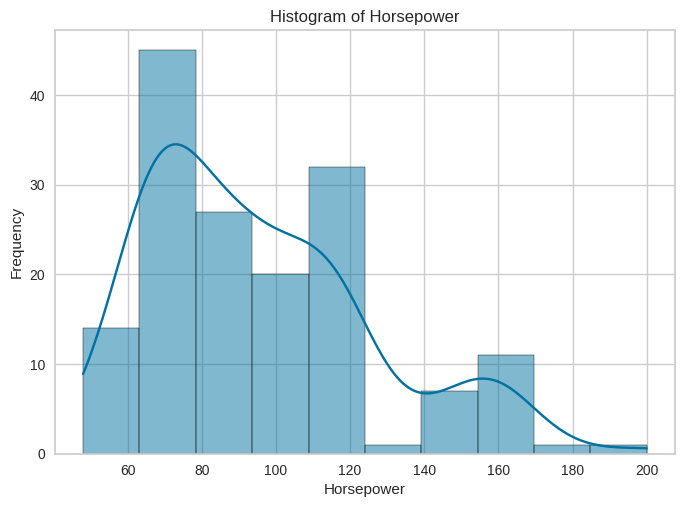

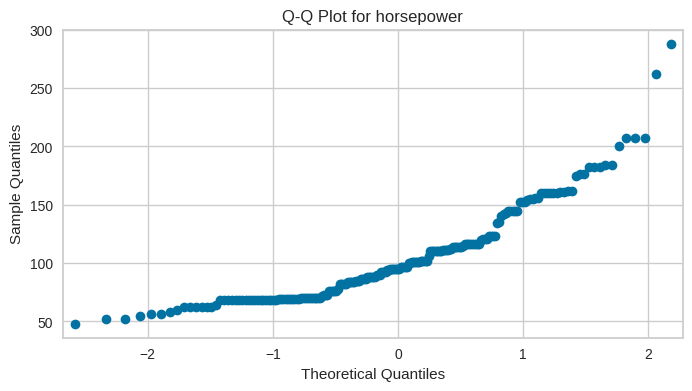

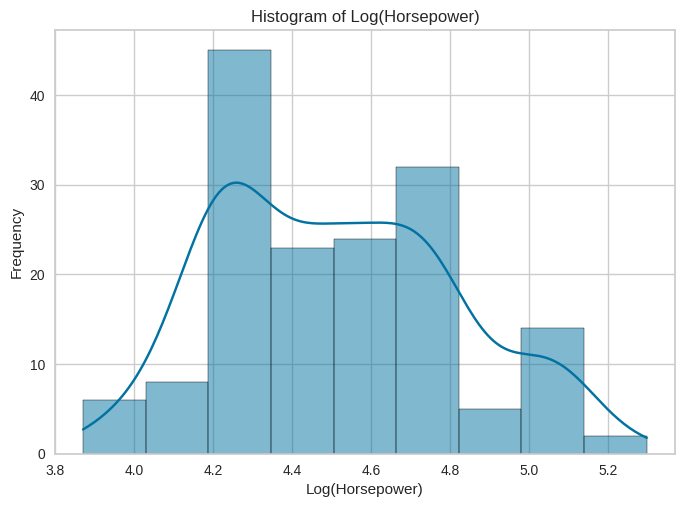

The log-transformed 'horsepower' data is significantly different from a normal distribution.


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import numpy as np
import scipy.stats as stats

# Plot a histogram for 'horsepower'
sns.histplot(df_cleaned['horsepower'], kde=True)
plt.xlabel('Horsepower')
plt.ylabel('Frequency')
plt.title('Histogram of Horsepower')
plt.show()

# Create a Q-Q plot for 'horsepower'
numeric_variable = 'horsepower'
fig, ax = plt.subplots(figsize=(8, 4))
sm.qqplot(df[numeric_variable], line='s', ax=ax)
ax.set_title(f'Q-Q Plot for {numeric_variable}')
plt.show()

# Logarithmic transformation
log_horsepower = np.log(df_cleaned['horsepower'])

# Create a histogram for the log-transformed 'horsepower'
sns.histplot(log_horsepower, kde=True)
plt.xlabel('Log(Horsepower)')
plt.ylabel('Frequency')
plt.title('Histogram of Log(Horsepower)')
plt.show()

# Perform Shapiro-Wilk test on log-transformed 'horsepower'
shapiro_test_result = stats.shapiro(log_horsepower)

# Check the p-value
p_value = shapiro_test_result[1]

if p_value > 0.05:
    print("The log-transformed 'horsepower' data is approximately normally distributed.")
else:
    print("The log-transformed 'horsepower' data is significantly different from a normal distribution.")


Identifying the distribution using data visualization.
The shape of the histogram illustrates the distribution of 'horsepower' in the dataset. The height of each bar represents the number of cars with horsepower values in the corresponding range. The overall pattern of the bars indicates how the data is distributed.

From above, we can see that the bars are skewed to the right (toward lower horsepower values) and there are fewer cars with higher horsepower, it suggests a right-skewed skewed distribution. Majority cars have lower power output compared to the mean horsepower of the dataset.

The Q-Q Plot for horsepower also signifies the same: right skewed distribution.

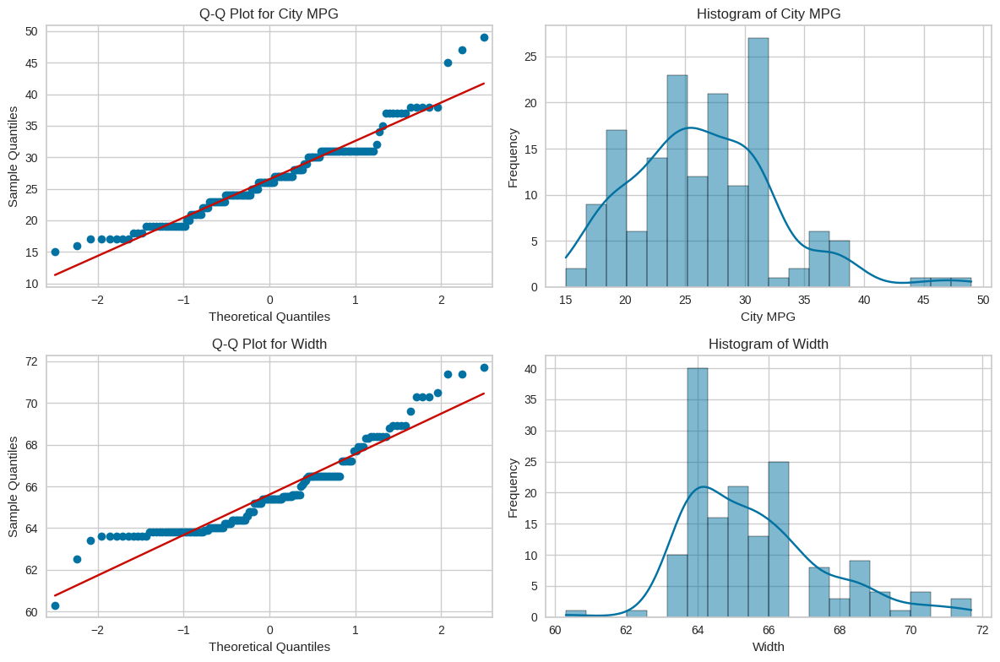

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

city_mpg_data = df_cleaned['city-mpg']
width_data = df_cleaned['width']

# Create a 2x2 grid of subplots for Q-Q plots and histograms
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Q-Q Plot for 'city-mpg'
sm.qqplot(city_mpg_data, line='s', ax=axes[0, 0])
axes[0, 0].set_title('Q-Q Plot for City MPG')

# Histogram for 'city-mpg'
sns.histplot(city_mpg_data, kde=True, bins=20, ax=axes[0, 1])
axes[0, 1].set_xlabel('City MPG')
axes[0, 1].set_ylabel('Frequency')
axes[0, 1].set_title('Histogram of City MPG')

# Q-Q Plot for 'width'
sm.qqplot(width_data, line='s', ax=axes[1, 0])
axes[1, 0].set_title('Q-Q Plot for Width')

# Histogram for 'width'
sns.histplot(width_data, kde=True, bins=20, ax=axes[1, 1])
axes[1, 1].set_xlabel('Width')
axes[1, 1].set_ylabel('Frequency')
axes[1, 1].set_title('Histogram of Width')

# Adjust layout and display the subplots
plt.tight_layout()
plt.show()


The 'length' variable significantly departs from a normal distribution (p-value <= 0.05).


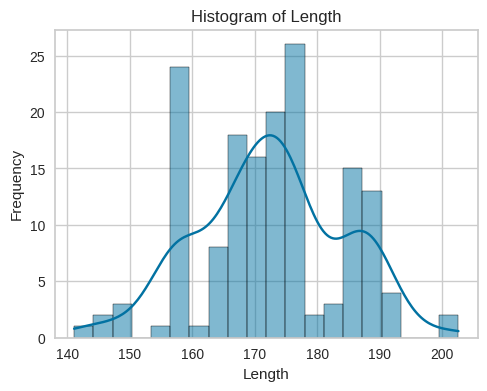

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from scipy import stats

length_data = df_cleaned['length']

# Create a histogram for 'length'
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
sns.histplot(length_data, kde=True, bins=20)
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.title('Histogram of Length')


# Perform the Shapiro-Wilk test to see if it's a normal distribution
shapiro_test_result = stats.shapiro(length_data)

# Check the p-value
p_value = shapiro_test_result[1]

if p_value > 0.05:
    print("The 'length' variable appears to be normally distributed (p-value > 0.05).")
else:
    print("The 'length' variable significantly departs from a normal distribution (p-value <= 0.05).")


What are the distributions of the predictor variables?

<Figure size 600x400 with 0 Axes>

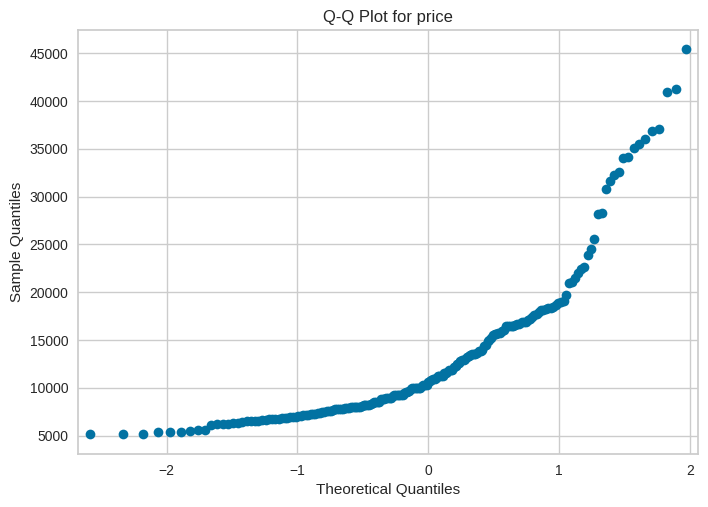

<Figure size 600x400 with 0 Axes>

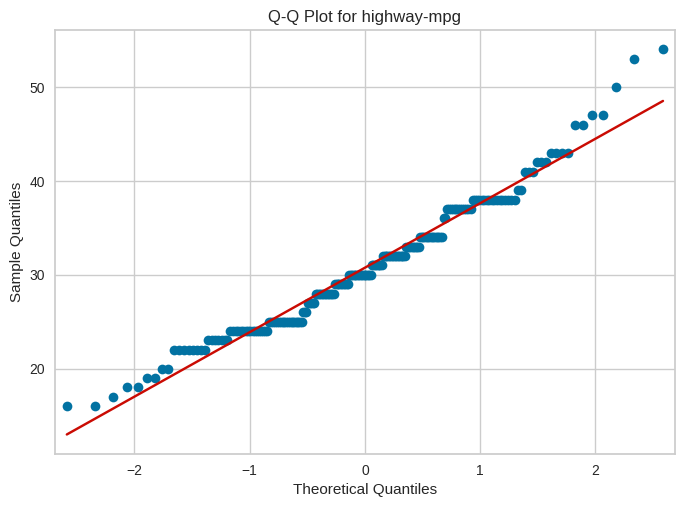

<Figure size 600x400 with 0 Axes>

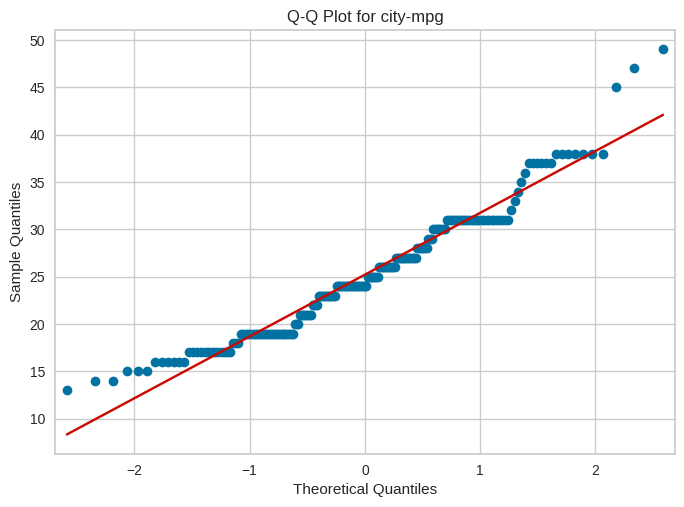

<Figure size 600x400 with 0 Axes>

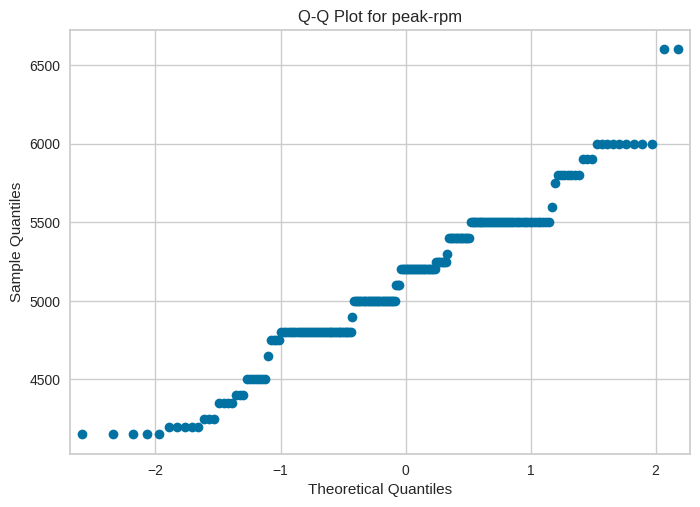

<Figure size 600x400 with 0 Axes>

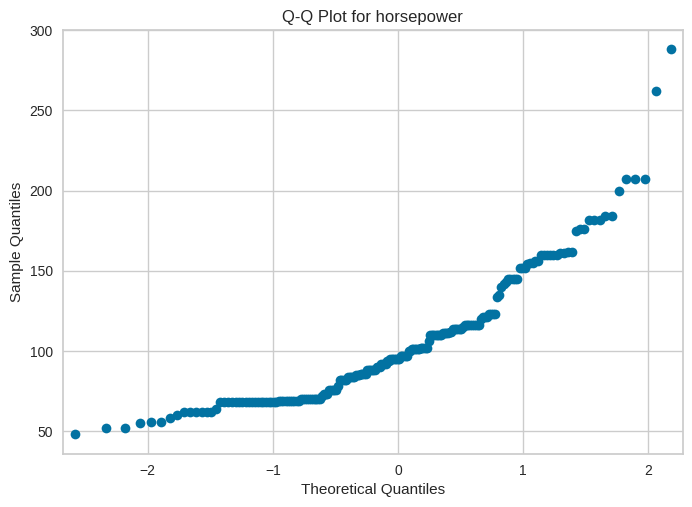

<Figure size 600x400 with 0 Axes>

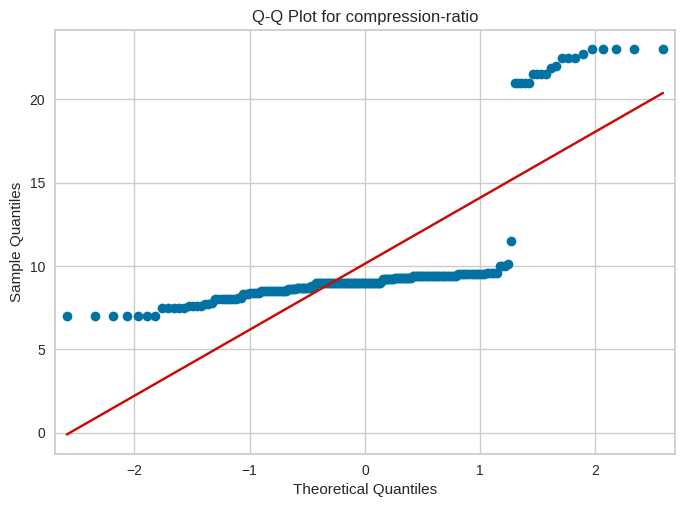

<Figure size 600x400 with 0 Axes>

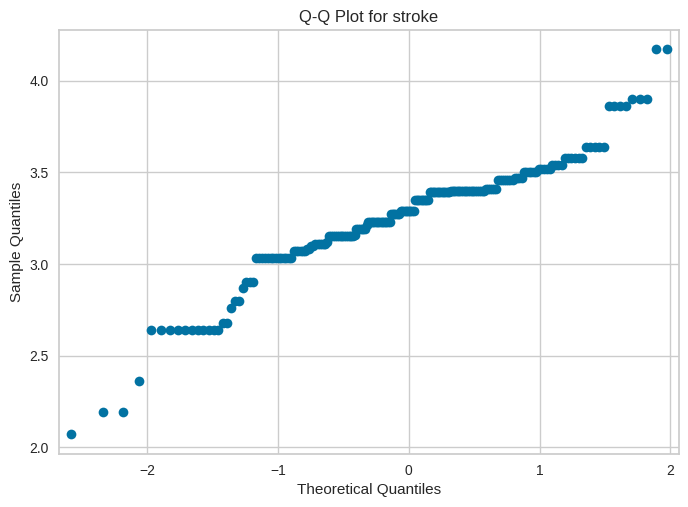

<Figure size 600x400 with 0 Axes>

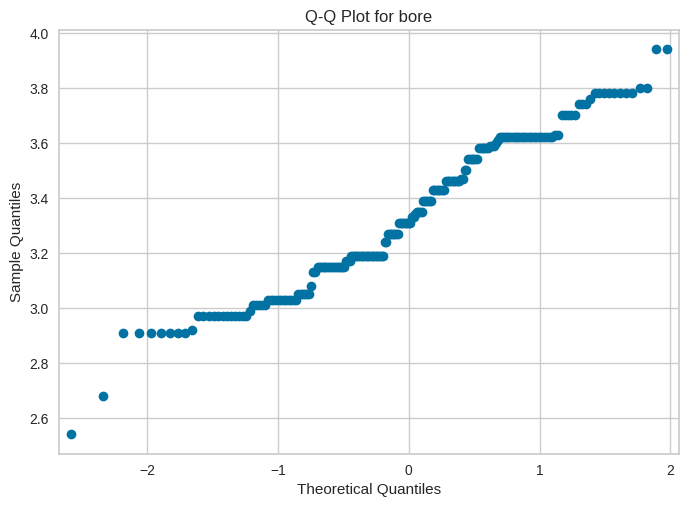

<Figure size 600x400 with 0 Axes>

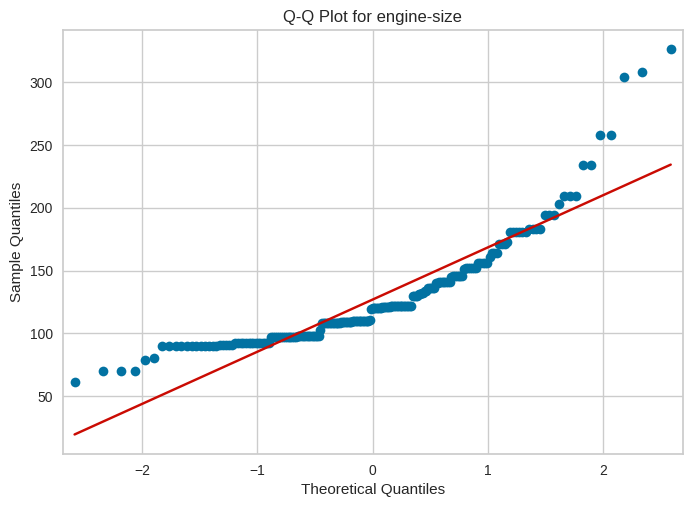

<Figure size 600x400 with 0 Axes>

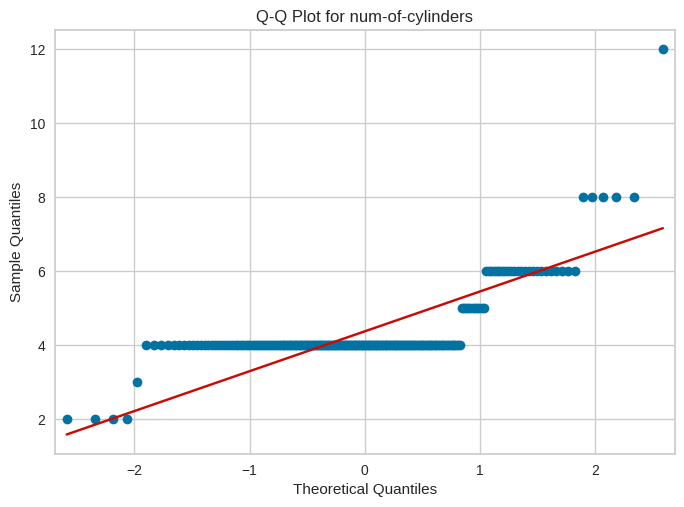

<Figure size 600x400 with 0 Axes>

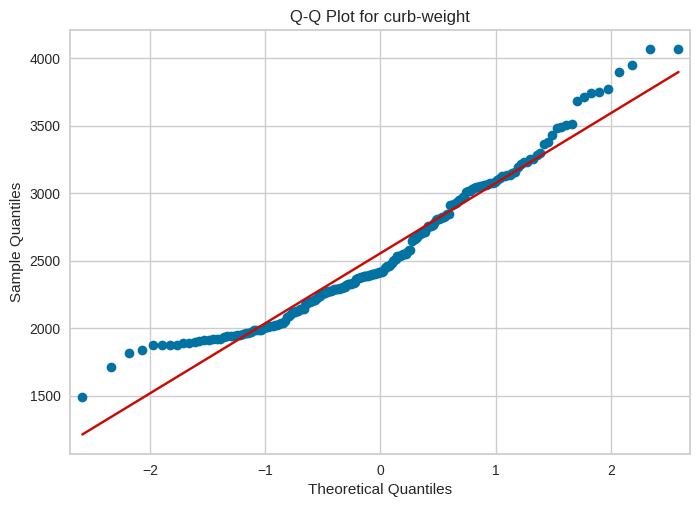

<Figure size 600x400 with 0 Axes>

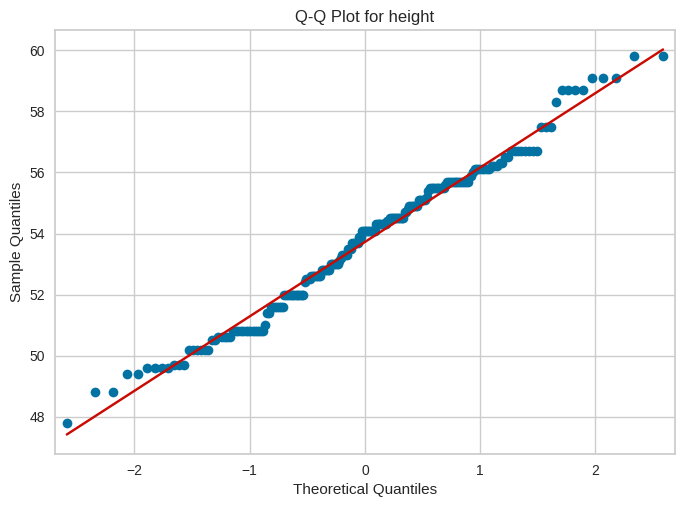

<Figure size 600x400 with 0 Axes>

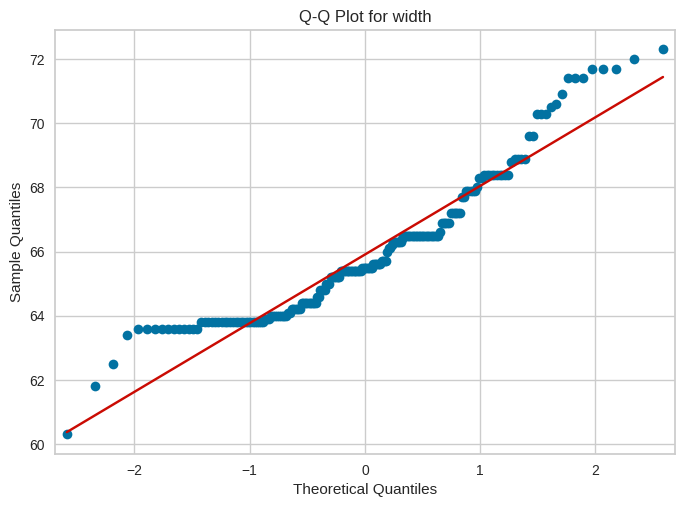

<Figure size 600x400 with 0 Axes>

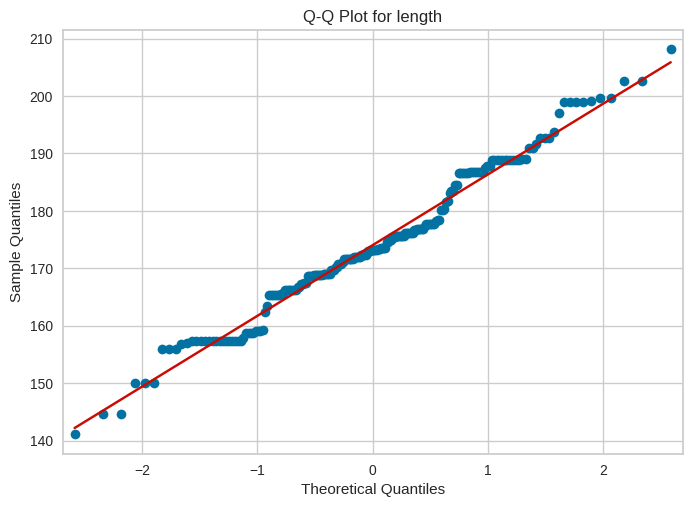

<Figure size 600x400 with 0 Axes>

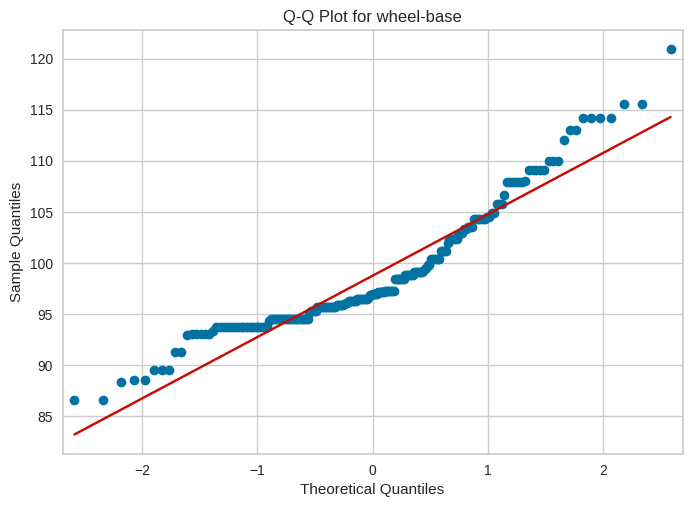

<Figure size 600x400 with 0 Axes>

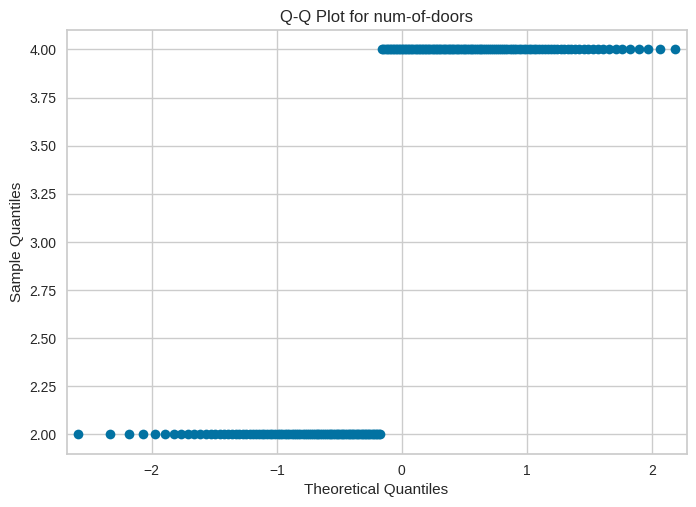

<Figure size 600x400 with 0 Axes>

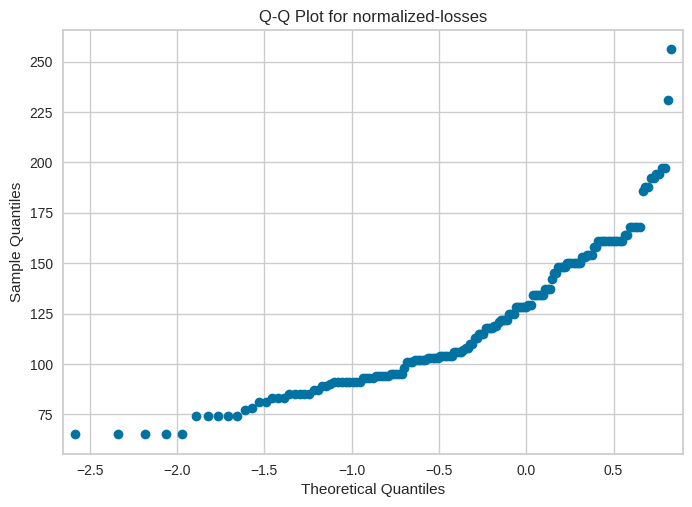

In [ ]:
#all the other qq plots of num variables

import matplotlib.pyplot as plt
import statsmodels.api as sm



# Select only the numeric columns
numeric_columns = df_cleaned.select_dtypes(include=['number'])

# Create Q-Q plots for each numeric variable
for column in numeric_columns.columns:
    plt.figure(figsize=(6, 4))
    sm.qqplot(df[column], line='s')
    plt.title(f'Q-Q Plot for {column}')
    plt.show()


Conclusions like below were derived from the above:
The above q-q plots suggest that variables like height, curb-weight follow a roughly normal distribution.

#Which independent variables are useful to predict a target (dependent variable)?
(Use at least three methods)
We will use 3 methods to predict our target variable that is 'price'.

1st: Using column-wise correlation analysis, we find how each each variable is correlated to the other variable. We will then visualize this using a heat map.

2nd: We use select KBest method for feature selection.

3rd: We use Feature correlation visualizer by Yellowbrick as the third method to identify the independent variables useful to predict the target in our case-- price of the automobile.

In [ ]:

df_cleaned.corr()

<ipython-input-73-c9d43ba49b48>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df_cleaned.corr()


,price,highway-mpg,city-mpg,peak-rpm,horsepower,compression-ratio,stroke,bore,engine-size,num-of-cylinders,curb-weight,height,width,length,wheel-base,num-of-doors,normalized-losses
price,1.000000,-0.720090,-0.692273,-0.171916,0.759874,0.209361,0.160664,0.533890,0.841496,0.641578,0.893639,0.244836,0.843371,0.760952,0.734419,0.162152,0.202761
highway-mpg,-0.720090,1.000000,0.971999,-0.032777,-0.827941,0.221483,-0.012934,-0.590850,-0.714095,-0.519366,-0.789338,-0.226136,-0.693339,-0.724599,-0.611750,-0.160870,-0.188564
city-mpg,-0.692273,0.971999,1.000000,-0.052929,-0.837214,0.278332,-0.020055,-0.590440,-0.699139,-0.484712,-0.762155,-0.199737,-0.666684,-0.724544,-0.580657,-0.165831,-0.235523
peak-rpm,-0.171916,-0.032777,-0.052929,1.000000,0.074057,-0.416769,-0.011312,-0.312269,-0.284686,-0.118165,-0.259988,-0.245864,-0.232216,-0.234074,-0.289234,-0.168896,0.237697
horsepower,0.759874,-0.827941,-0.837214,0.074057,1.000000,-0.162305,0.148804,0.560239,0.812073,0.618514,0.790095,0.034317,0.681872,0.672063,0.516948,0.029959,0.290511
compression-ratio,0.209361,0.221483,0.278332,-0.416769,-0.162305,1.000000,0.243587,0.015119,0.141097,0.061637,0.224724,0.233308,0.258752,0.184814,0.291431,0.115414,-0.127259
stroke,0.160664,-0.012934,-0.020055,-0.011312,0.148804,0.243587,1.000000,-0.102581,0.299683,0.132264,0.173844,-0.091313,0.196619,0.121073,0.167449,-0.028945,0.063330
bore,0.533890,-0.590850,-0.590440,-0.312269,0.560239,0.015119,-0.102581,1.000000,0.595737,0.134820,0.645792,0.254836,0.572554,0.646318,0.578159,0.214539,-0.031558
engine-size,0.841496,-0.714095,-0.699139,-0.284686,0.812073,0.141097,0.299683,0.595737,1.000000,0.770809,0.888626,0.111083,0.779253,0.725953,0.649206,0.085100,0.207820
num-of-cylinders,0.641578,-0.519366,-0.484712,-0.118165,0.618514,0.061637,0.132264,0.134820,0.770809,1.000000,0.595873,-0.058612,0.507360,0.389477,0.312733,-0.013527,0.268157


Creating a heatmap for the above:

<ipython-input-74-0d5f30966e33>:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_cleaned.corr()


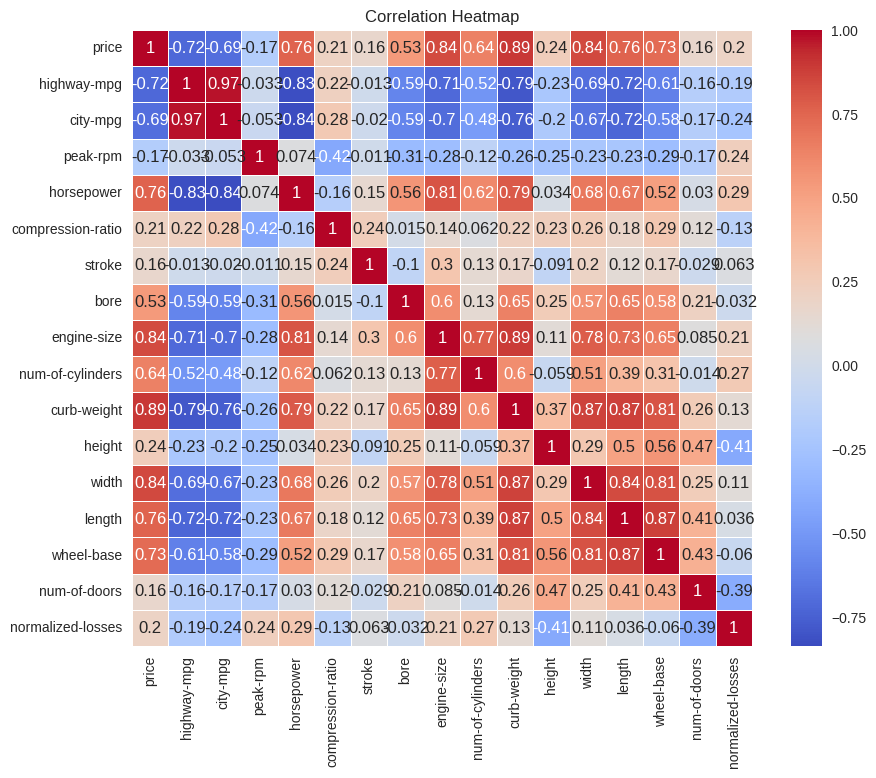

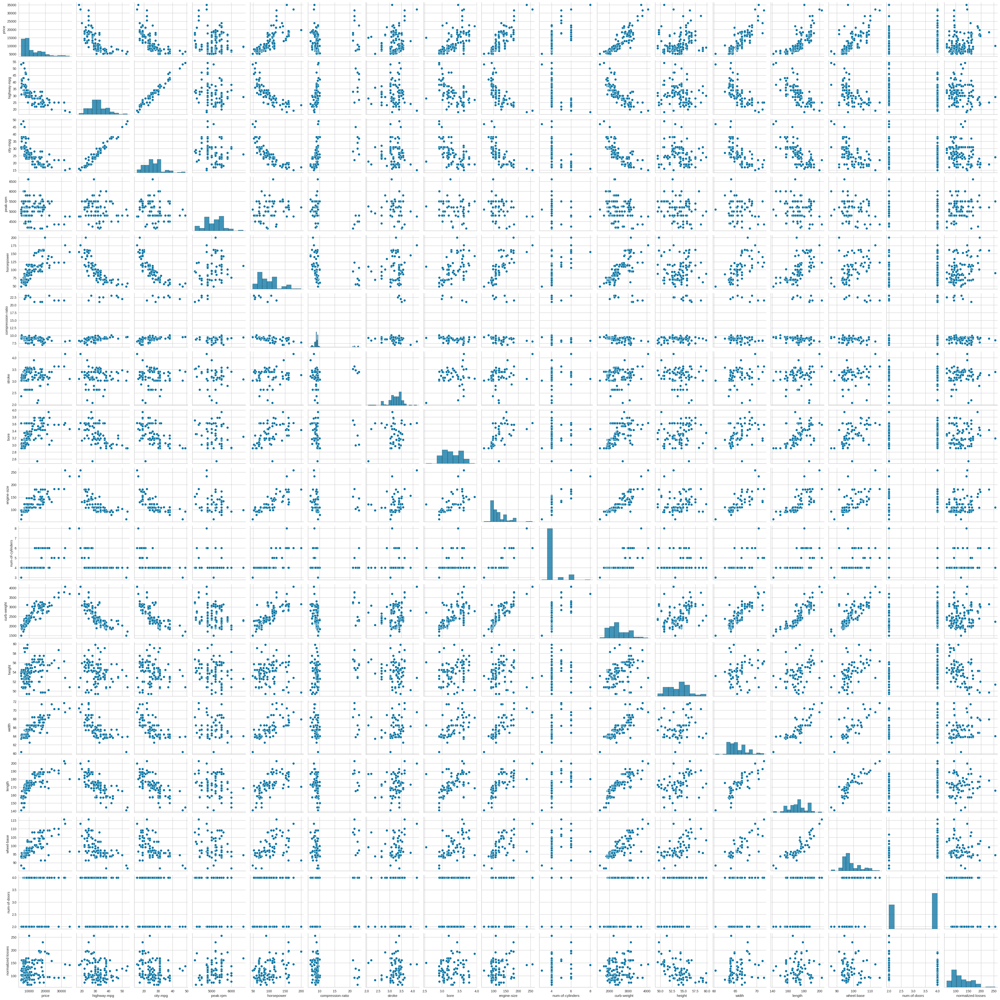

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate the correlation matrix
correlation_matrix = df_cleaned.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()


sns.pairplot(df_cleaned)


# Normalization
We then normalize the data. Normalization is a crucial preprocessing step that enhances the performance and stability of machine learning models by ensuring that features are on a consistent scale, preventing issues related to differences in feature magnitudes, and making the learning process more efficient and effective.

We use the MinMaxScaler to normalize the data, this technique is suitable when you want to preserve the relationships between the values in your dataset but ensure that they fall within a standardized range.

In [ ]:
df_cleaned.head()

,price,highway-mpg,city-mpg,peak-rpm,horsepower,compression-ratio,stroke,bore,fuel-system,engine-size,...,length,wheel-base,engine-location,drive-wheels,body-style,num-of-doors,aspiration,fuel-type,make,normalized-losses
0,13950.0,30,24,5500.0,102.0,10.0,3.4,3.19,mpfi,109,...,176.6,99.8,front,fwd,sedan,4.0,std,gas,audi,164.0
1,17450.0,22,18,5500.0,115.0,8.0,3.4,3.19,mpfi,136,...,176.6,99.4,front,4wd,sedan,4.0,std,gas,audi,164.0
2,17710.0,25,19,5500.0,110.0,8.5,3.4,3.19,mpfi,136,...,192.7,105.8,front,fwd,sedan,4.0,std,gas,audi,158.0
3,23875.0,20,17,5500.0,140.0,8.3,3.4,3.13,mpfi,131,...,192.7,105.8,front,fwd,sedan,4.0,turbo,gas,audi,158.0
4,16430.0,29,23,5800.0,101.0,8.8,2.8,3.50,mpfi,108,...,176.8,101.2,front,rwd,sedan,2.0,std,gas,bmw,192.0


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Initialize the Min-Max scaler
scaler = MinMaxScaler()

# Select the columns you want to normalize (e.g., all numeric columns)
numeric_columns = df_cleaned.select_dtypes(include=['number'])

# Fit the scaler to your data and transform the data
normalized_data = scaler.fit_transform(numeric_columns)

# Create a DataFrame with the normalized data
normalized_df = pd.DataFrame(normalized_data, columns=numeric_columns.columns)

# Display the first few rows of the normalized DataFrame
print(normalized_df.head())


      price  highway-mpg  city-mpg  peak-rpm  horsepower  compression-ratio  \
0  0.295010     0.333333  0.264706  0.551020    0.355263            0.18750   
1  0.411918     0.111111  0.088235  0.551020    0.440789            0.06250   
2  0.420603     0.194444  0.117647  0.551020    0.407895            0.09375   
3  0.626528     0.055556  0.058824  0.551020    0.605263            0.08125   
4  0.377848     0.305556  0.235294  0.673469    0.348684            0.11250   

     stroke      bore  engine-size  num-of-cylinders  curb-weight    height  \
0  0.633333  0.464286     0.243655               0.2     0.329325  0.471154   
1  0.633333  0.464286     0.380711               0.4     0.518231  0.471154   
2  0.633333  0.464286     0.380711               0.4     0.525989  0.605769   
3  0.633333  0.421429     0.355330               0.4     0.619860  0.625000   
4  0.347619  0.685714     0.238579               0.2     0.351823  0.471154   

      width    length  wheel-base  num-of-doors  n

# Which predictor variables are most important?
Below uses Kbest method to answer the above question.

In [ ]:


from sklearn.feature_selection import SelectKBest, f_regression


X = normalized_df  # Independent variables
y = df_cleaned['price']  # Target variable

# Create a SelectKBest instance with f_regression scoring
kbest = SelectKBest(score_func=f_regression, k=5)  # Select the top 5 features

# Fit and transform the data to select the best features
X_new = kbest.fit_transform(X, y)

# Get the indices of the selected features
selected_indices = kbest.get_support(indices=True)

# Get the names of the selected columns
selected_columns = normalized_df.columns[selected_indices]

# Display the selected columns
print("Selected columns:")
print(selected_columns)


Selected columns:
Index(['price', 'engine-size', 'curb-weight', 'width', 'length'], dtype='object')


The above predictors are the most important. The SelectKBest method evaluates the relationship between each independent variable and the target variable ('price' in this case) based on a scoring function (in this case, 'f_regression'). It ranks the features based on their individual predictive power with respect to the target variable.

If 'price' is highly correlated with itself and has a significant linear relationship with the other features, it may rank highly in the feature selection process. Essentially, 'price' is very predictive of itself, which might lead to it being selected as one of the top features.

In practice, if we are using 'price' as the target variable, we typically exclude 'price' from the feature set when training a predictive model because it wouldn't provide useful information for predicting itself. We can simply remove 'price' from the selected features if it is not intended to be used as an independent variable in your modeling process.

We first divide the normalized dataset into 2 parts 80% training and 20% test.

We then use shape function to find if the two datasets are same.

In [ ]:
#Dividing the dataset into training and testing sets

X = normalized_df.drop(['price'], axis=1)
y = normalized_df['price']


In [ ]:
from sklearn.model_selection import train_test_split

# Split the data into training (80%) and testing (20%) sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Print the shapes to verify the split
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)


X_train shape: (127, 16)
X_test shape: (32, 16)
y_train shape: (127,)
y_test shape: (32,)


The above shapes of the training and test data show that testing and training data do not overlap.

Now we make our model:

Now we use Random Forest Regression to train our model and find out the accuracy using Mean squared error and r-squared. We use regression to predict price which is our target variable.

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Initialize the Random Forest Regressor with desired hyperparameters
random_forest_regressor = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
random_forest_regressor.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = random_forest_regressor.predict(X_test)

# Evaluate the model's performance (e.g., using mean squared error)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)

# Calculate the coefficient of determination (R-squared)
r_squared = r2_score(y_test, y_pred)
print("Coefficient of Determination (R-squared):", r_squared)



Mean Squared Error: 0.003621856568626233
Coefficient of Determination (R-squared): 0.8175735309363708


A mean squared error (MSE) of 0.0036 is a measure of the model's accuracy in predicting the 'price' target variable. In this context, the MSE represents the average squared difference between the actual 'price' values (in test set) and the predicted 'price' values generated by Random Forest Regressor model.

A low MSE is a positive sign, indicating that our model is performing well in predicting 'price.'

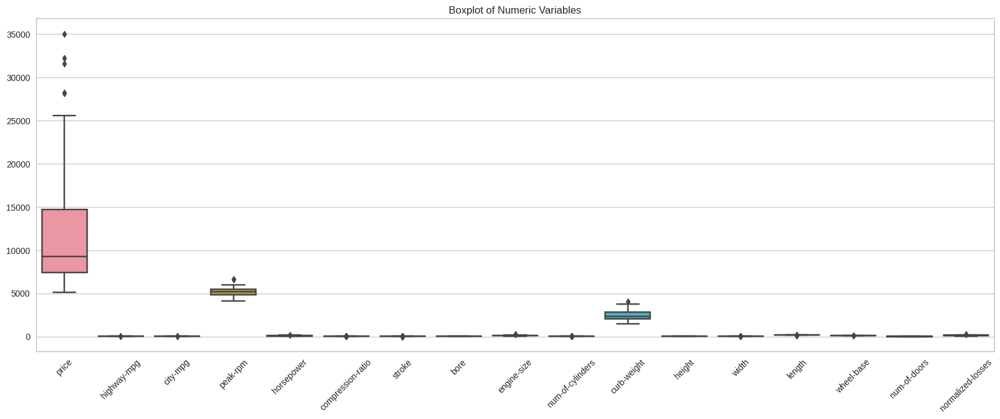

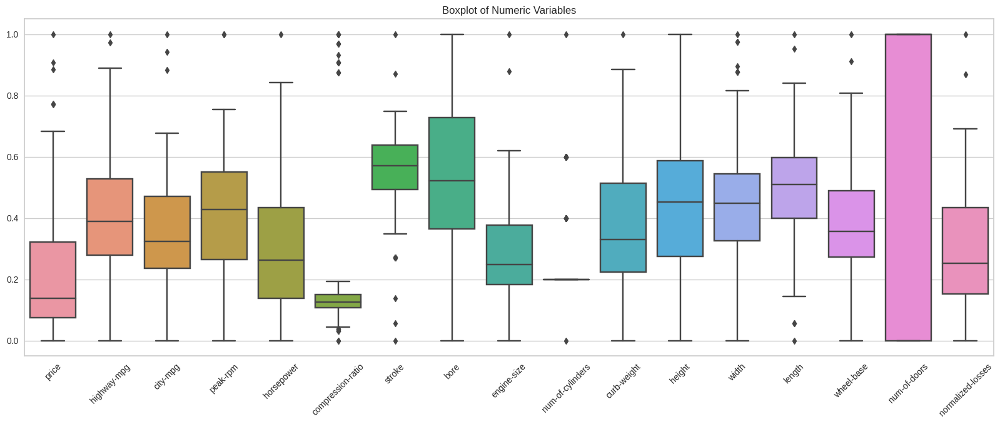

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select only the numeric variables from your DataFrame (df_cleaned)
numeric_variables = df_cleaned.select_dtypes(include=['number'])

# Set the figure size
plt.figure(figsize=(20, 7))

# Create a boxplot for all numeric variables
sns.boxplot(data=numeric_variables)

# Set a title
plt.title('Boxplot of Numeric Variables')

# Rotate x-axis labels for better readability (optional)
plt.xticks(rotation=45)

# Show the plot
plt.show()


# Select only the numeric variables from your DataFrame (df_cleaned)
numeric_variables = normalized_df.select_dtypes(include=['number'])

# Set the figure size
plt.figure(figsize=(20, 7))

# Create a boxplot for all numeric variables
sns.boxplot(data=numeric_variables)

# Set a title
plt.title('Boxplot of Numeric Variables')

# Rotate x-axis labels for better readability (optional)
plt.xticks(rotation=45)

# Show the plot
plt.show()




Creating a subplot for variables when not normalized does not correctly depict the ranges of the variables. When plotted using the normalized data frame we see the following:

highway-mpg and city-mpg are approximately in the same range meaning that miles per gallon does not hugely differ.
There are few outliers which indicate only few cars cost higher than the most cars.
Here's what you can infer from the subplots about the ranges of variables:

Spread and Variation: The width of the box (interquartile range or IQR) in each subplot indicates the range in which the middle 50% of the data falls. A wider box suggests a larger spread of values within that variable.

Median: The horizontal line inside the box represents the median (50th percentile) of the data. It provides insight into the central tendency of the variable's distribution.

Outliers: Any data points beyond the "whiskers" (lines extending from the box) are considered potential outliers. Outliers can indicate extreme values or data points that are significantly different from the rest of the data.

Skewness: The shape of the boxplot can suggest whether the distribution is skewed. For example, if one whisker is longer than the other, it may indicate skewness in that direction.

Comparisons: By having multiple subplots, you can easily compare the range and distribution of different variables side by side. For example, you can visually compare which variables have wider or narrower spreads, which have more outliers, or which have medians at different positions.

# Checking if Outliers removal has a difference on the model accuracy.

Now we use our new dataframes: X_train_no_outliers, y_train_no_outliers as training data for our new model and then use mean squared error to find the accuracy.

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Initialize the Random Forest Regressor with desired hyperparameters
random_forest_regressor = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model to the training data
random_forest_regressor.fit(X_train_no_outliers, y_train_no_outliers)

# Make predictions on the testing data
y_pred = random_forest_regressor.predict(X_test)

# Evaluate the model's performance (e.g., using mean squared error)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)

# Calculate the coefficient of determination (R-squared)
r_squared = r2_score(y_test, y_pred)
print("Coefficient of Determination (R-squared):", r_squared)

Mean Squared Error: 0.0033036715593358656
Coefficient of Determination (R-squared): 0.8335999435383022


# Remove outliers and keep outliers (does if have an effect of the final predictive model)?
The value mean squared error reduced after the removing outliers, meaning that the accuracy of prediction was improved after removal of outliers.

mean squared error before removal of outliers: 0.0036 mean squared error after removal of outliers: 0.0033

The accuracy improved by approximately 8.33%.

Imputation Methods:

We used 3 imputation methods:
1. KNN Imputation method.
2. Mean based SimpleImputer
3. Multivariate Imputation using Chained Equation

#KNN iMPUTATION
The k nearest neighbours is an algorithm that is used for simple classification. The algorithm uses ‘feature similarity’ to predict the values of any new data points. This means that the new point is assigned a value based on how closely it resembles the points in the training set

In [ ]:
# imputed_number_df.sample(10)
imputed_number_df.head()

,1_percent,5_percent,10_percent
0,0.295010,0.295010,0.268375
1,0.411918,0.411918,0.411918
2,0.420603,0.420603,0.426074
3,0.626528,0.626528,0.626528
4,0.377848,0.377848,0.377848


In [ ]:
print(get_percent_missing(imputed_number_df))

           column_name  percent_missing
1_percent    1_percent              0.0
5_percent    5_percent              0.0
10_percent  10_percent              0.0


In [ ]:
price = normalized_df["price"]
imputed_mean = pd.concat([price,imputed_number_df])
imputed_mean.columns = ["Price","1_Percent","5_Percent","10_Percent"]
imputed_mean.var()

Price         0.038547
1_Percent     0.038534
5_Percent     0.037997
10_Percent    0.038530
dtype: float64

The values above are very low, so KNN is a good method of imputation for this dataset.

# Mean based Imputation with Simpleimputer - Method2

In [ ]:
df_imputation_mean = df_imputation[['1_percent','5_percent','10_percent']]


In [ ]:
from sklearn.impute import SimpleImputer
imp_mean = SimpleImputer( strategy='mean') #for median imputation replace 'mean' with 'median'
imp_mean.fit(df_imputation_mean)
imputed_train_df = imp_mean.transform(df_imputation_mean)

In [ ]:
imputed_mean = pd.DataFrame(imp_mean.fit_transform(df_imputation_mean), columns = df_imputation_mean.columns)
print(get_percent_missing(imputed_mean))

           column_name  percent_missing
1_percent    1_percent              0.0
5_percent    5_percent              0.0
10_percent  10_percent              0.0


In [ ]:
price = normalized_df["price"]
combined_mean = pd.concat([price,imputed_mean])
combined_mean.mean()

0             0.211361
1_percent     0.214856
5_percent     0.205343
10_percent    0.219269
dtype: float64

original "price" column from normalized_df and another column named imputed_mean after mean imputation.

# Multivariate Imputation by Chained Equation - Method 3

Multivariate Imputation by Chained Equation (MICE) is an advanced imputation technique that goes beyond single imputations. It operates by iteratively filling in missing data multiple times, leading to more robust and reliable imputed values. Unlike single imputations, Multiple Imputations (MIs) account for the inherent uncertainty associated with missing values more effectively.

The key strength of the chained equations approach, such as MICE, lies in its flexibility. It can handle various types of variables, including continuous and binary, within the same dataset. Additionally, it's capable of addressing complexities like handling data with bounds or dealing with survey skip patterns. This adaptability makes MICE a powerful tool for imputing missing data in diverse and challenging scenarios.

In [ ]:
from impyute.imputation.cs import mice

# start the MICE training
imputed_training=mice(df_imputation_mice.values)

In [ ]:
imputed_training = pd.DataFrame(imputed_training)
imputed_training.columns = ("1_percent","5_percent","10_percent")

In [ ]:
# imputed_mice = pd.DataFrame(imputed_training.fit_transform(df_imputation_mice), columns = df_imputation_mice.columns)
print(get_percent_missing(imputed_training))

           column_name  percent_missing
1_percent    1_percent              0.0
5_percent    5_percent              0.0
10_percent  10_percent              0.0


This again showed MICE is a good imputation method for this dataset. The fact that the means of these columns are approximately equal (around 0.211) suggests that the imputed values are relatively close to the actual 'price' values in your dataset. It indicates that the imputation process has been successful in maintaining the central tendency of the data, at least in terms of means.

This was the first assignment,

# What did we learn?

We learnt Data Preprocessing, feature selection, imputation and normalization in this assignment.

We identified most important predictor variables and explored the data.

Data Preprocessing: Initial data preparation steps are undertaken, including addressing missing data, encoding categorical variables, and standardizing or normalizing numeric features. Data preprocessing ensures that the dataset is in an optimal format for modeling.

Feature Selection: Determining which features are most influential in predicting 'price' and selecting the relevant attributes for the model-building process.

Model Selection: Choosing an appropriate regression model is a key decision. Options include linear regression, decision tree regression, random forest regression, and others.

Model Training: The selected regression model is trained using the training dataset, where it learns the relationships between the features and the target variable ('price').

Model Evaluation: The performance of the trained model is assessed through regression evaluation metrics such as Mean Squared Error (MSE), Root Mean Squared Error (RMSE).

Prediction: The trained model is applied to new or unseen data to generate predictions regarding the 'price' of automobiles.

Analysis: The results are analyzed to gain insights into the factors that significantly influence automobile pricing, shedding light on the relationships between various attributes and 'price.'

#Assignment 2 -- AutoML

In this assignment, you will an AutoML library like H2O.ai to create predictive models and interpret them. Find a significant relation for each algorithm of your choosing in your data. Create multivariate models.

For the moment you will assume the data is good. In future assignments, you will check your data, fix data issues and do some feature engineering.

# Dataset update:

Changed dataset from AutoMobile dataset to Disease Outbreak, since H2O did not support UCI datasets and I had to pick https://www.kaggle.com/datasets/eiodelami/disease-outbreaks-in-nigeria-datasets from Kaggle.

 For this dataset age and report year is the dependent variable and others are independent variables. The main affecting factors of the diseases should be selected-- feature selection. Then, a model for disease prediction can established using linear regression. Through data analysis and exploration we will see the model is able to predict the outbreak.

Before we create a model we will do some data cleaning, feature selection and exploratory data analysis of the kaggle dataset.

H2O AutoML is an automated machine learning framework provided by H2O.ai, a company that specializes in open-source software for data science and machine learning. AutoML, in general, refers to the process of automating the end-to-end process of applying machine learning to real-world problems, including data preparation, feature engineering, model selection, and hyperparameter tuning.

Here's an overview of what H2O AutoML does:

1. **Automated Model Selection:** H2O AutoML automatically explores and tests various machine learning algorithms and model architectures to find the best-performing model for a given dataset. This includes traditional algorithms like linear regression, decision trees, and random forests, as well as more complex models like gradient boosting machines and deep learning models.

2. **Hyperparameter Optimization:** For each algorithm, H2O AutoML searches for the optimal hyperparameters. Hyperparameters are configuration settings that are not learned from the data but are set before the training process. Tuning these hyperparameters can significantly impact the performance of a machine learning model.

3. **Feature Engineering:** H2O AutoML can automatically perform basic feature engineering tasks, such as handling missing data, encoding categorical variables, and transforming variables to improve model performance.

4. **Ensemble Learning:** The framework often leverages ensemble learning techniques to combine predictions from multiple models, which can lead to improved overall performance compared to individual models.

5. **Cross-Validation:** H2O AutoML typically uses cross-validation techniques to assess the performance of different models. This involves splitting the dataset into multiple subsets, training the models on some subsets, and validating on the remaining subsets to provide a more robust estimate of model performance.

6. **Scalability:** H2O AutoML is designed to handle large datasets and can take advantage of distributed computing resources to speed up the training process.

The goal of H2O AutoML is to make machine learning more accessible to users with varying levels of expertise by automating many of the complex tasks involved in building and optimizing machine learning models. This allows data scientists and analysts to focus more on understanding the data and interpreting results rather than spending excessive time on the technical intricacies of model building.

In [ ]:
!pip install requests
!pip install tabulate
!pip install "colorama>=0.3.8"
!pip install future
!pip install h2o


# Importing required Libraries
Automated machine learning (AutoML) is the process of automating the end-to-end process of applying machine learning to real-world problems.

H2O AutoML automates the steps like basic data processing, model training and tuning. Ensemble and stacking of various models to provide the models with the best performance so that developers can focus on other steps like data collection, feature engineering and deployment of model.

We will now initialize the same:

In [ ]:
# Importing all the libararies required for the assignment
import h2o
from h2o.automl import H2OAutoML
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.grid.grid_search import H2OGridSearch
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import seaborn as sns
from scipy.stats import pearsonr


import statsmodels.api as sd
from sklearn import tree
import sklearn.metrics as sm
from h2o.estimators.glm import H2OGeneralizedLinearEstimator
import warnings
warnings.filterwarnings("ignore")

sns.set(rc={"figure.figsize": (16, 8)})

#Loading the Dataset and Exploring

Now that we have installed the H2O package, we can proceed with loading the dataset into the H2O environment before performing the necessary data analysis and modeling.

In [ ]:
pandas_df = pd.read_csv("https://raw.githubusercontent.com/manognapalla/Data-Science-Methods/master/meningitis_dataset.csv")
# Reading CSV file into Pandas DataFrame


# Reading and Studying the data

In [ ]:
#finding the columns and types of data in the dataset
pandas_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284484 entries, 0 to 284483
Data columns (total 40 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   id                          284484 non-null  int64 
 1   surname                     284484 non-null  object
 2   firstname                   284484 non-null  object
 3   middlename                  284484 non-null  object
 4   gender                      284484 non-null  object
 5   gender_male                 284484 non-null  int64 
 6   gender_female               284484 non-null  int64 
 7   state                       284484 non-null  object
 8   settlement                  284484 non-null  object
 9   rural_settlement            284484 non-null  int64 
 10  urban_settlement            284484 non-null  int64 
 11  report_date                 284484 non-null  object
 12  report_year                 284484 non-null  int64 
 13  age                         2

In [ ]:
#Finding if there are any null values

pandas_df.isnull().sum()

id                            0
surname                       0
firstname                     0
middlename                    0
gender                        0
gender_male                   0
gender_female                 0
state                         0
settlement                    0
rural_settlement              0
urban_settlement              0
report_date                   0
report_year                   0
age                           0
age_str                       0
date_of_birth                 0
child_group                   0
adult_group                   0
disease                       0
cholera                       0
diarrhoea                     0
measles                       0
viral_haemmorrhaphic_fever    0
meningitis                    0
ebola                         0
marburg_virus                 0
yellow_fever                  0
rubella_mars                  0
malaria                       0
serotype                      0
NmA                           0
NmC     

no null values founf so we are good to go!

In [ ]:
# Shape of the dataframe - Here, we have 1143 samples of data with 12 predictors and 1 result

pandas_df.head()  # few rows

,id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,...,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
0,1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,...,0,0,0,alive,1,0,confirmed,0,1,1
1,2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,...,0,0,1,Alive,1,0,Confirmed,1,0,1
2,3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,...,0,0,1,Dead,0,1,Not Confirmed,1,0,1
3,4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,...,0,0,1,Alive,1,0,Not Confirmed,1,0,1
4,5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,...,0,0,1,Alive,1,0,Confirmed,1,0,1


In [ ]:
pandas_df.shape

(284484, 40)

In [ ]:
#list of all columns in the dataset

columns = list(pandas_df.columns)
print(columns)  # Name of all predictors and result

['id', 'surname', 'firstname', 'middlename', 'gender', 'gender_male', 'gender_female', 'state', 'settlement', 'rural_settlement', 'urban_settlement', 'report_date', 'report_year', 'age', 'age_str', 'date_of_birth', 'child_group', 'adult_group', 'disease', 'cholera', 'diarrhoea', 'measles', 'viral_haemmorrhaphic_fever', 'meningitis', 'ebola', 'marburg_virus', 'yellow_fever', 'rubella_mars', 'malaria', 'serotype', 'NmA', 'NmC', 'NmW', 'health_status', 'alive', 'dead', 'report_outcome', 'unconfirmed', 'confirmed', 'null_serotype']


In [ ]:
pandas_df.describe()
#function in Python is used to generate descriptive statistics that summarize the central tendency, dispersion, and shape of a dataset's distribution.

,id,gender_male,gender_female,rural_settlement,urban_settlement,report_year,age,child_group,adult_group,cholera,...,rubella_mars,malaria,NmA,NmC,NmW,alive,dead,unconfirmed,confirmed,null_serotype
count,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,...,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000,284484.000000
mean,144727.037932,0.482319,0.517681,0.501128,0.498872,2013.503097,34.732396,0.291707,0.708293,0.100494,...,0.100318,0.100304,0.024740,0.025063,0.950194,0.499835,0.500165,0.749691,0.250309,0.900304
std,83406.850454,0.499688,0.499688,0.500000,0.500000,2.871560,22.240912,0.454549,0.454549,0.300658,...,0.300425,0.300406,0.155331,0.156317,0.217544,0.500001,0.500001,0.433192,0.433192,0.299595
min,1.000000,0.000000,0.000000,0.000000,0.000000,2009.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,72441.750000,0.000000,0.000000,0.000000,0.000000,2011.000000,14.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,144916.500000,0.000000,1.000000,1.000000,0.000000,2013.000000,34.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000
75%,217301.250000,1.000000,1.000000,1.000000,1.000000,2016.000000,54.000000,1.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,288422.000000,1.000000,1.000000,1.000000,1.000000,2018.000000,78.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


The `pandas_df.describe()` function in Python is used to generate descriptive statistics that summarize the central tendency, dispersion, and shape of a dataset's distribution. When applied to a pandas DataFrame, this function computes various summary statistics for each numerical column in the DataFrame.

The `describe()` function provides the following statistics for each numerical column:

1. **Count:** The number of non-null values in each column.
2. **Mean:** The average value of each column.
3. **Standard Deviation:** The measure of the amount of variation or dispersion of values in each column.
4. **Minimum:** The smallest value in each column.
5. **25th Percentile (Q1):** The value below which 25% of the data falls.
6. **50th Percentile (Median or Q2):** The middle value in the dataset when it is sorted in ascending order.
7. **75th Percentile (Q3):** The value below which 75% of the data falls.
8. **Maximum:** The largest value in each column.

By providing an overview of these statistics, `pandas_df.describe()` helps in understanding the distribution of numerical data within the DataFrame, enabling initial data exploration and analysis.


Since there are categorical values also-- for example: gender_male and gender_female are equated to 0 or 1.


In [ ]:
pandas_df.corr() #Check the correlation between all features in the data

,id,gender_male,gender_female,rural_settlement,urban_settlement,report_year,age,child_group,adult_group,cholera,...,rubella_mars,malaria,NmA,NmC,NmW,alive,dead,unconfirmed,confirmed,null_serotype
id,1.000000,-0.000833,0.000833,-0.002531,0.002531,-2.891395e-03,-0.000945,-0.000071,0.000071,0.000484,...,1.921809e-03,-0.001113,0.000748,0.002311,-0.002166,0.001238,-0.001238,0.001641,-0.001641,-0.003111
gender_male,-0.000833,1.000000,-1.000000,-0.000926,0.000926,9.213053e-04,0.002062,-0.000692,0.000692,0.002971,...,-2.667015e-03,0.003326,-0.000342,-0.003012,0.002424,0.002106,-0.002106,0.001794,-0.001794,0.000200
gender_female,0.000833,-1.000000,1.000000,0.000926,-0.000926,-9.213053e-04,-0.002062,0.000692,-0.000692,-0.002971,...,2.667015e-03,-0.003326,0.000342,0.003012,-0.002424,-0.002106,0.002106,-0.001794,0.001794,-0.000200
rural_settlement,-0.002531,-0.000926,0.000926,1.000000,-1.000000,-2.653891e-03,0.002565,-0.001912,0.001912,-0.000462,...,3.166132e-03,-0.002240,0.001451,0.000808,-0.001632,-0.003627,0.003627,0.000355,-0.000355,0.000376
urban_settlement,0.002531,0.000926,-0.000926,-1.000000,1.000000,2.653891e-03,-0.002565,0.001912,-0.001912,0.000462,...,-3.166132e-03,0.002240,-0.001451,-0.000808,0.001632,0.003627,-0.003627,-0.000355,0.000355,-0.000376
report_year,-0.002891,0.000921,-0.000921,-0.002654,0.002654,1.000000e+00,0.108755,-0.075731,0.075731,-0.001030,...,4.866220e-07,0.001887,0.001002,-0.000870,-0.000116,0.000397,-0.000397,0.000288,-0.000288,0.000543
age,-0.000945,0.002062,-0.002062,0.002565,-0.002565,1.087547e-01,1.000000,-0.773576,0.773576,0.000564,...,-2.102683e-03,0.001617,-0.002389,0.001167,0.000869,0.001546,-0.001546,0.000569,-0.000569,0.002131
child_group,-0.000071,-0.000692,0.000692,-0.001912,0.001912,-7.573136e-02,-0.773576,1.000000,-1.000000,0.000524,...,7.714957e-04,-0.002699,0.004280,-0.001577,-0.001913,-0.001427,0.001427,-0.000693,0.000693,-0.000996
adult_group,0.000071,0.000692,-0.000692,0.001912,-0.001912,7.573136e-02,0.773576,-1.000000,1.000000,-0.000524,...,-7.714957e-04,0.002699,-0.004280,0.001577,0.001913,0.001427,-0.001427,0.000693,-0.000693,0.000996
cholera,0.000484,0.002971,-0.002971,-0.000462,0.000462,-1.030229e-03,0.000564,0.000524,-0.000524,1.000000,...,-1.116130e-01,-0.111604,-0.053236,-0.053592,0.076471,-0.000509,0.000509,-0.189462,0.189462,0.111228


Converting the above into a heatmap:

<Axes: >

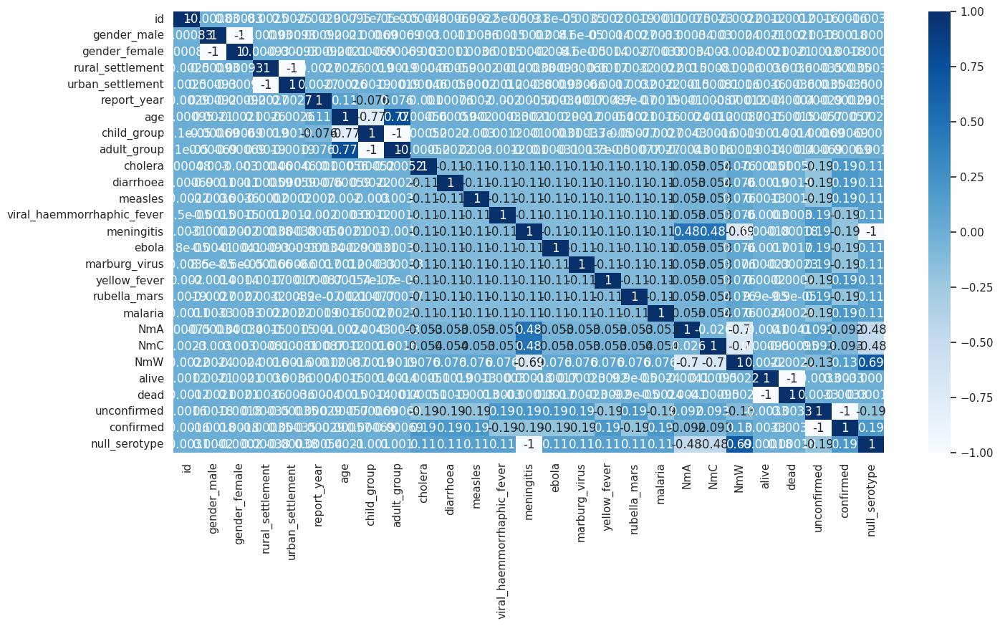

In [ ]:
# Heatmap showing correlation between the attributes.
sns.heatmap(
    pandas_df.corr(), annot=True, cmap="Blues"
)

A heatmap for correlation analysis is a graphical representation of the correlation matrix, which shows the correlation coefficients between variables in a dataset. It is a visual way to display the strength and direction of the linear relationship between pairs of variables.

In this heatmap, each cell's color represents the correlation coefficient between two variables. The color gradient typically ranges from cool colors (such as blue) indicating a high negative correlation, through white representing no correlation, to warm colors (such as red) indicating a high positive correlation.

Here we use Blues and as the color gets darker it means its strongly correlated.
The above heat map shows that:
Age and Child Group is highly correlated

NmW and Meningitis is highly correlated

# Q-Q PLOTS

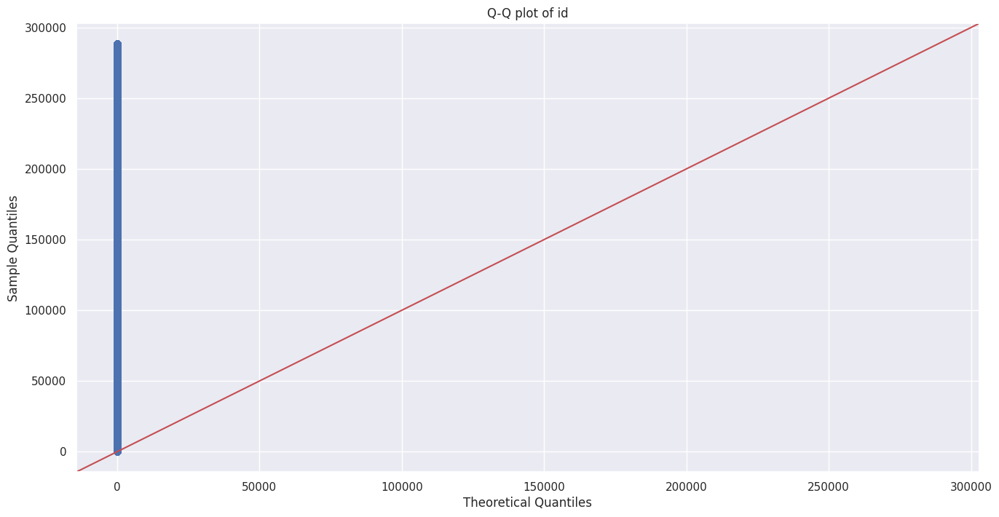

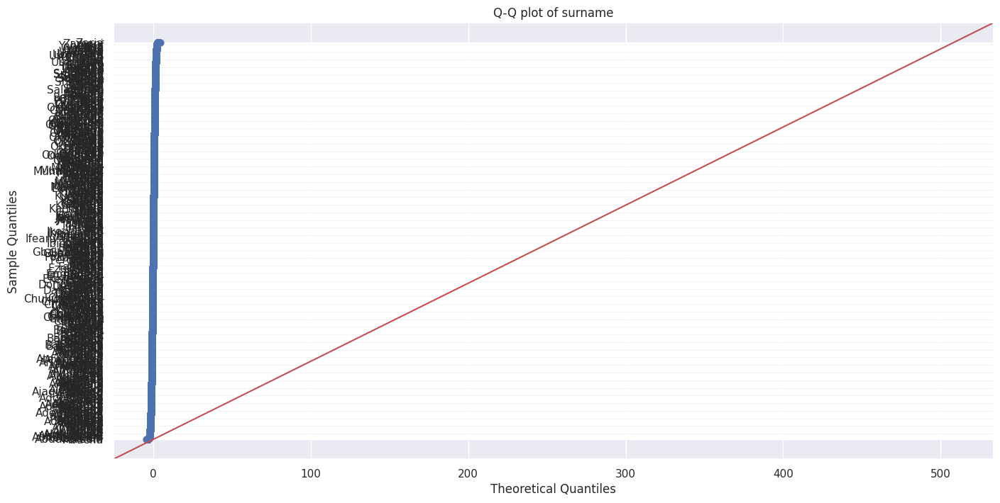

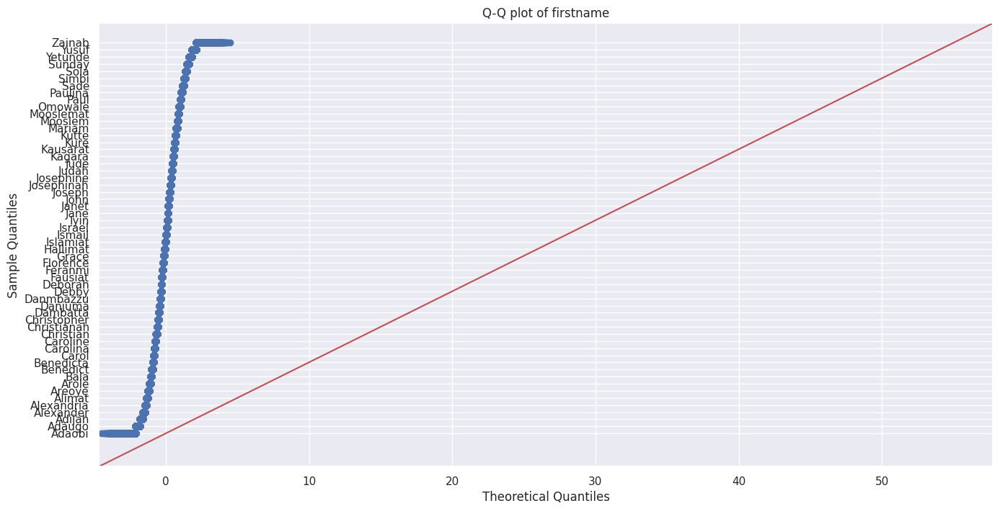

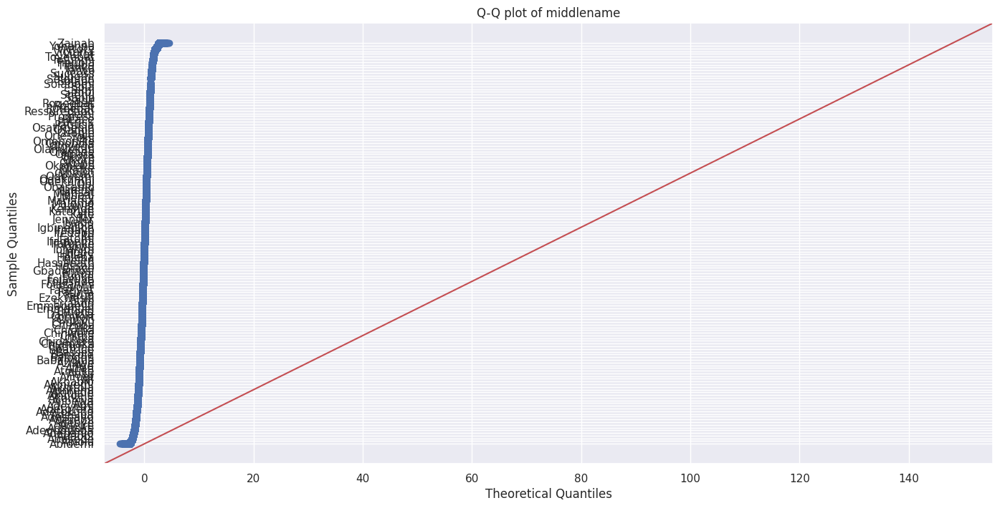

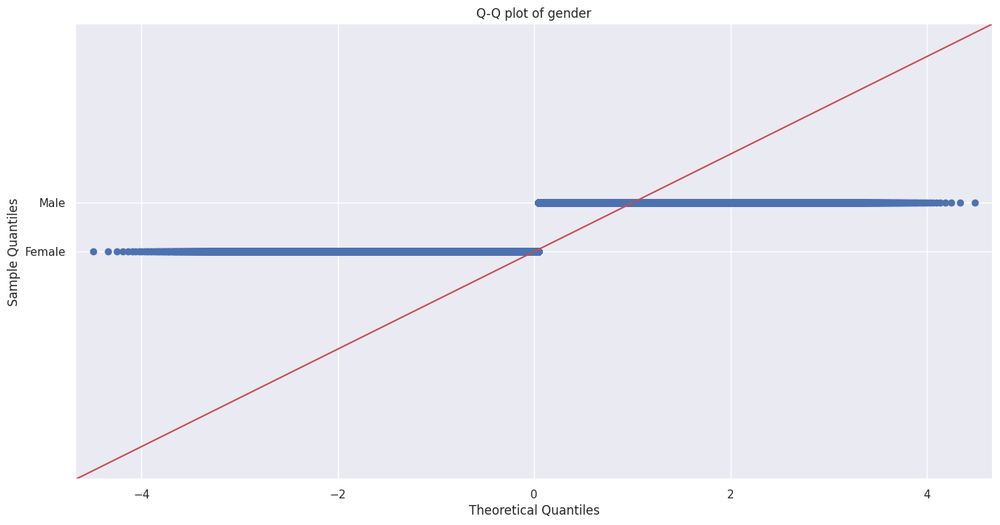

...

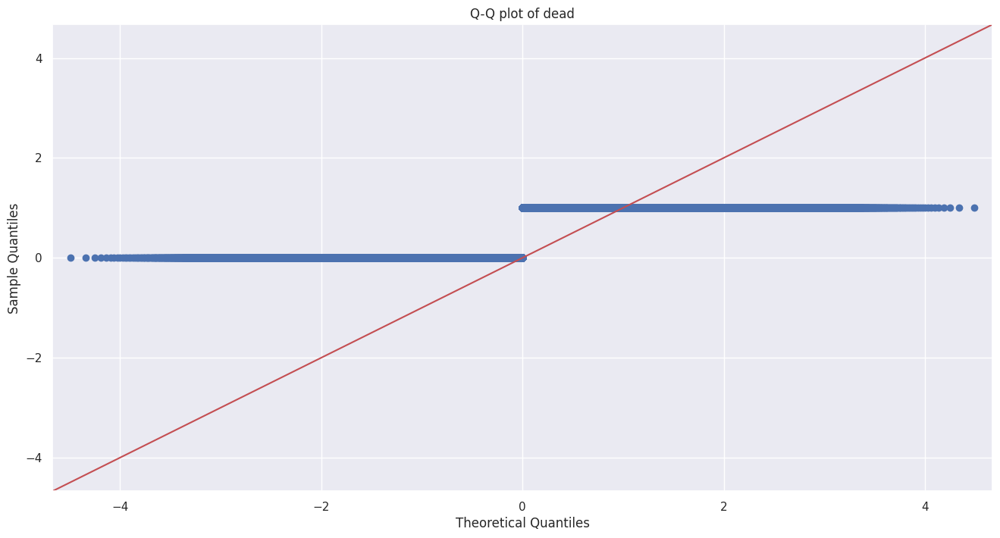

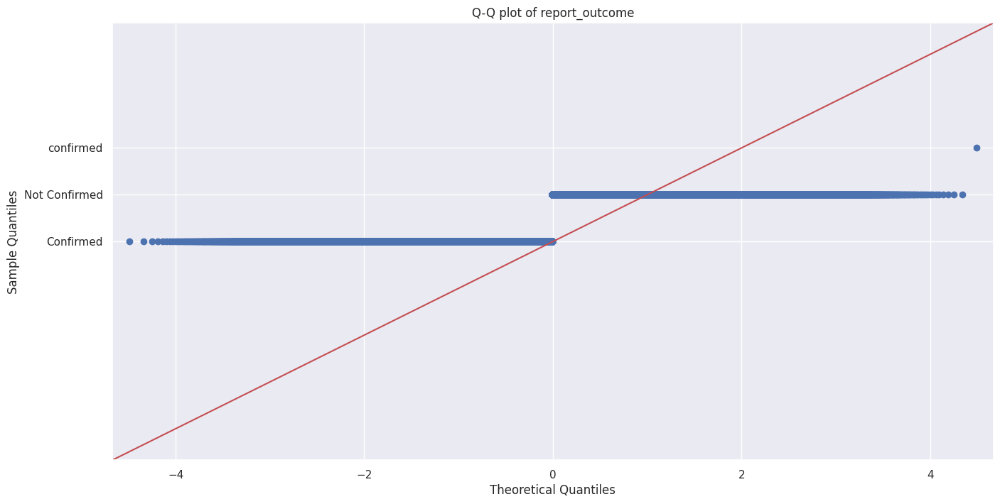

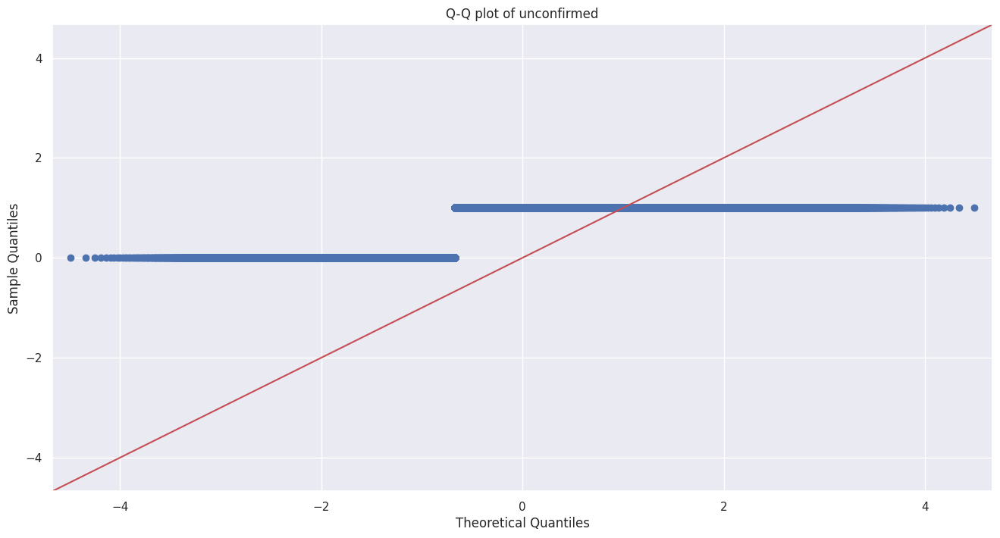

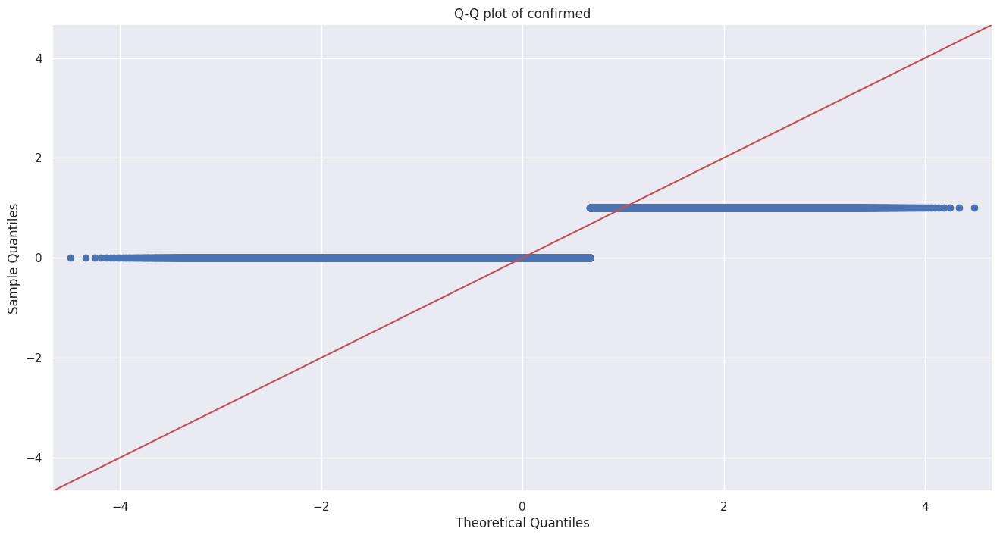

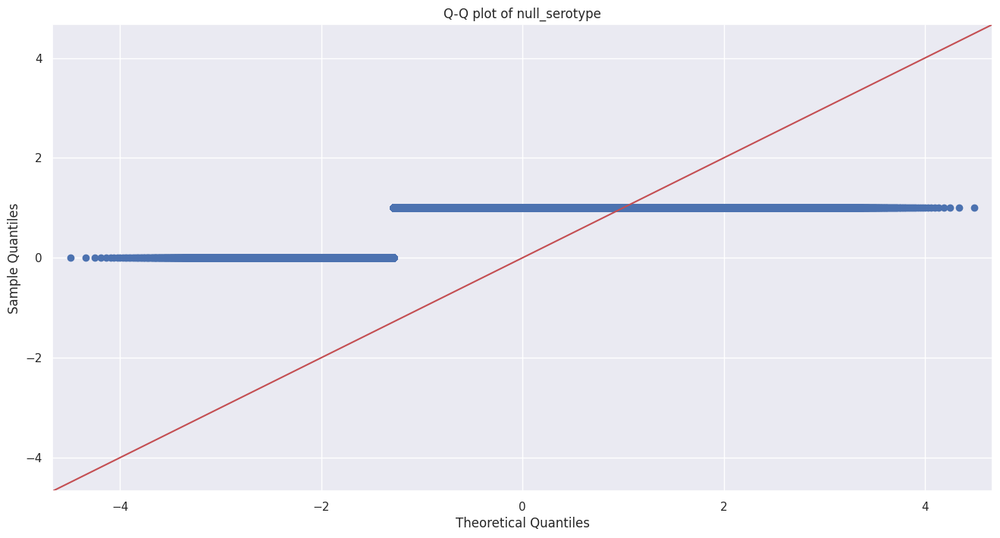

In [ ]:
import statsmodels.api as sm
for col in pandas_df.columns:
    sm.qqplot(pandas_df[col], line='45')
    plt.title('Q-Q plot of ' + col)
    plt.show()

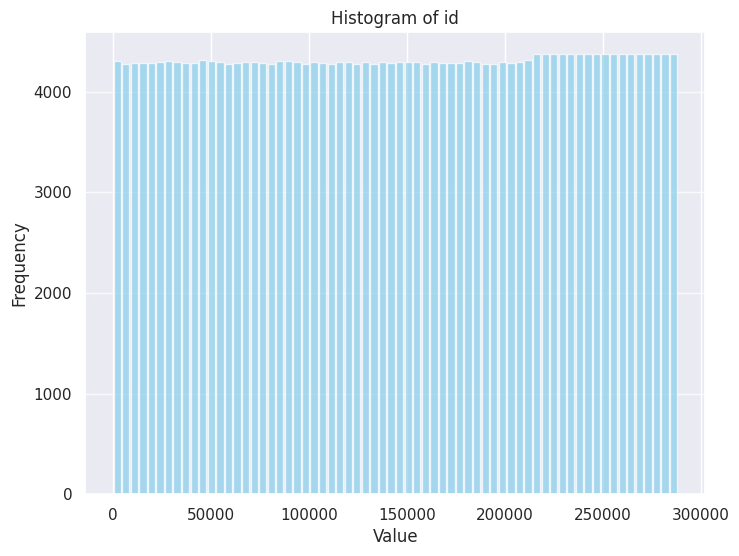

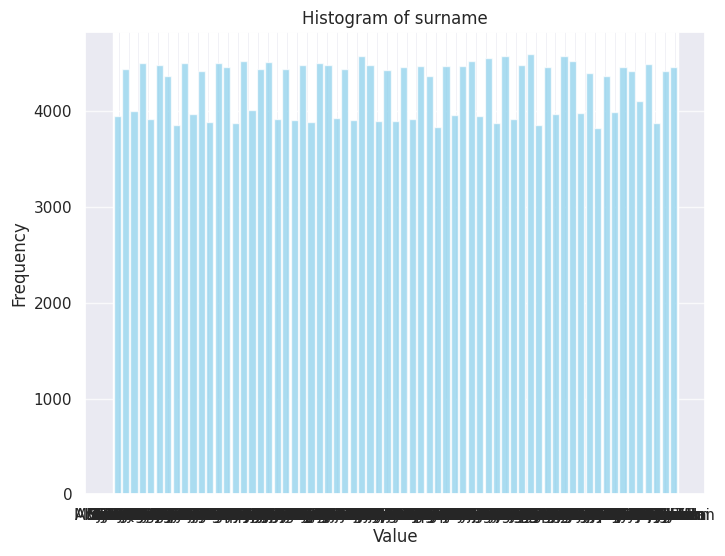

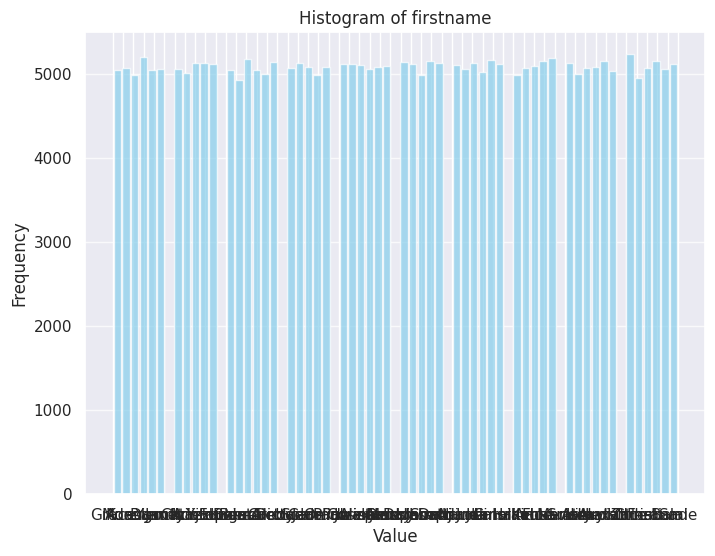

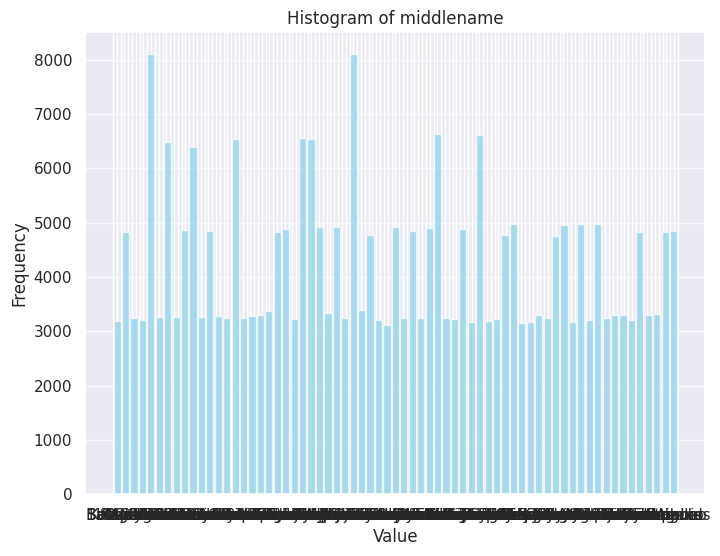

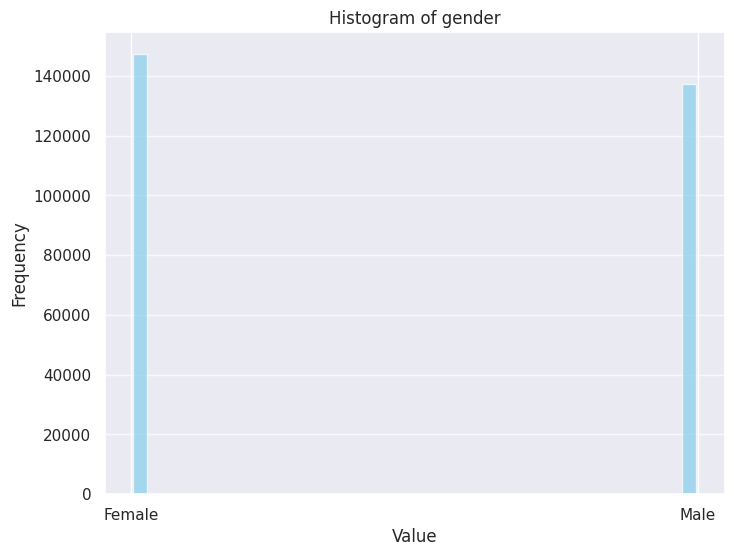

...

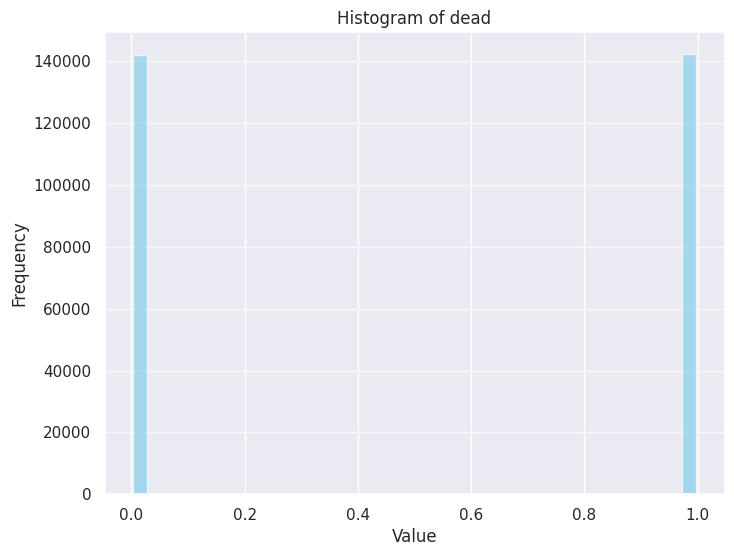

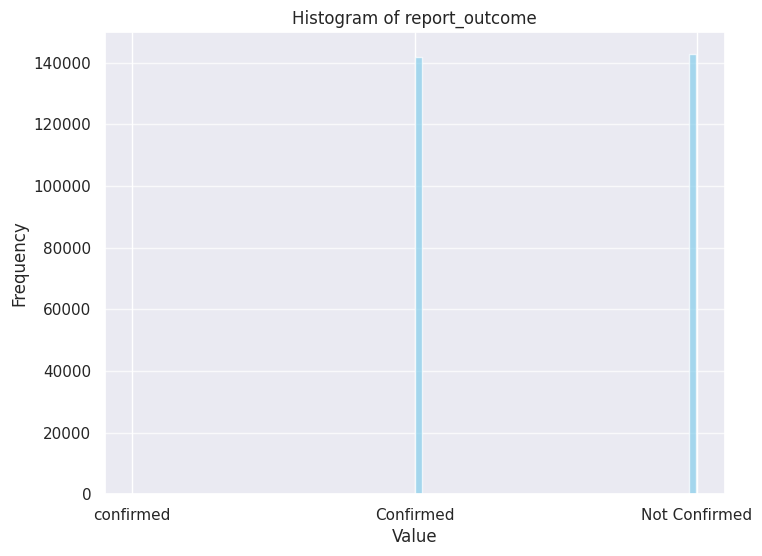

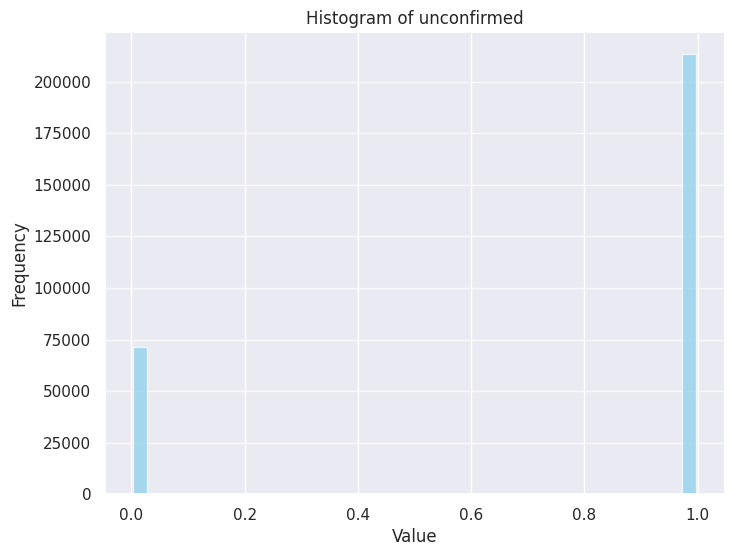

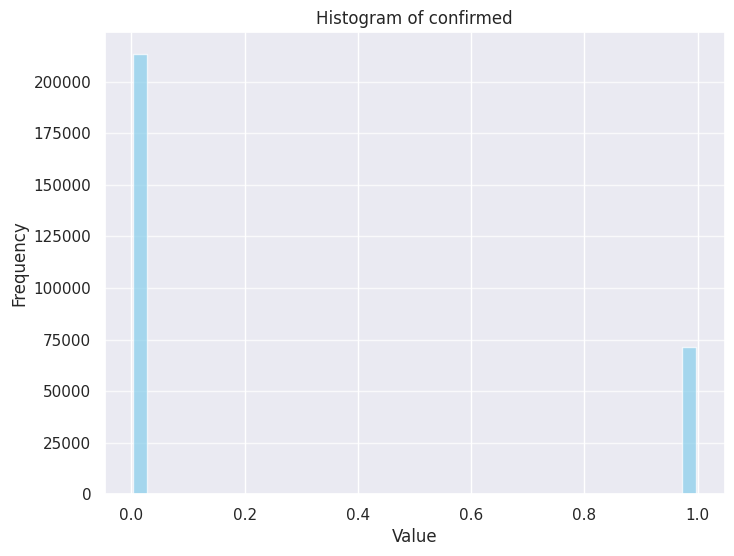

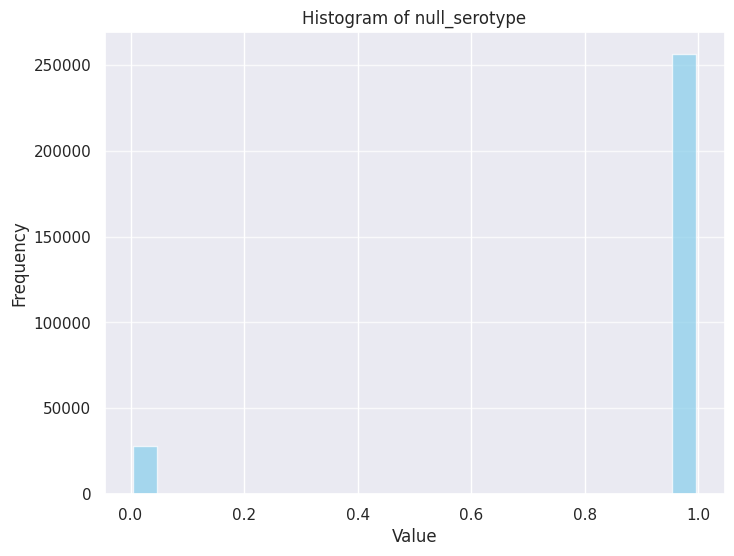

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming pandas_df is your pandas DataFrame
for col in pandas_df.columns:
    plt.figure(figsize=(8, 6))
    plt.hist(pandas_df[col], bins='auto', color='skyblue', alpha=0.7, rwidth=0.85)
    plt.grid(axis='y', alpha=0.75)
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.title('Histogram of ' + col)
    plt.show()


# H2O AutoML Execution

In [ ]:
df = h2o.H2OFrame(
    pandas_df
)  # Converted Pandas Dataframe to H2O dataframe to proceed with AutoML

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
df.head()

id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,urban_settlement,report_date,report_year,age,age_str,date_of_birth,child_group,adult_group,disease,cholera,diarrhoea,measles,viral_haemmorrhaphic_fever,meningitis,ebola,marburg_virus,yellow_fever,rubella_mars,malaria,serotype,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,0,2018-05-15 00:00:00,2018,32,32 years,1986-01-17 00:00:00,0,1,Cholera,1,0,0,0,0,0,0,0,0,0,null serotype,0,0,0,alive,1,0,confirmed,0,1,1
2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,0,2017-02-28 00:00:00,2017,32,32 years,1985-09-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,1,2012-03-02 00:00:00,2012,24,24 years,1988-05-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1
4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,0,2010-05-21 00:00:00,2010,63,63 years,1947-05-24 00:00:00,0,1,Measles,0,0,1,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,1,2017-08-28 00:00:00,2017,9,9 years,2008-01-07 00:00:00,1,0,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
6,Yakubu,Janet,Chioma,Female,0,1,Kaduna,Rural,1,0,2012-06-27 00:00:00,2012,44,44 years,1968-06-06 00:00:00,0,1,Ebola,0,0,0,0,0,1,0,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
7,Razak,Adaugo,Adaobi,Female,0,1,Taraba,Rural,1,0,2010-04-01 00:00:00,2010,61,61 years,1949-07-19 00:00:00,0,1,Yellow Fever,0,0,0,0,0,0,0,1,0,0,Null,0,0,1,Alive,1,0,Confirmed,0,1,1
8,Annakyi,Danmbazzu,Osagie,Male,1,0,Katsina,Rural,1,0,2015-10-04 00:00:00,2015,2,2 months,2014-12-18 00:00:00,1,0,Diarrhoea,0,1,0,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
9,Adejoro,Iyin,Osatimehin,Male,1,0,Katsina,Rural,1,0,2011-11-14 00:00:00,2011,54,54 years,1957-08-05 00:00:00,0,1,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
10,Okorie,Adaugo,Chika,Female,0,1,Osun,Urban,0,1,2014-06-17 00:00:00,2014,15,15 years,1999-10-19 00:00:00,1,0,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1


In [ ]:
df.types  # Datatype of all attributes, here the result ("age") is int hence it can be solved using the regression.
# If this problem was supposed to solved using the classification method - this attributes datatype must be converted into enum

{'id': 'int',
 'surname': 'enum',
 'firstname': 'enum',
 'middlename': 'enum',
 'gender': 'enum',
 'gender_male': 'int',
 'gender_female': 'int',
 'state': 'enum',
 'settlement': 'enum',
 'rural_settlement': 'int',
 'urban_settlement': 'int',
 'report_date': 'time',
 'report_year': 'int',
 'age': 'int',
 'age_str': 'enum',
 'date_of_birth': 'time',
 'child_group': 'int',
 'adult_group': 'int',
 'disease': 'enum',
 'cholera': 'int',
 'diarrhoea': 'int',
 'measles': 'int',
 'viral_haemmorrhaphic_fever': 'int',
 'meningitis': 'int',
 'ebola': 'int',
 'marburg_virus': 'int',
 'yellow_fever': 'int',
 'rubella_mars': 'int',
 'malaria': 'int',
 'serotype': 'enum',
 'NmA': 'int',
 'NmC': 'int',
 'NmW': 'int',
 'health_status': 'enum',
 'alive': 'int',
 'dead': 'int',
 'report_outcome': 'enum',
 'unconfirmed': 'int',
 'confirmed': 'int',
 'null_serotype': 'int'}

In [ ]:
pct_rows = 0.80  # Setting up the data split between training and test dataset.
df_train, df_test = df.split_frame([pct_rows])

In [ ]:
print(df_train.shape)
print(df_test.shape)

(227570, 40)
(56914, 40)


In [ ]:
df_train.head()

id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,urban_settlement,report_date,report_year,age,age_str,date_of_birth,child_group,adult_group,disease,cholera,diarrhoea,measles,viral_haemmorrhaphic_fever,meningitis,ebola,marburg_virus,yellow_fever,rubella_mars,malaria,serotype,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,0,2018-05-15 00:00:00,2018,32,32 years,1986-01-17 00:00:00,0,1,Cholera,1,0,0,0,0,0,0,0,0,0,null serotype,0,0,0,alive,1,0,confirmed,0,1,1
2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,0,2017-02-28 00:00:00,2017,32,32 years,1985-09-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,1,2012-03-02 00:00:00,2012,24,24 years,1988-05-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1
4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,0,2010-05-21 00:00:00,2010,63,63 years,1947-05-24 00:00:00,0,1,Measles,0,0,1,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,1,2017-08-28 00:00:00,2017,9,9 years,2008-01-07 00:00:00,1,0,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
6,Yakubu,Janet,Chioma,Female,0,1,Kaduna,Rural,1,0,2012-06-27 00:00:00,2012,44,44 years,1968-06-06 00:00:00,0,1,Ebola,0,0,0,0,0,1,0,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
7,Razak,Adaugo,Adaobi,Female,0,1,Taraba,Rural,1,0,2010-04-01 00:00:00,2010,61,61 years,1949-07-19 00:00:00,0,1,Yellow Fever,0,0,0,0,0,0,0,1,0,0,Null,0,0,1,Alive,1,0,Confirmed,0,1,1
8,Annakyi,Danmbazzu,Osagie,Male,1,0,Katsina,Rural,1,0,2015-10-04 00:00:00,2015,2,2 months,2014-12-18 00:00:00,1,0,Diarrhoea,0,1,0,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
9,Adejoro,Iyin,Osatimehin,Male,1,0,Katsina,Rural,1,0,2011-11-14 00:00:00,2011,54,54 years,1957-08-05 00:00:00,0,1,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
10,Okorie,Adaugo,Chika,Female,0,1,Osun,Urban,0,1,2014-06-17 00:00:00,2014,15,15 years,1999-10-19 00:00:00,1,0,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1


In [ ]:
X = df.columns
print(X)

['id', 'surname', 'firstname', 'middlename', 'gender', 'gender_male', 'gender_female', 'state', 'settlement', 'rural_settlement', 'urban_settlement', 'report_date', 'report_year', 'age', 'age_str', 'date_of_birth', 'child_group', 'adult_group', 'disease', 'cholera', 'diarrhoea', 'measles', 'viral_haemmorrhaphic_fever', 'meningitis', 'ebola', 'marburg_virus', 'yellow_fever', 'rubella_mars', 'malaria', 'serotype', 'NmA', 'NmC', 'NmW', 'health_status', 'alive', 'dead', 'report_outcome', 'unconfirmed', 'confirmed', 'null_serotype']


# Start to train in 10 models by AutoML

In [ ]:
# Set target and predictor variables
y = "age"
X.remove(y)  # Removing the result from our predictors data
print(X)

['id', 'surname', 'firstname', 'middlename', 'gender', 'gender_male', 'gender_female', 'state', 'settlement', 'rural_settlement', 'urban_settlement', 'report_date', 'report_year', 'age_str', 'date_of_birth', 'child_group', 'adult_group', 'disease', 'cholera', 'diarrhoea', 'measles', 'viral_haemmorrhaphic_fever', 'meningitis', 'ebola', 'marburg_virus', 'yellow_fever', 'rubella_mars', 'malaria', 'serotype', 'NmA', 'NmC', 'NmW', 'health_status', 'alive', 'dead', 'report_outcome', 'unconfirmed', 'confirmed', 'null_serotype']


Run AutoML. The max_runtime_secs argument provides a way to limit the AutoML run by time..

In [ ]:
aml = H2OAutoML(max_runtime_secs=run_time, seed=1)  # Setting of AutoML

In [ ]:
aml.train(x=X, y=y, training_frame=df_train)  # Trainig the dataset on different models. Pass the data through H20AutoML

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


,number_of_trees,number_of_internal_trees,model_size_in_bytes,min_depth,max_depth,mean_depth,min_leaves,max_leaves,mean_leaves
,154.0,154.0,5758602.0,12.0,15.0,14.811688,159.0,1012.0,906.487
,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance,validation_rmse,validation_mae,validation_deviance
,2023-11-03 03:19:26,0.010 sec,0.0,22.2044683,19.3465198,493.0384109,22.3682621,19.5501804,500.3391497
,2023-11-03 03:19:32,6.421 sec,5.0,13.1117562,11.4239847,171.9181503,13.2093506,11.5445817,174.4869434
,2023-11-03 03:19:36,10.506 sec,10.0,7.7524641,6.7528697,60.1006989,7.8157680,6.8276488,61.0862298
,2023-11-03 03:19:41,15.484 sec,15.0,4.5929165,3.9975364,21.0948818,4.6361325,4.0437325,21.4937244
,2023-11-03 03:19:45,19.366 sec,20.0,2.7275405,2.3686333,7.4394772,2.7605900,2.3982849,7.6208569
,2023-11-03 03:19:49,23.142 sec,25.0,1.6257034,1.4050052,2.6429117,1.6619085,1.4283741,2.7619399
,2023-11-03 03:19:52,26.266 sec,30.0,1.0554758,0.9086260,1.1140292,1.1144331,0.9452124,1.2419612
,2023-11-03 03:19:55,29.019 sec,35.0,0.6341916,0.5384005,0.4021990,0.7031616,0.5726802,0.4944362


Interpreting the above results

1. MAE: The mean absolute error (MAE) is the average absolute difference between the target values and the predicted values. This metric ranges from zero to infinity; a lower value indicates a higher quality model.

2. RMSE: The root-mean-square error metric is a frequently used measure of the differences between the values predicted by a model or an estimator and the values observed. This metric ranges from zero to infinity; a lower value indicates a higher quality model.

3. RMSLE: The root-mean-squared logarithmic error metric is similar to RMSE, except that it uses the natural logarithm of the predicted and actual values plus 1. RMSLE penalizes under-prediction more heavily than over-prediction. It can also be a good metric when you don't want to penalize differences for large prediction values more heavily than for small prediction values. This metric ranges from zero to infinity; a lower value indicates a higher quality model. The RMSLE evaluation metric is returned only if all label and predicted values are non-negative.

4. r^2: r squared (r^2) is the square of the Pearson correlation coefficient between the labels and predicted values. This metric ranges between zero and one; a higher value indicates a higher quality model.

5. MAPE: Mean absolute percentage error (MAPE) is the average absolute percentage difference between the labels and the predicted values. This metric ranges between zero and infinity; a lower value indicates a higher quality model.

6. K-fold cross-validation is used to validate a model internally, i.e., estimate the model performance without having to sacrifice a validation split.

Next, we will view the AutoML Leaderboard. Since we specified a leaderboard_frame in the h2o.automl() function for scoring and ranking the models, the AutoML leaderboard uses the performance on this data to rank the models.

A default performance metric for each machine learning task (binary classification, multiclass classification, regression) is specified internally and the leaderboard will be sorted by that metric. In the case of regression, the default ranking metric is mean residual deviance.

# H2O AutoML Execution

In [ ]:
df = h2o.H2OFrame(
    pandas_df
)  # Converted Pandas Dataframe to H2O dataframe to proceed with AutoML

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
df.head()

id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,urban_settlement,report_date,report_year,age,age_str,date_of_birth,child_group,adult_group,disease,cholera,diarrhoea,measles,viral_haemmorrhaphic_fever,meningitis,ebola,marburg_virus,yellow_fever,rubella_mars,malaria,serotype,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,0,2018-05-15 00:00:00,2018,32,32 years,1986-01-17 00:00:00,0,1,Cholera,1,0,0,0,0,0,0,0,0,0,null serotype,0,0,0,alive,1,0,confirmed,0,1,1
2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,0,2017-02-28 00:00:00,2017,32,32 years,1985-09-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,1,2012-03-02 00:00:00,2012,24,24 years,1988-05-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1
4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,0,2010-05-21 00:00:00,2010,63,63 years,1947-05-24 00:00:00,0,1,Measles,0,0,1,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,1,2017-08-28 00:00:00,2017,9,9 years,2008-01-07 00:00:00,1,0,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
6,Yakubu,Janet,Chioma,Female,0,1,Kaduna,Rural,1,0,2012-06-27 00:00:00,2012,44,44 years,1968-06-06 00:00:00,0,1,Ebola,0,0,0,0,0,1,0,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
7,Razak,Adaugo,Adaobi,Female,0,1,Taraba,Rural,1,0,2010-04-01 00:00:00,2010,61,61 years,1949-07-19 00:00:00,0,1,Yellow Fever,0,0,0,0,0,0,0,1,0,0,Null,0,0,1,Alive,1,0,Confirmed,0,1,1
8,Annakyi,Danmbazzu,Osagie,Male,1,0,Katsina,Rural,1,0,2015-10-04 00:00:00,2015,2,2 months,2014-12-18 00:00:00,1,0,Diarrhoea,0,1,0,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
9,Adejoro,Iyin,Osatimehin,Male,1,0,Katsina,Rural,1,0,2011-11-14 00:00:00,2011,54,54 years,1957-08-05 00:00:00,0,1,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
10,Okorie,Adaugo,Chika,Female,0,1,Osun,Urban,0,1,2014-06-17 00:00:00,2014,15,15 years,1999-10-19 00:00:00,1,0,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1


In [ ]:
df.types  # Datatype of all attributes, here the result ("age") is int hence it can be solved using the regression.
# If this problem was supposed to solved using the classification method - this attributes datatype must be converted into enum

{'id': 'int',
 'surname': 'enum',
 'firstname': 'enum',
 'middlename': 'enum',
 'gender': 'enum',
 'gender_male': 'int',
 'gender_female': 'int',
 'state': 'enum',
 'settlement': 'enum',
 'rural_settlement': 'int',
 'urban_settlement': 'int',
 'report_date': 'time',
 'report_year': 'int',
 'age': 'int',
 'age_str': 'enum',
 'date_of_birth': 'time',
 'child_group': 'int',
 'adult_group': 'int',
 'disease': 'enum',
 'cholera': 'int',
 'diarrhoea': 'int',
 'measles': 'int',
 'viral_haemmorrhaphic_fever': 'int',
 'meningitis': 'int',
 'ebola': 'int',
 'marburg_virus': 'int',
 'yellow_fever': 'int',
 'rubella_mars': 'int',
 'malaria': 'int',
 'serotype': 'enum',
 'NmA': 'int',
 'NmC': 'int',
 'NmW': 'int',
 'health_status': 'enum',
 'alive': 'int',
 'dead': 'int',
 'report_outcome': 'enum',
 'unconfirmed': 'int',
 'confirmed': 'int',
 'null_serotype': 'int'}

In [ ]:
pct_rows = 0.80  # Setting up the data split between training and test dataset.
df_train, df_test = df.split_frame([pct_rows])

In [ ]:
print(df_train.shape)
print(df_test.shape)

(227570, 40)
(56914, 40)


In [ ]:
df_train.head()

id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,urban_settlement,report_date,report_year,age,age_str,date_of_birth,child_group,adult_group,disease,cholera,diarrhoea,measles,viral_haemmorrhaphic_fever,meningitis,ebola,marburg_virus,yellow_fever,rubella_mars,malaria,serotype,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,0,2018-05-15 00:00:00,2018,32,32 years,1986-01-17 00:00:00,0,1,Cholera,1,0,0,0,0,0,0,0,0,0,null serotype,0,0,0,alive,1,0,confirmed,0,1,1
2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,0,2017-02-28 00:00:00,2017,32,32 years,1985-09-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,1,2012-03-02 00:00:00,2012,24,24 years,1988-05-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1
4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,0,2010-05-21 00:00:00,2010,63,63 years,1947-05-24 00:00:00,0,1,Measles,0,0,1,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,1,2017-08-28 00:00:00,2017,9,9 years,2008-01-07 00:00:00,1,0,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
6,Yakubu,Janet,Chioma,Female,0,1,Kaduna,Rural,1,0,2012-06-27 00:00:00,2012,44,44 years,1968-06-06 00:00:00,0,1,Ebola,0,0,0,0,0,1,0,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
7,Razak,Adaugo,Adaobi,Female,0,1,Taraba,Rural,1,0,2010-04-01 00:00:00,2010,61,61 years,1949-07-19 00:00:00,0,1,Yellow Fever,0,0,0,0,0,0,0,1,0,0,Null,0,0,1,Alive,1,0,Confirmed,0,1,1
8,Annakyi,Danmbazzu,Osagie,Male,1,0,Katsina,Rural,1,0,2015-10-04 00:00:00,2015,2,2 months,2014-12-18 00:00:00,1,0,Diarrhoea,0,1,0,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
9,Adejoro,Iyin,Osatimehin,Male,1,0,Katsina,Rural,1,0,2011-11-14 00:00:00,2011,54,54 years,1957-08-05 00:00:00,0,1,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
10,Okorie,Adaugo,Chika,Female,0,1,Osun,Urban,0,1,2014-06-17 00:00:00,2014,15,15 years,1999-10-19 00:00:00,1,0,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1


In [ ]:
X = df.columns
print(X)

['id', 'surname', 'firstname', 'middlename', 'gender', 'gender_male', 'gender_female', 'state', 'settlement', 'rural_settlement', 'urban_settlement', 'report_date', 'report_year', 'age', 'age_str', 'date_of_birth', 'child_group', 'adult_group', 'disease', 'cholera', 'diarrhoea', 'measles', 'viral_haemmorrhaphic_fever', 'meningitis', 'ebola', 'marburg_virus', 'yellow_fever', 'rubella_mars', 'malaria', 'serotype', 'NmA', 'NmC', 'NmW', 'health_status', 'alive', 'dead', 'report_outcome', 'unconfirmed', 'confirmed', 'null_serotype']


# Start to train in 10 models by AutoML

In [ ]:
# Set target and predictor variables
y = "age"
X.remove(y)  # Removing the result from our predictors data
print(X)

['id', 'surname', 'firstname', 'middlename', 'gender', 'gender_male', 'gender_female', 'state', 'settlement', 'rural_settlement', 'urban_settlement', 'report_date', 'report_year', 'age_str', 'date_of_birth', 'child_group', 'adult_group', 'disease', 'cholera', 'diarrhoea', 'measles', 'viral_haemmorrhaphic_fever', 'meningitis', 'ebola', 'marburg_virus', 'yellow_fever', 'rubella_mars', 'malaria', 'serotype', 'NmA', 'NmC', 'NmW', 'health_status', 'alive', 'dead', 'report_outcome', 'unconfirmed', 'confirmed', 'null_serotype']


Run AutoML. The max_runtime_secs argument provides a way to limit the AutoML run by time..

In [ ]:
aml = H2OAutoML(max_runtime_secs=run_time, seed=1)  # Setting of AutoML

In [ ]:
aml.train(x=X, y=y, training_frame=df_train)  # Trainig the dataset on different models. Pass the data through H20AutoML

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


,number_of_trees,number_of_internal_trees,model_size_in_bytes,min_depth,max_depth,mean_depth,min_leaves,max_leaves,mean_leaves
,154.0,154.0,5758602.0,12.0,15.0,14.811688,159.0,1012.0,906.487
,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance,validation_rmse,validation_mae,validation_deviance
,2023-11-03 03:19:26,0.010 sec,0.0,22.2044683,19.3465198,493.0384109,22.3682621,19.5501804,500.3391497
,2023-11-03 03:19:32,6.421 sec,5.0,13.1117562,11.4239847,171.9181503,13.2093506,11.5445817,174.4869434
,2023-11-03 03:19:36,10.506 sec,10.0,7.7524641,6.7528697,60.1006989,7.8157680,6.8276488,61.0862298
,2023-11-03 03:19:41,15.484 sec,15.0,4.5929165,3.9975364,21.0948818,4.6361325,4.0437325,21.4937244
,2023-11-03 03:19:45,19.366 sec,20.0,2.7275405,2.3686333,7.4394772,2.7605900,2.3982849,7.6208569
,2023-11-03 03:19:49,23.142 sec,25.0,1.6257034,1.4050052,2.6429117,1.6619085,1.4283741,2.7619399
,2023-11-03 03:19:52,26.266 sec,30.0,1.0554758,0.9086260,1.1140292,1.1144331,0.9452124,1.2419612
,2023-11-03 03:19:55,29.019 sec,35.0,0.6341916,0.5384005,0.4021990,0.7031616,0.5726802,0.4944362


Interpreting the above results

1. MAE: The mean absolute error (MAE) is the average absolute difference between the target values and the predicted values. This metric ranges from zero to infinity; a lower value indicates a higher quality model.

2. RMSE: The root-mean-square error metric is a frequently used measure of the differences between the values predicted by a model or an estimator and the values observed. This metric ranges from zero to infinity; a lower value indicates a higher quality model.

3. RMSLE: The root-mean-squared logarithmic error metric is similar to RMSE, except that it uses the natural logarithm of the predicted and actual values plus 1. RMSLE penalizes under-prediction more heavily than over-prediction. It can also be a good metric when you don't want to penalize differences for large prediction values more heavily than for small prediction values. This metric ranges from zero to infinity; a lower value indicates a higher quality model. The RMSLE evaluation metric is returned only if all label and predicted values are non-negative.

4. r^2: r squared (r^2) is the square of the Pearson correlation coefficient between the labels and predicted values. This metric ranges between zero and one; a higher value indicates a higher quality model.

5. MAPE: Mean absolute percentage error (MAPE) is the average absolute percentage difference between the labels and the predicted values. This metric ranges between zero and infinity; a lower value indicates a higher quality model.

6. K-fold cross-validation is used to validate a model internally, i.e., estimate the model performance without having to sacrifice a validation split.

Next, we will view the AutoML Leaderboard. Since we specified a leaderboard_frame in the h2o.automl() function for scoring and ranking the models, the AutoML leaderboard uses the performance on this data to rank the models.

A default performance metric for each machine learning task (binary classification, multiclass classification, regression) is specified internally and the leaderboard will be sorted by that metric. In the case of regression, the default ranking metric is mean residual deviance.

In [ ]:
# View the AutoML Leaderboard
print(
    aml.leaderboard
)

# Leaderboard showing the performance of different models on the dataset.

model_id                                                    rmse        mse        mae        rmsle    mean_residual_deviance
GBM_1_AutoML_1_20231103_31810                           0.189618  0.035955   0.0901545    0.0184534                 0.035955
StackedEnsemble_AllModels_1_AutoML_1_20231103_31810     0.191594  0.0367081  0.0730712    0.0154664                 0.0367081
StackedEnsemble_BestOfFamily_1_AutoML_1_20231103_31810  0.197213  0.0388931  0.0675959    0.0158767                 0.0388931
StackedEnsemble_BestOfFamily_2_AutoML_1_20231103_31810  0.197253  0.0389088  0.0676858    0.0158831                 0.0389088
XGBoost_1_AutoML_1_20231103_31810                       0.323165  0.104436   0.0627127    0.0223537                 0.104436
XGBoost_2_AutoML_1_20231103_31810                       0.87364   0.763247   0.227006     0.0467033                 0.763247
GBM_2_AutoML_1_20231103_31810                           1.21033   1.46489    1.04423      0.149964                  1.464

# Interpreting the leaderboard:

The models listed in the leaderboard are ranked based on their rmse score, where a lower score indicates better performance. The top row in the leaderboard represents the best-performing model with the lowest rmse score. The evaluation metrics can be used to compare the performance of different models and help in selecting the best model for the particular use case.

In this leaderboard, the best performing model is

StackedEnsemble_AllModels_1_AutoML_1_20231103_10716 with an rmse score of 0.137187

The second-best model is StackedEnsemble_BestOfFamily_1_AutoML_1_20231103_10716 with an rmse score of 0.137792

The models are then listed in descending order based on their rmse scores.

In [ ]:
model_index = 0
glm_index = 0
glm_model = ""
aml_leaderboard_df = aml.leaderboard.as_data_frame()
models_dict = {}
for m in aml_leaderboard_df["model_id"]:
    models_dict[m] = model_index
    if "StackedEnsemble" not in m:
        break
    model_index = model_index + 1

for m in aml_leaderboard_df["model_id"]:
    if "GLM" in m:
        models_dict[m] = glm_index
        break
    glm_index = glm_index + 1
models_dict

{'GBM_1_AutoML_1_20231103_31810': 0, 'GLM_1_AutoML_1_20231103_31810': 7}

In [ ]:
print(model_index)
best_model = h2o.get_model(aml.leaderboard[model_index, "model_id"])

0


In [ ]:
best_model.algo

'gbm'

In [ ]:
best_model = aml.leader
best_model.model_performance(df_train)

ModelMetricsRegression: gbm
** Reported on test data. **

MSE: 0.010471732629299374
RMSE: 0.10233148405695763
MAE: 0.034139742570736015
RMSLE: 0.01062722412470637
Mean Residual Deviance: 0.010471732629299374

The output we received represents the model performance metrics for a stacked ensemble model.

The lower the values of rmse the better the model is.

In [ ]:
import matplotlib.pyplot as plt

%matplotlib inline

import warnings
import matplotlib.cbook

warnings.filterwarnings("ignore", category=matplotlib.cbook.mplDeprecation)

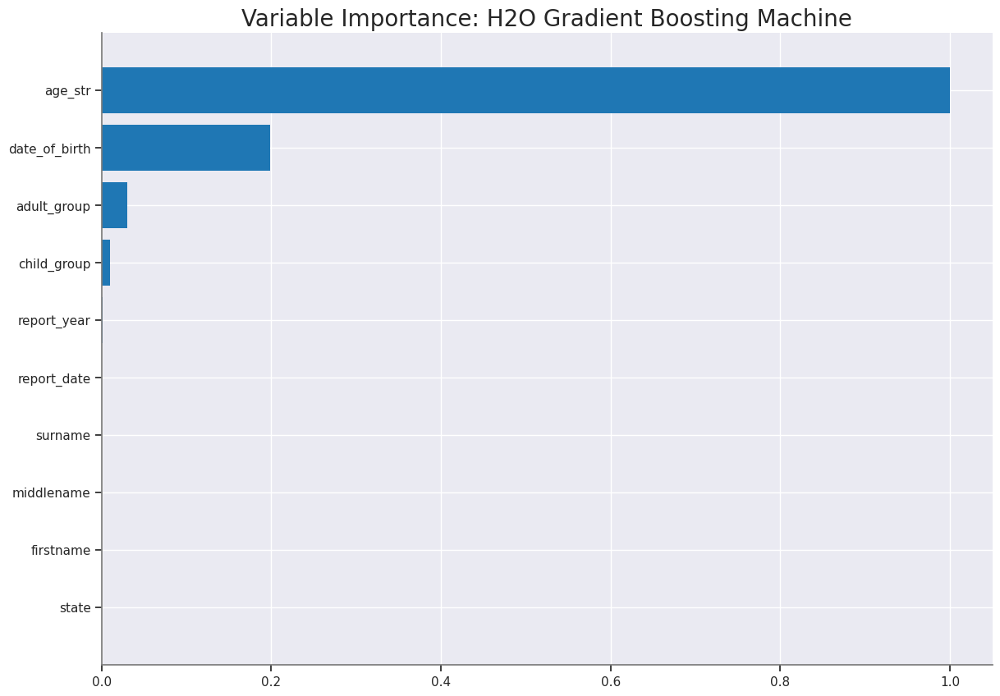

<Figure size 1600x800 with 0 Axes>

In [ ]:
if best_model.algo in [
    "gbm",
    "glm",
    "xrt",
    "xgboost",
]:  # Importance of all the variables in GBM algorithm.
    best_model.varimp_plot()

7
glm


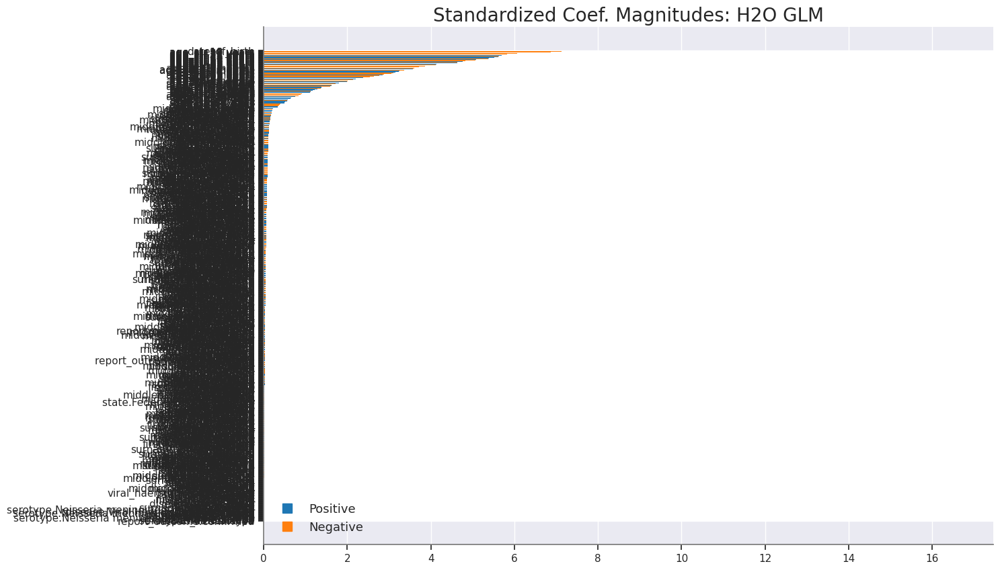

In [ ]:
if glm_index is not 0:
    print(glm_index)
    glm_model = h2o.get_model(aml.leaderboard[glm_index, "model_id"])
    print(glm_model.algo)
    glm_model.std_coef_plot()

In [ ]:
print(best_model.rmse(train=True))

0.034927256057442985


In [ ]:
def model_performance_stats(perf):
    d = {}
    try:
        d["mse"] = perf.mse()
    except:
        pass
    try:
        d["rmse"] = perf.rmse()
    except:
        pass
    try:
        d["null_degrees_of_freedom"] = perf.null_degrees_of_freedom()
    except:
        pass
    try:
        d["residual_degrees_of_freedom"] = perf.residual_degrees_of_freedom()
    except:
        pass
    try:
        d["residual_deviance"] = perf.residual_deviance()
    except:
        pass
    try:
        d["null_deviance"] = perf.null_deviance()
    except:
        pass
    try:
        d["aic"] = perf.aic()
    except:
        pass
    try:
        d["logloss"] = perf.logloss()
    except:
        pass
    try:
        d["auc"] = perf.auc()
    except:
        pass
    try:
        d["gini"] = perf.gini()
    except:
        pass
    return d

In [ ]:
mod_perf = best_model.model_performance(df_test)
stats_test = {}
stats_test = model_performance_stats(mod_perf)
stats_test

{'mse': 0.033451217205818964,
 'rmse': 0.1828967391885896,
 'null_degrees_of_freedom': None,
 'residual_degrees_of_freedom': None,
 'residual_deviance': None,
 'null_deviance': None}

In [ ]:
predictions = best_model.predict(df_test)

gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%


In [ ]:
y_pred = h2o.as_list(
    predictions
)  # Predictions on Test Dataset using the best model from the leaderboard.
print(y_pred)


         predict
0      32.007797
1      63.157622
2      14.953664
3      48.061954
4      29.958595
...          ...
56909  26.041321
56910  20.045518
56911  43.736024
56912  68.022041
56913  33.029622

[56914 rows x 1 columns]


In [ ]:
print(X)

['id', 'surname', 'firstname', 'middlename', 'gender', 'gender_male', 'gender_female', 'state', 'settlement', 'rural_settlement', 'urban_settlement', 'report_date', 'report_year', 'age_str', 'date_of_birth', 'child_group', 'adult_group', 'disease', 'cholera', 'diarrhoea', 'measles', 'viral_haemmorrhaphic_fever', 'meningitis', 'ebola', 'marburg_virus', 'yellow_fever', 'rubella_mars', 'malaria', 'serotype', 'NmA', 'NmC', 'NmW', 'health_status', 'alive', 'dead', 'report_outcome', 'unconfirmed', 'confirmed', 'null_serotype']


# Analysing relation between all variables

When all independent variables were plotted against 'age' variable it is observed that for'Disease' and 'State' roughly a linear line is obtained. So it can be concluded from this plot that variables Disease and State have linear relation with Price.

VIF stands for Variance Inflation Factor.It signifies multicollinearity among set of different independent variable. A value greater than 10 means that the independent variable is highly correlated with some other variable. Will calculate VIF value for all variables to check the dependency and then will drop the variables with high VIF value.

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# the independent variables set
vif_X = pandas_df[['gender_male', 'gender_female', 'rural_settlement', 'urban_settlement', 'report_year', 'age' , 'child_group', 'adult_group','cholera'	,'diarrhoea',	'measles',	'viral_haemmorrhaphic_fever',	'meningitis',	'ebola',	'marburg_virus',	'yellow_fever',	'rubella_mars',	'NmA',	'NmC',	'NmW',	'alive',	'dead',	'unconfirmed',	'confirmed'	, 'null_serotype']]

# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns

# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X.values, i)
                          for i in range(len(X.columns))]

print(vif_data)

                       feature           VIF
0                  gender_male           inf
1                gender_female           inf
2             rural_settlement           inf
3             urban_settlement           inf
4                  report_year  1.012190e+00
5                          age  2.506080e+00
6                  child_group           inf
7                  adult_group           inf
8                      cholera  1.800795e+00
9                    diarrhoea  1.799818e+00
10                     measles  1.797866e+00
11  viral_haemmorrhaphic_fever  1.976339e+00
12                  meningitis           inf
13                       ebola  1.969595e+00
14               marburg_virus  1.977198e+00
15                yellow_fever  1.796813e+00
16                rubella_mars  1.980520e+00
17                         NmA  6.865800e+03
18                         NmC  6.953227e+03
19                         NmW  1.346419e+04
20                       alive           inf
21        

Considering the significance value of 0.05 because accuracy in predicting the age of the abalone is not that critical

Except PM2.5 has the p-value 0.646, which is greater and hence it is a non significant feature, all other features are significant.

VIF for 'alive','dead','unconfirmed','confirmed' and 'meningitis' and many more parameters is inf.

Now, will drop the variables unconfirmed, confirmed and YearBuilt.

Ordinary least squares (OLS) regression is a statistical method of analysis used for multivariate model that estimates the relationship between one or more independent variables and a dependent variable; the method estimates the relationship by minimizing the sum of the squares in the difference between the observed and predicted values of the dependent variable.

In [ ]:
#print the index value of best model
print(model_index)
best_model = h2o.get_model(aml.leaderboard[0,'model_id'])

0


In [ ]:
best_model.algo

'gbm'

In [ ]:
model_index = 0
glm_index = 0
glm_model = ""
aml_leaderboard_df = aml.leaderboard.as_data_frame()
models_dict = {}
for m in aml_leaderboard_df["model_id"]:
    models_dict[m] = model_index
    if "StackedEnsemble" not in m:
        break
    model_index = model_index + 1

for m in aml_leaderboard_df["model_id"]:
    if "GLM" in m:
        models_dict[m] = glm_index
        break
    glm_index = glm_index + 1
models_dict

{'GBM_1_AutoML_1_20231103_13911': 0, 'GLM_1_AutoML_1_20231103_13911': 7}

In [ ]:
print(model_index)
best_model = h2o.get_model(aml.leaderboard[model_index, "model_id"])
best_model.algo

0


'gbm'

In [ ]:
import matplotlib.pyplot as plt

%matplotlib inline

import warnings
import matplotlib.cbook

warnings.filterwarnings("ignore", category=matplotlib.cbook.mplDeprecation)

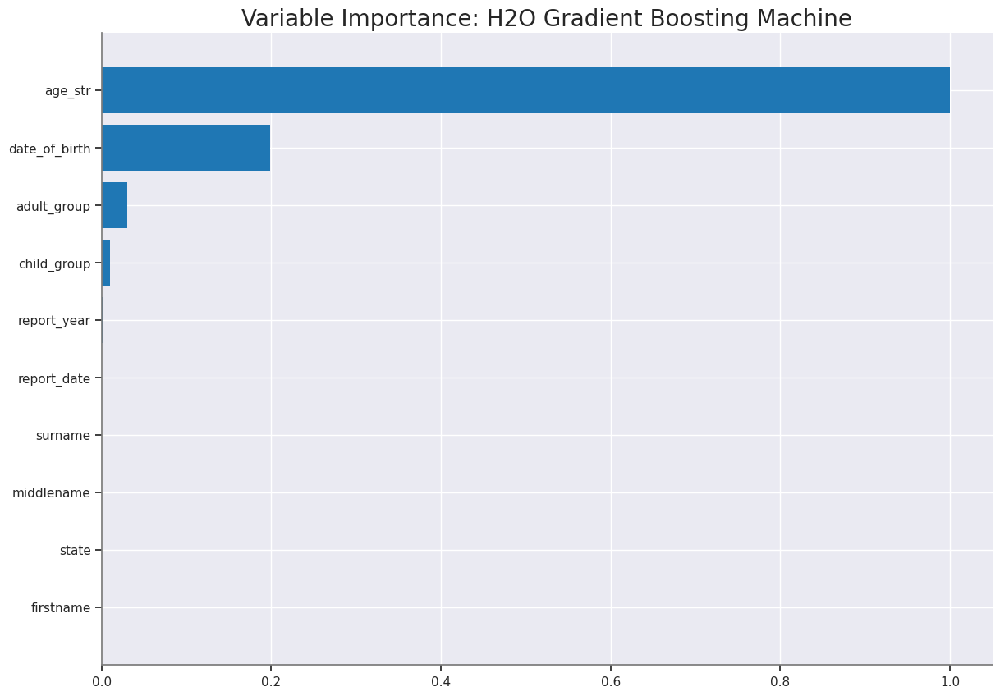

<Figure size 1600x800 with 0 Axes>

In [ ]:
if best_model.algo in [
    "gbm",
    "glm",
    "xrt",
    "xgboost",
]:  # Importance of all the variables in GBM algorithm.
    best_model.varimp_plot()

7
glm


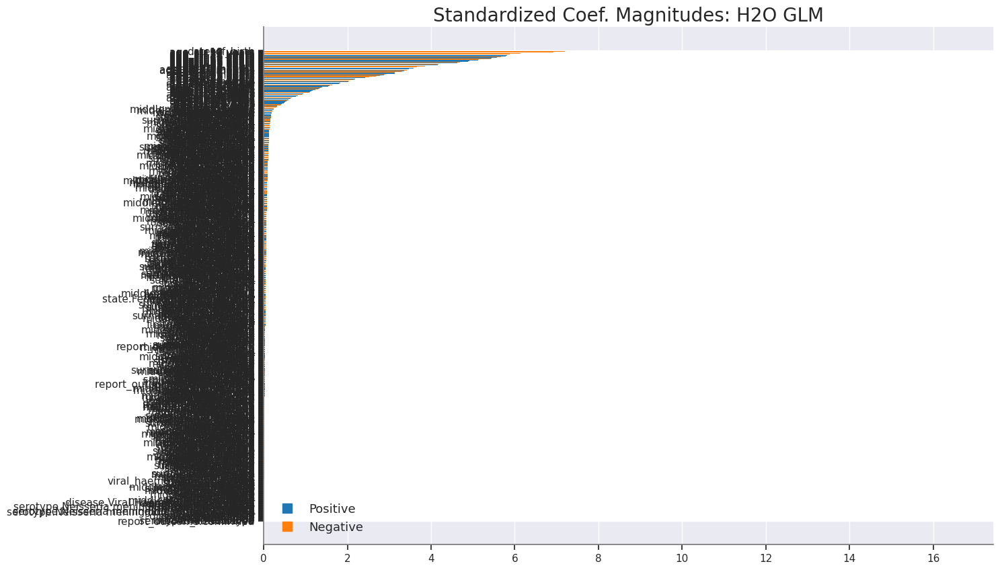

In [ ]:
if glm_index is not 0:
    print(glm_index)
    glm_model = h2o.get_model(aml.leaderboard[glm_index, "model_id"])
    print(glm_model.algo)
    glm_model.std_coef_plot()

In [ ]:
print(best_model.rmse(train=True))

0.03339138307392818


In [ ]:
def model_performance_stats(perf):
    d = {}
    try:
        d["mse"] = perf.mse()
    except:
        pass
    try:
        d["rmse"] = perf.rmse()
    except:
        pass
    try:
        d["null_degrees_of_freedom"] = perf.null_degrees_of_freedom()
    except:
        pass
    try:
        d["residual_degrees_of_freedom"] = perf.residual_degrees_of_freedom()
    except:
        pass
    try:
        d["residual_deviance"] = perf.residual_deviance()
    except:
        pass
    try:
        d["null_deviance"] = perf.null_deviance()
    except:
        pass
    try:
        d["aic"] = perf.aic()
    except:
        pass
    try:
        d["logloss"] = perf.logloss()
    except:
        pass
    try:
        d["auc"] = perf.auc()
    except:
        pass
    try:
        d["gini"] = perf.gini()
    except:
        pass
    return d

In [ ]:
mod_perf = best_model.model_performance(df_test)
stats_test = {}
stats_test = model_performance_stats(mod_perf)
stats_test

{'mse': 0.03309981405997084,
 'rmse': 0.1819335429764694,
 'null_degrees_of_freedom': None,
 'residual_degrees_of_freedom': None,
 'residual_deviance': None,
 'null_deviance': None}

In [ ]:
predictions = best_model.predict(df_test)

gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%


In [ ]:
y_pred = h2o.as_list(
    predictions
)  # Predictions on Test Dataset using the best model from the leaderboard.
print(y_pred)

         predict
0       3.035510
1      58.903686
2      59.282689
3       6.917159
4       2.179103
...          ...
56845  60.033633
56846  10.008381
56847  10.998470
56848  43.173594
56849  64.003386

[56850 rows x 1 columns]


In [ ]:
y_test = h2o.as_list(df_test[y])  # Real Answers
y_test

,age
0,3
1,59
2,59
3,7
4,2
...,...
56845,60
56846,10
56847,11
56848,43


In [ ]:
print(X)

['gender_male', 'gender_female', 'rural_settlement', 'urban_settlement', 'report_year', 'age', 'child_group', 'adult_group', 'cholera', 'diarrhoea', 'measles', 'meningitis', 'yellow_fever', 'rubella_mars', 'NmA', 'NmC', 'NmW', 'alive', 'dead', 'unconfirmed', 'confirmed', 'null_serotype']


# Regularization

In this Section, we will be using the GLM model to check if regularization is helping us to improve the accuracy and reduce overfitting.

Ridge and Lasso are regularization techniques used in linear regression to prevent overfitting and improve the model's generalization ability.

Ridge regularization adds a penalty term to the least-squares objective function of the linear regression model. This penalty term is proportional to the square of the magnitude of the coefficients of the model, which shrinks the coefficients towards zero. The strength of the penalty is controlled by a hyperparameter called the regularization parameter, which needs to be tuned to achieve the best performance. Ridge regularization is particularly useful when there are many input variables that are correlated with each other, as it can help to reduce the variance of the model by reducing the effect of these correlated variables.

Lasso regularization is similar to Ridge regularization, but instead of adding a penalty term proportional to the square of the coefficients, it adds a penalty term proportional to the absolute value of the coefficients. This penalty term can set some coefficients to exactly zero, which makes Lasso regularization a useful method for feature selection. By setting some coefficients to zero, Lasso can effectively remove irrelevant variables from the model, which can lead to a simpler and more interpretable model.

The main difference between Ridge and Lasso regularization is the type of penalty function used. Ridge uses L2 regularization, while Lasso uses L1 regularization. L2 regularization tends to distribute the penalty evenly across all coefficients, while L1 regularization tends to concentrate the penalty on a smaller subset of the most important coefficients. Which method to use depends on the specific problem and the properties of the input variables.

In [ ]:
# Create an H2OGeneralizedLinearEstimator with L0 (Ridge) regularization
disease_glm = H2OGeneralizedLinearEstimator(
    family="gaussian",
    alpha=0,  # Adjust the alpha value for L1 regularization
    nfolds=5,
)

# Train the model
disease_glm.train(x=X,y=y,training_frame=df_train)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


,family,link,regularization,number_of_predictors_total,number_of_active_predictors,number_of_iterations,training_frame
,gaussian,identity,Ridge ( lambda = 0.02159 ),923,923,1,py_71_sid_8d5f
,mean,sd,cv_1_valid,cv_2_valid,cv_3_valid,cv_4_valid,cv_5_valid
mae,1.9570172,0.0126763,1.9699751,1.968426,1.9406003,1.9483749,1.9577098
mean_residual_deviance,12.243408,0.4014020,12.83712,12.356017,11.748751,12.059368,12.215784
mse,12.243408,0.4014020,12.83712,12.356017,11.748751,12.059368,12.215784
null_deviance,22517972.0000000,119952.8750000,22501148.0000000,22592684.0000000,22343154.0000000,22660972.0000000,22491896.0000000
r2,0.9752536,0.0007747,0.97413,0.9750622,0.9761998,0.9757007,0.9751756
residual_deviance,557246.8,18370.041,582099.25,563397.3,531760.2,550642.8,558334.6
rmse,3.498684,0.0572223,3.5828927,3.5151126,3.427645,3.47266,3.4951086
rmsle,nan,0.0,nan,nan,nan,nan,nan


In [ ]:
df_train.head()

id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,urban_settlement,report_date,report_year,age,age_str,date_of_birth,child_group,adult_group,disease,cholera,diarrhoea,measles,viral_haemmorrhaphic_fever,meningitis,ebola,marburg_virus,yellow_fever,rubella_mars,malaria,serotype,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,0,2018-05-15 00:00:00,2018,32,32 years,1986-01-17 00:00:00,0,1,Cholera,1,0,0,0,0,0,0,0,0,0,null serotype,0,0,0,alive,1,0,confirmed,0,1,1
2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,0,2017-02-28 00:00:00,2017,32,32 years,1985-09-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,1,2012-03-02 00:00:00,2012,24,24 years,1988-05-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1
4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,0,2010-05-21 00:00:00,2010,63,63 years,1947-05-24 00:00:00,0,1,Measles,0,0,1,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,1,2017-08-28 00:00:00,2017,9,9 years,2008-01-07 00:00:00,1,0,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
6,Yakubu,Janet,Chioma,Female,0,1,Kaduna,Rural,1,0,2012-06-27 00:00:00,2012,44,44 years,1968-06-06 00:00:00,0,1,Ebola,0,0,0,0,0,1,0,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
7,Razak,Adaugo,Adaobi,Female,0,1,Taraba,Rural,1,0,2010-04-01 00:00:00,2010,61,61 years,1949-07-19 00:00:00,0,1,Yellow Fever,0,0,0,0,0,0,0,1,0,0,Null,0,0,1,Alive,1,0,Confirmed,0,1,1
8,Annakyi,Danmbazzu,Osagie,Male,1,0,Katsina,Rural,1,0,2015-10-04 00:00:00,2015,2,2 months,2014-12-18 00:00:00,1,0,Diarrhoea,0,1,0,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
9,Adejoro,Iyin,Osatimehin,Male,1,0,Katsina,Rural,1,0,2011-11-14 00:00:00,2011,54,54 years,1957-08-05 00:00:00,0,1,Rubella Mars,0,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
10,Okorie,Adaugo,Chika,Female,0,1,Osun,Urban,0,1,2014-06-17 00:00:00,2014,15,15 years,1999-10-19 00:00:00,1,0,Marburg Virus,0,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1


This code is creating two generalized linear regression models using the H2O machine learning platform with different regularization methods: Ridge and Lasso.

The first model, "disease_glm_regularization_ridge," is using Ridge regularization. The "family" argument is set to "gaussian," which means that the response variable is continuous and the model is using a normal (Gaussian) error distribution. The "alpha" argument is set to 0, which means that the model is using Ridge regularization. The "nfolds" argument is set to 5, which means that the model is using 5-fold cross-validation to evaluate the performance of the model.

The second model, "disease_glm_regularization_lasso," is using Lasso regularization. The "family" and "nfolds" arguments are the same as in the Ridge model, but the "alpha" argument is set to 1, which means that the model is using Lasso regularization.

This code creates a generalized linear regression model using H2O with the option of performing lambda search for L1 and L2 regularization.

# Lasso Regularization

In [ ]:
# Create an H2OGeneralizedLinearEstimator with L1 (Lasso) regularization
model_lasso = H2OGeneralizedLinearEstimator(
    family="Gaussian",
    alpha=1,  # Adjust the alpha value for L1 regularization
    nfolds=5
)

# Train the model
model_lasso.train(x=X,y=y,training_frame=df_train)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


,family,link,regularization,number_of_predictors_total,number_of_active_predictors,number_of_iterations,training_frame
,gaussian,identity,Lasso (lambda = 0.02159 ),923,27,1,py_71_sid_8d5f
,mean,sd,cv_1_valid,cv_2_valid,cv_3_valid,cv_4_valid,cv_5_valid
mae,1.6499115,0.0106174,1.6634353,1.6560243,1.637942,1.6406931,1.6514629
mean_residual_deviance,13.054602,0.4450273,13.267104,13.636481,12.475652,12.788665,13.105105
mse,13.054602,0.4450273,13.267104,13.636481,12.475652,12.788665,13.105105
null_deviance,22517868.0000000,55200.543,22540022.0000000,22544752.0000000,22505650.0000000,22428228.0000000,22570690.0000000
r2,0.9736136,0.0008949,0.9731845,0.9724506,0.9747611,0.9741902,0.9734814
residual_deviance,594185.75,21017.46,604422.75,621087.2,568016.44,578866.1,598536.4
rmse,3.612695,0.0616090,3.6424036,3.6927607,3.532089,3.5761244,3.6200974
rmsle,nan,0.0,nan,nan,nan,nan,nan


# Which Regularization Method Helps ?
The Lasso regularization appears to have increased the MSE, RMSE, MAE, and RMSLE values compared to the non-regularized and Ridge regularized models, indicating worse performance. The R-squared value also decreased, indicating a worse fit to the data.

Both the regularization methods have not helped increase the performance. It can be concluded that Ridge regularization helps us avoid the overfitting of model and improvements of metrics on the validation dataset but hasn't helped us.

 However, it's always a good practice to try multiple regularization techniques and compare their performance using different metrics, as the optimal regularization method can depend on the specific dataset and modeling task.

In [ ]:
disease_glm_regularization_lamba_search = H2OGeneralizedLinearEstimator(
    lambda_search=True
)  # Lambda Search

lambda_search = disease_glm_regularization_lamba_search.train(
    x=X, y=y, training_frame=df_train
)


glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


In [ ]:
lambda_search

Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1698981391730_16


GLM Model: summary
    family    link      regularization                                 lambda_search                                                                 number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  ---------------------------------------------  ----------------------------------------------------------------------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  Elastic Net (alpha = 0.5, lambda = 0.004318 )  nlambda = 100, lambda.max = 43.181, lambda.min = 0.004318, lambda.1se = -1.0  923                           108                            100                     py_71_sid_8d5f

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 6.925259089081212
RMSE: 2.6315887005915672
MAE: 0.9725816066352031
RMSLE: NaN
Mean Residual Deviance: 6.925259089081212
R^2: 0.9860023694037618
Null degrees of freedom: 227569
Residual degrees of freedom: 227461
Null deviance: 112589141.43124795
Residual deviance: 1575981.2109022115
AIC: 1086423.564563555

Scoring History: 
     timestamp            duration    iteration    lambda    predictors    deviance_train      alpha    iterations    training_rmse       training_deviance    training_mae        training_r2
---  -------------------  ----------  -----------  --------  ------------  ------------------  -------  ------------  ------------------  -------------------  ------------------  ------------------
     2023-11-03 03:34:48  0.000 sec   1            .43E2     1             494.7450957122972   0.5
     2023-11-03 03:34:48  0.077 sec   2            .39E2     2             490.7437491075293   0.5
     2023-11-03 03:34:48  0.155 sec   3            .36E2     2             486.4102548586928   0.5
     2023-11-03 03:34:48  0.193 sec   4            .33E2     4             479.4473556424872   0.5
     2023-11-03 03:34:48  0.244 sec   5            .3E2      4             469.12716878927847  0.5
     2023-11-03 03:34:48  0.280 sec   6            .27E2     4             458.2625633446182   0.5
     2023-11-03 03:34:48  0.315 sec   7            .25E2     4             446.86291858581023  0.5
     2023-11-03 03:34:48  0.351 sec   8            .23E2     4             434.9445858266581   0.5
     2023-11-03 03:34:48  0.388 sec   9            .21E2     4             422.5293676609091   0.5
     2023-11-03 03:34:48  0.437 sec   10           .19E2     4             409.6488527092887   0.5
---  ---                  ---         ---          ---       ---           ---                 ---      ---           ---                 ---                  ---                 ---
     2023-11-03 03:34:53  5.130 sec   91           .1E-1     94            9.491322675130329   0.5
     2023-11-03 03:34:53  5.250 sec   92           .91E-2    96            9.214584336725245   0.5
     2023-11-03 03:34:53  5.352 sec   93           .83E-2    96            8.937139150880471   0.5
     2023-11-03 03:34:53  5.443 sec   94           .75E-2    99            8.65839972587966    0.5
     2023-11-03 03:34:53  5.528 sec   95           .69E-2    102           8.37734413539116    0.5
     2023-11-03 03:34:53  5.648 sec   96           .63E-2    105           8.093155734216715   0.5
     2023-11-03 03:34:53  5.684 sec   97           .57E-2    105           7.807221492675118   0.5
     2023-11-03 03:34:53  5.784 sec   98           .52E-2    110           7.515621840895681   0.5
     2023-11-03 03:34:53  5.889 sec   99           .47E-2    110           7.220830327937163   0.5
     2023-11-03 03:34:54  5.994 sec   100          .43E-2    109           6.9252590890775565  0.5      100           2.6315887005915672  6.925259089081212    0.9725816066352031  0.9860023694037618
[100 rows x 13 columns]


Variable Importances: 
var

Above parameters are from a lambda search, which means that the model was trained on a range of different values of the regularization parameter lambda to find the value that minimized the selected loss function. Based on the reported metrics, it seems that the optimal value of lambda resulted in a slightly improved model compared to the non-regularized model. The MSE, RMSE, and MAE all decreased slightly, indicating that the model is making slightly more accurate predictions on the training data. The R^2 value, which measures how well the model fits the data, decreased slightly, which may indicate that the model is not overfitting the training data as much. Overall, the lambda search seems to have resulted in a slightly improved model in comparison to ridge regularized and Lasso.

Data Report

In [ ]:
coeff_table = disease_glm._model_json["output"]["coefficients_table"]

In [ ]:
coeff_table.as_data_frame()  # Z-Value and P-Value showing the significance of each attributes.

,names,coefficients,standardized_coefficients
0,Intercept,-985.340625,34.858327
1,surname.Abacha,0.015171,0.015171
2,surname.Abdukareem,0.024802,0.024802
3,surname.Abdulahi,-0.004207,-0.004207
4,surname.Abdulkabir,0.011543,0.011543
...,...,...,...
919,alive,0.000433,0.000217
920,dead,-0.000433,-0.000217
921,unconfirmed,0.006854,0.002966
922,confirmed,-0.006854,-0.002966


In [ ]:
# Build simple GLM model
data_glm = H2OGeneralizedLinearEstimator(family="gaussian", standardize=True)
data_glm.train(x               =X,
               y               =y,
               training_frame  =df_train
               )

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1698981391730_17


GLM Model: summary
    family    link      regularization                                number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  --------------------------------------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  Elastic Net (alpha = 0.5, lambda = 0.04318 )  923                           54                             2                       py_71_sid_8d5f

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 13.678262243033817
RMSE: 3.6984134764833714
MAE: 2.12347571675225
RMSLE: NaN
Mean Residual Deviance: 13.678262243033817
R^2: 0.9723529098892009
Null degrees of freedom: 227569
Residual degrees of freedom: 227515
Null deviance: 112589141.43124795
Residual deviance: 3112762.1386472057
AIC: 1241207.0821409975

Scoring History: 
    timestamp            duration    iterations    negative_log_likelihood    objective          training_rmse       training_deviance    training_mae      training_r2
--  -------------------  ----------  ------------  -------------------------  -----------------  ------------------  -------------------  ----------------  ------------------
    2023-11-03 03:38:36  0.000 sec   0             112589141.43124795         494.7450957122993
    2023-11-03 03:38:36  0.715 sec   2                                                           3.6984134764833714  13.678262243033817   2.12347571675225  0.9723529098892009

Variable Importances: 
variable          relative_importance    scaled_importance     percentage
----------------  ---------------------  --------------------  --------------------
date_of_birth     20.201217651367188     1.0                   0.49042689210559565
report_year       1.4691334962844849     0.072724997158033     0.0356662943346024
report_date       0.8419461846351624     0.041677991850069526  0.020440008012231944
age_str.19 years  0.8223727941513062     0.040709070529500936  0.01996482294029064
age_str.18 years  0.8150407671928406     0.04034612077642161   0.01978682262089745
child_group       0.768735945224762      0.03805394102927925   0.018662676031359033
adult_group       0.768735945224762      0.03805394102927925   0.018662676031359033
age_str.20 years  0.7230674624443054     0.03579326132330292   0.017553977909110872
age_str.21 years  0.69649338722229       0.03447779234115387   0.016908836544534202
age_str.7 months  0.6883971691131592     0.03407701362331342   0.016712283883521643
---               ---                    ---                   ---
rubella_mars      0.0                    0.0                   0.0
malaria           0.0                    0.0                   0.0
NmA               0.0                    0.0                   0.0
NmC               0.0                    0.0                   0.0
NmW               0.0                    0.0                   0.0
alive             0.0                    0.0                   0.0
dead              0.0                    0.0                   0.0
unconfirmed       0.0                    0.0                   0.0
confirmed         0.0                    0.0                   0.0
null_serotype     0.0                    0.0                   0.0
[923 rows x 4 columns]


[tips]
Use `model.explain()` to inspect the model.
--
Use `h2o.display.toggle_user_tips()` to switch on/off this section.

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

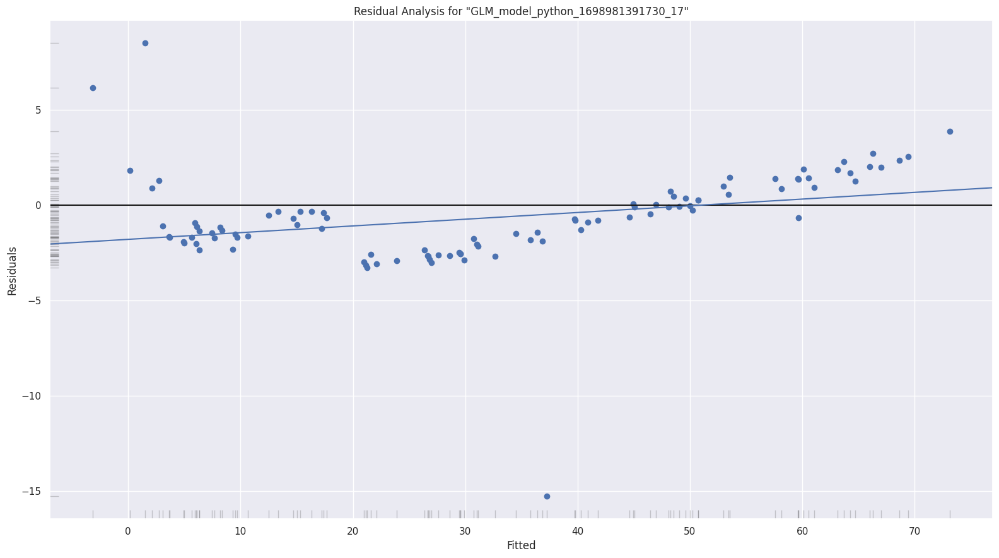

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

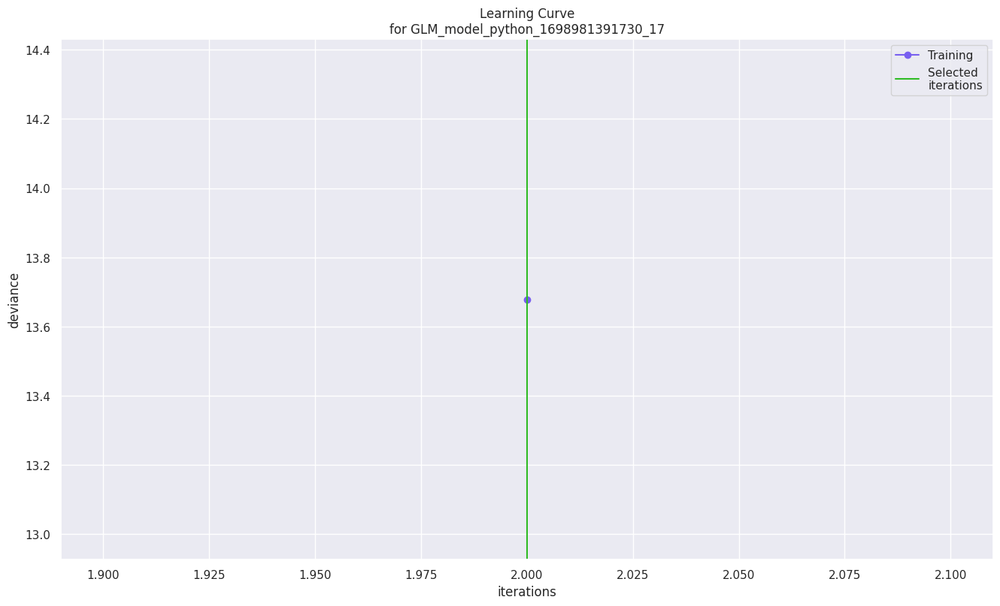

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

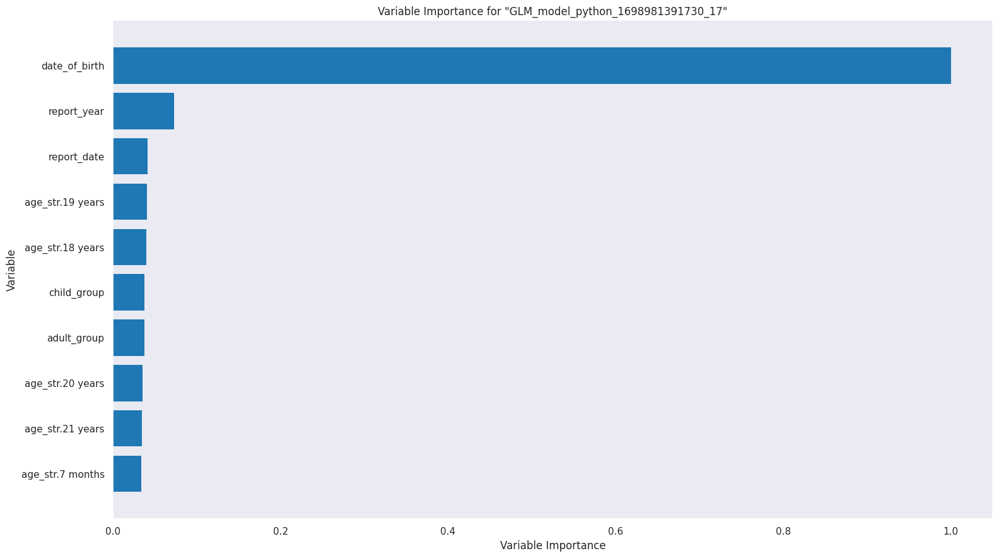

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

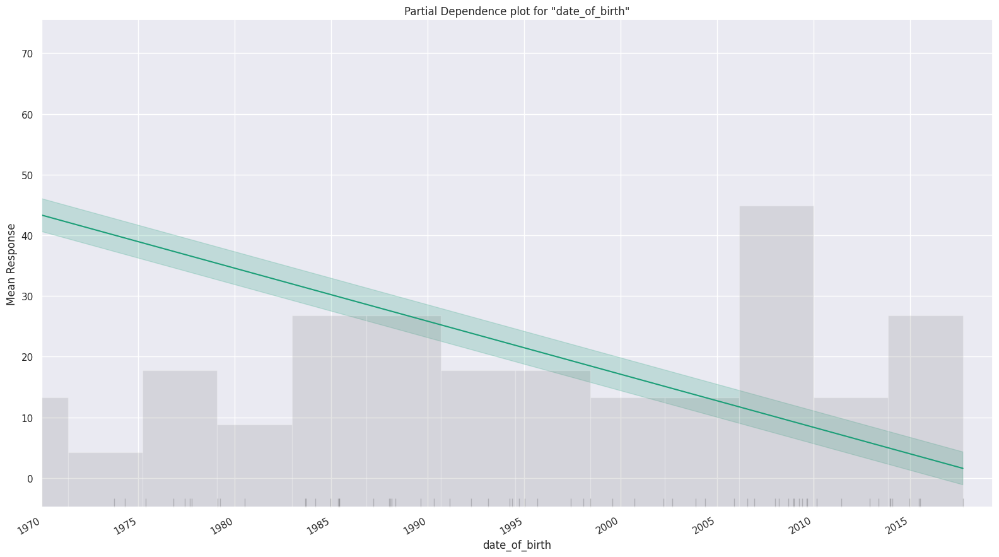

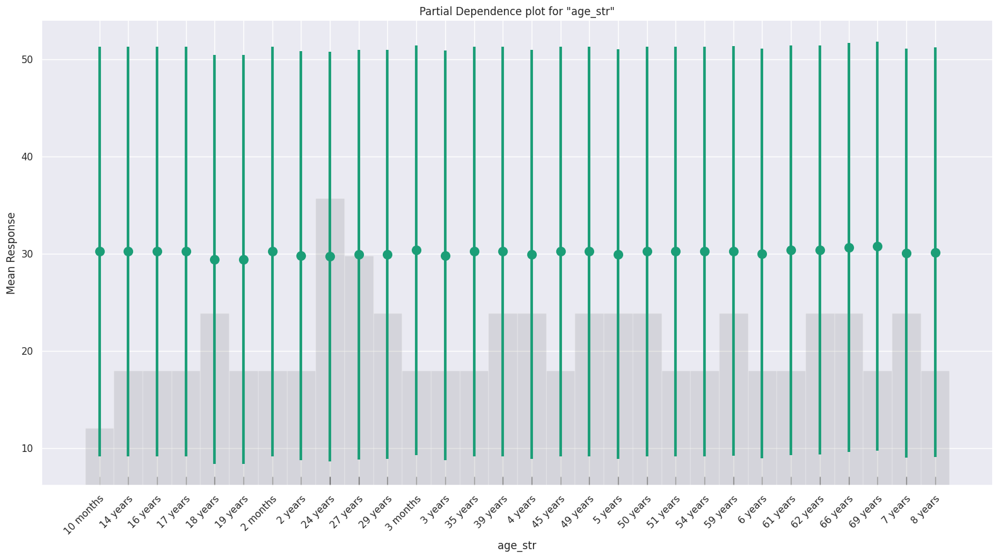

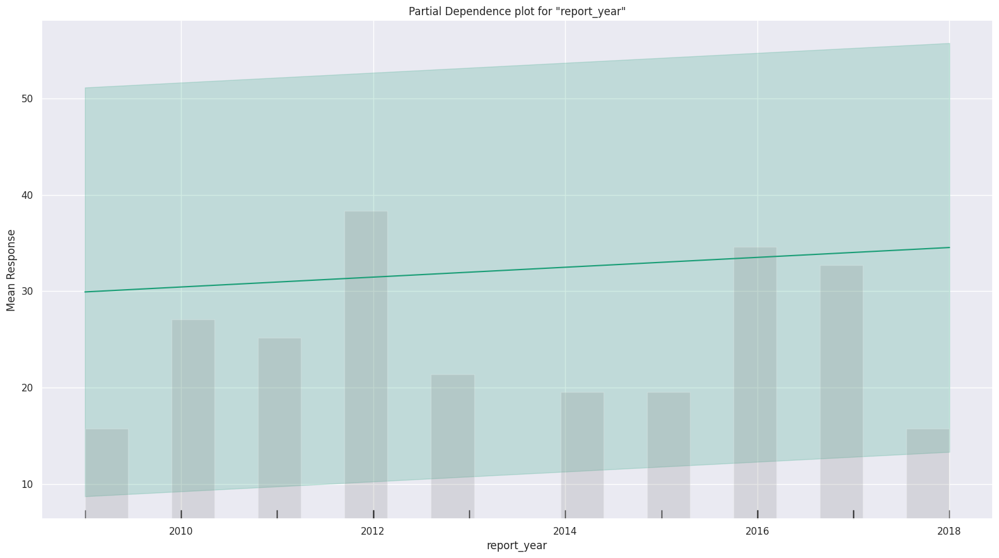

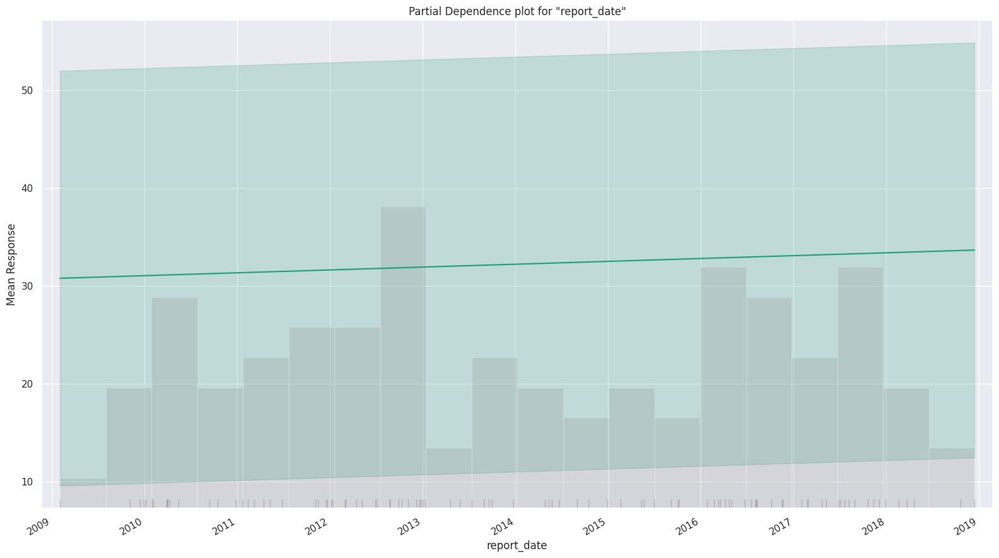

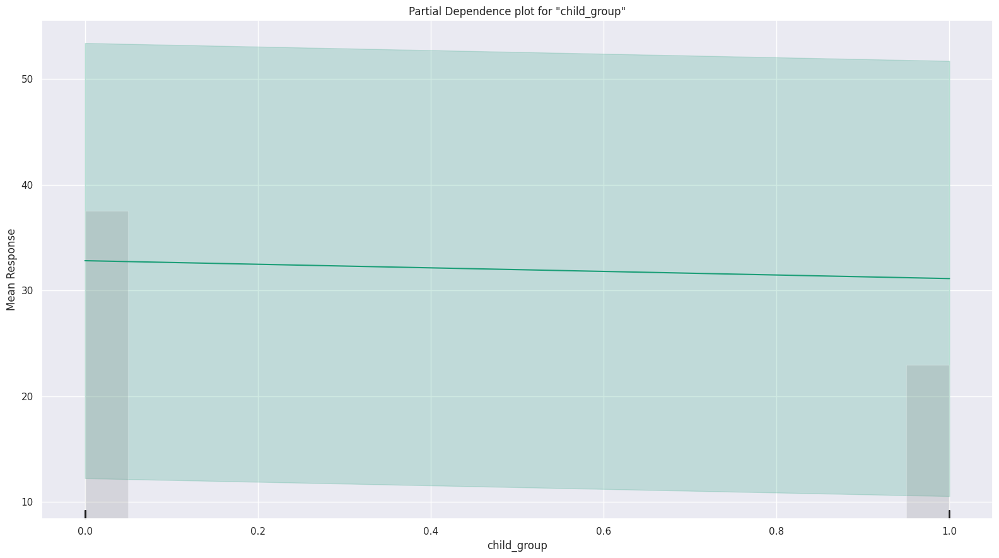

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

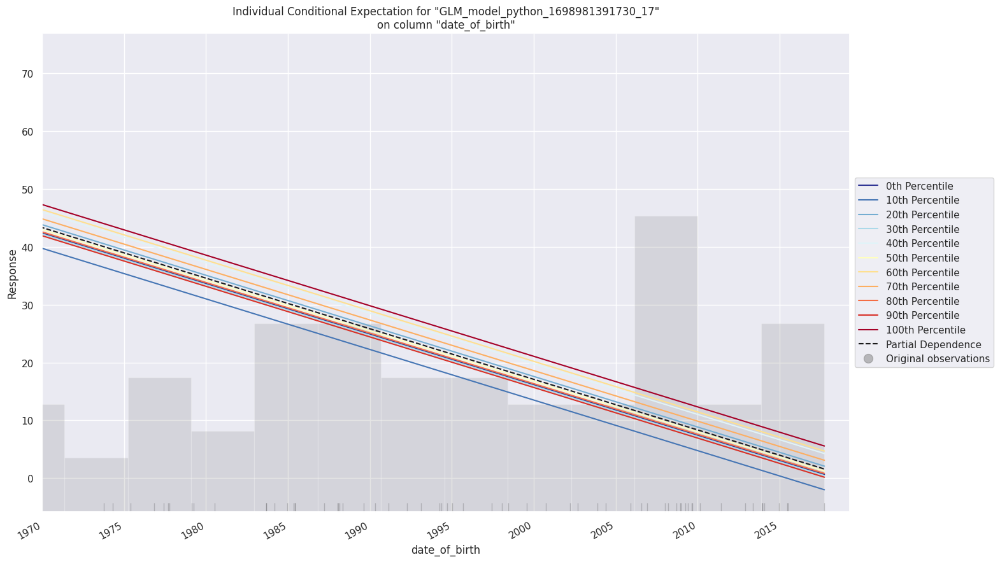

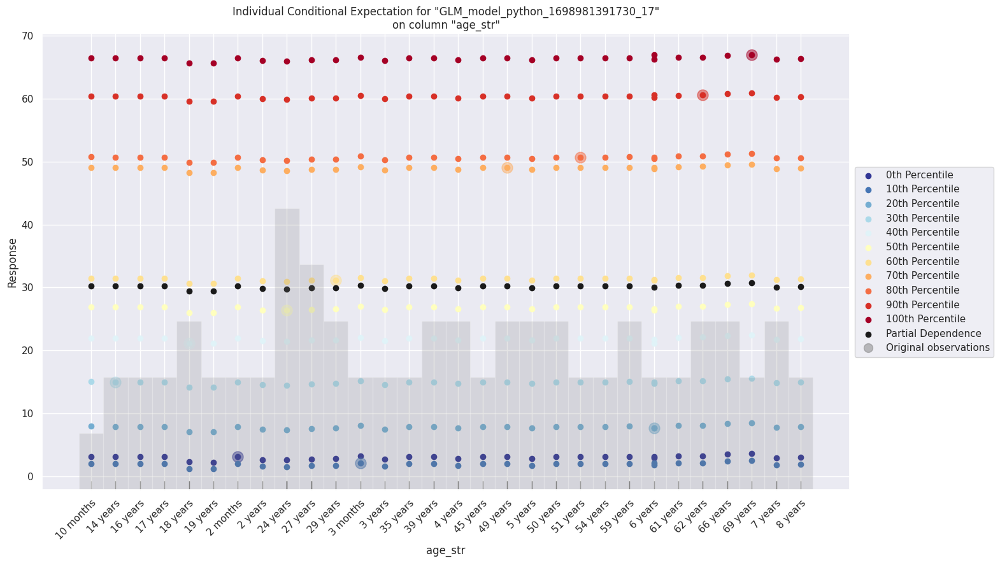

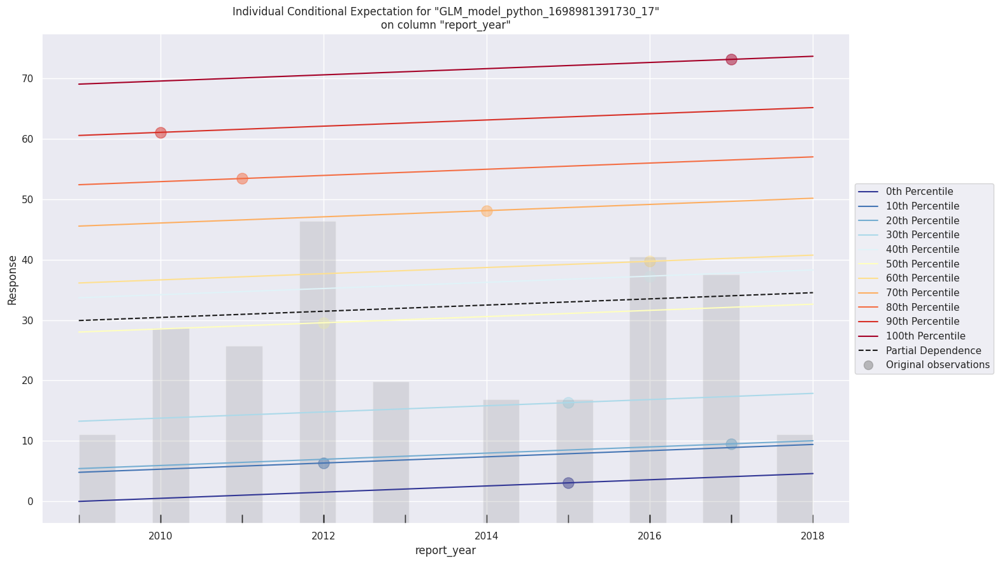

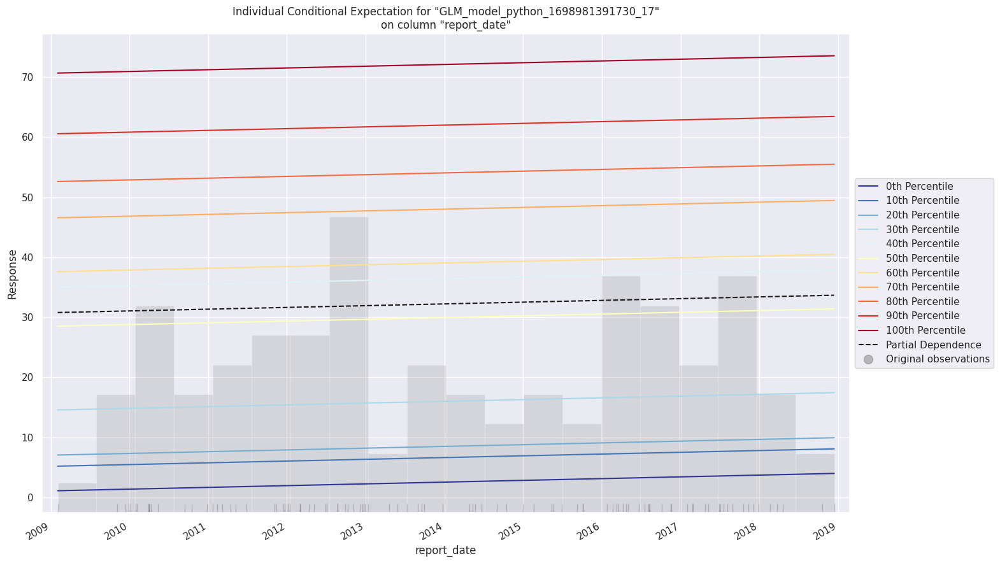

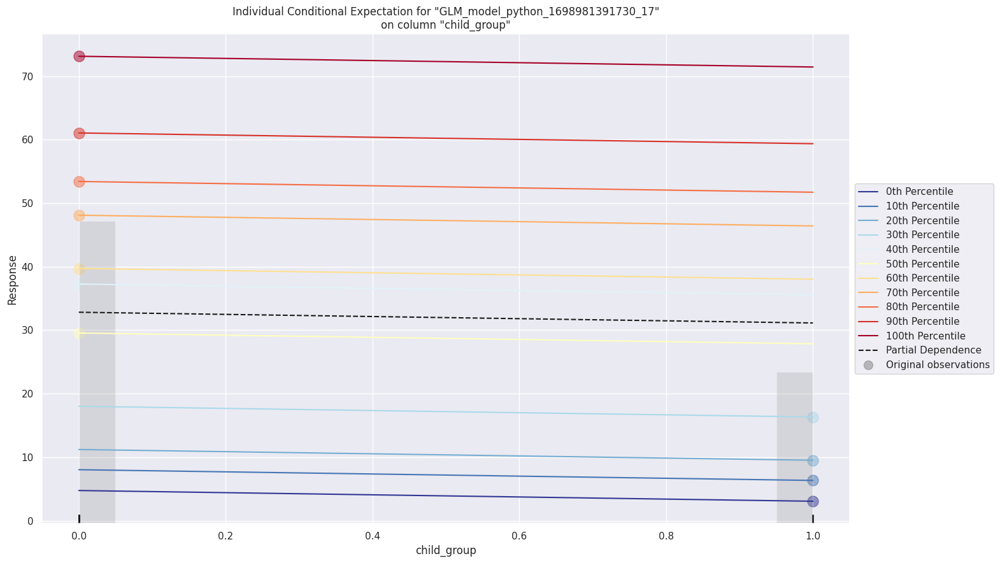

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

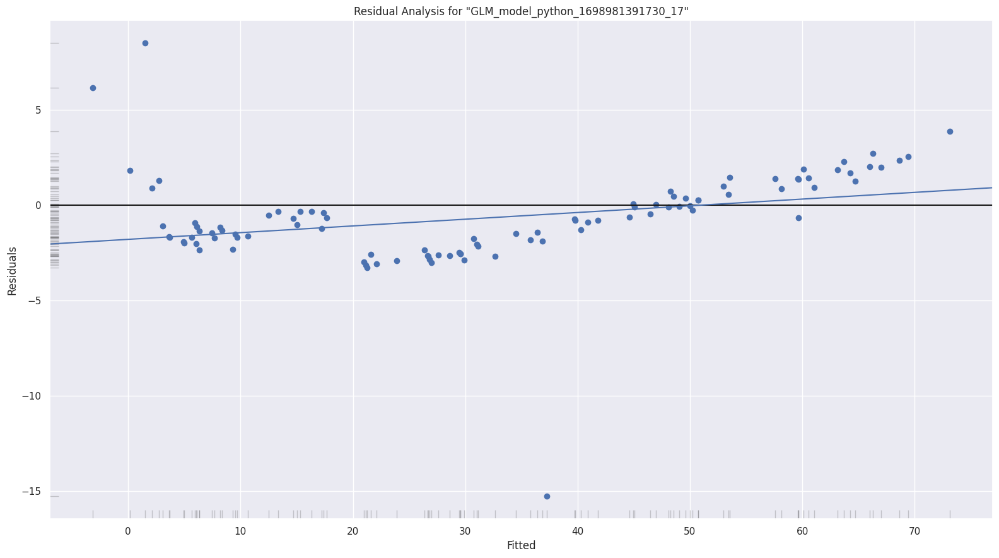

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

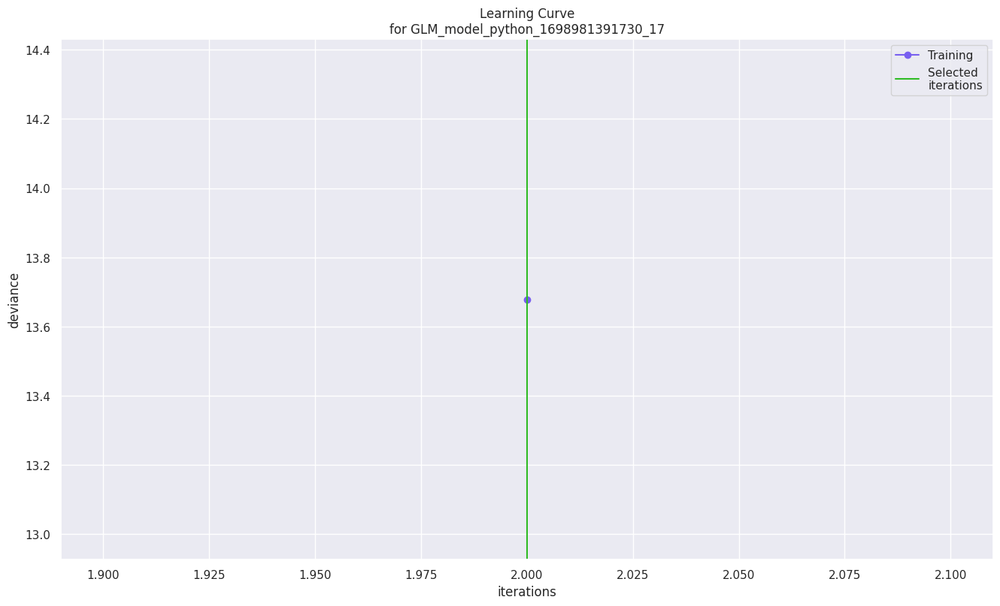

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

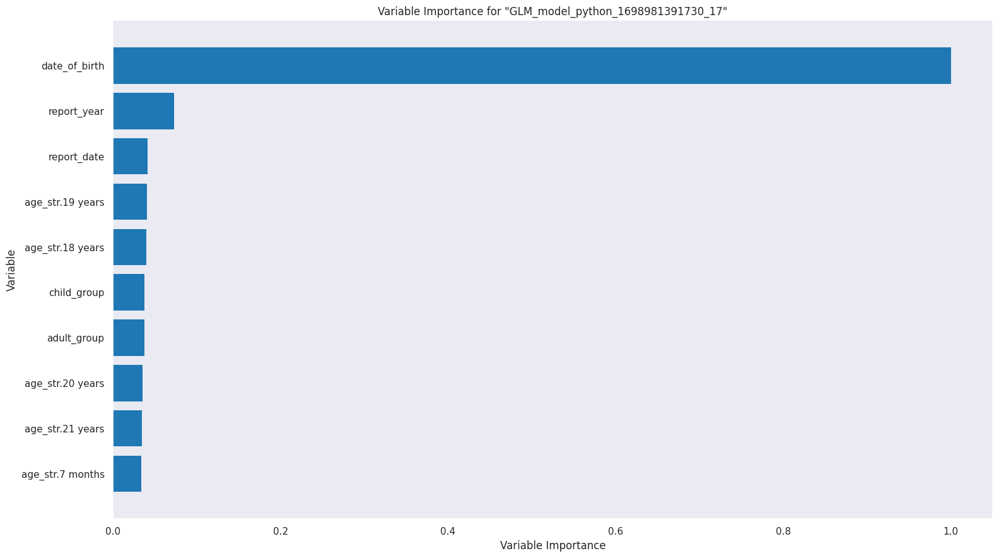

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

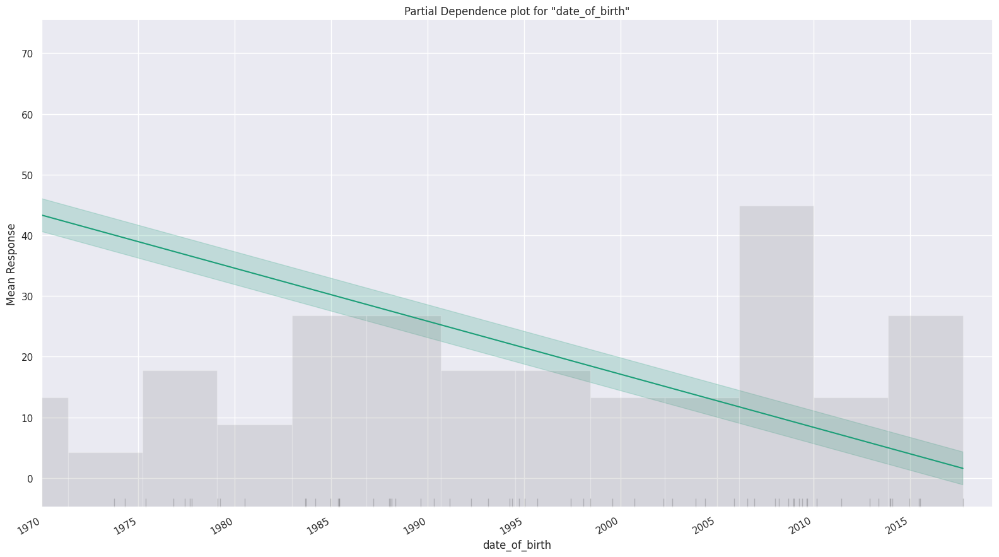

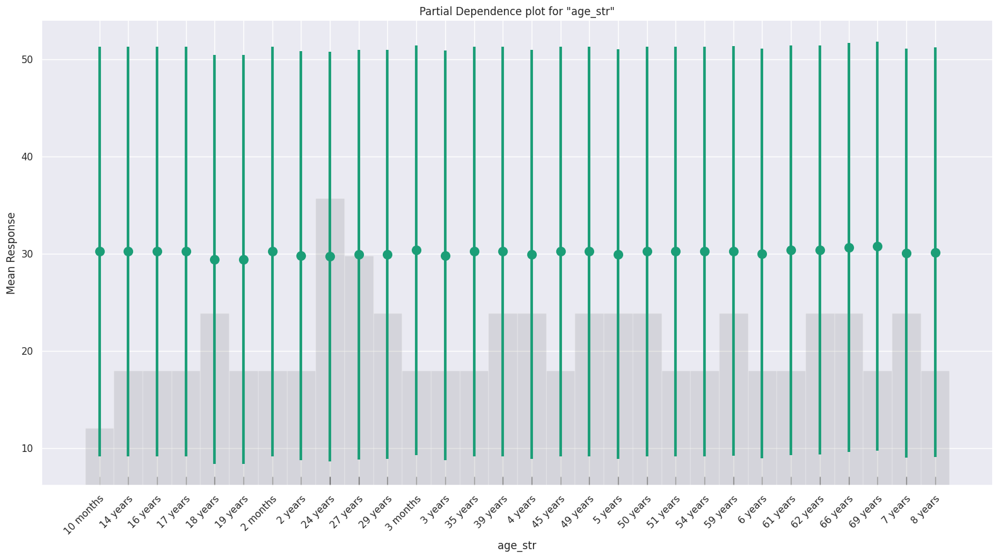

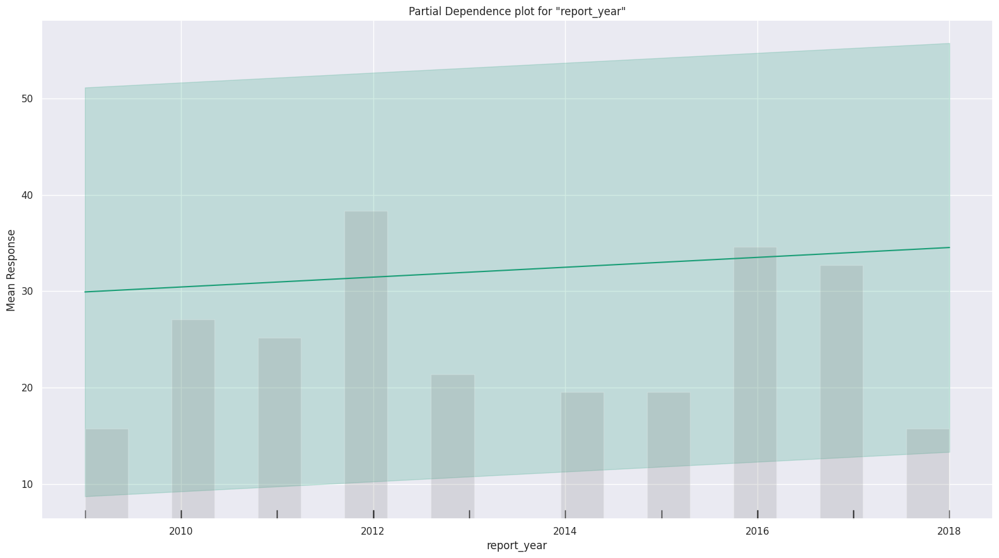

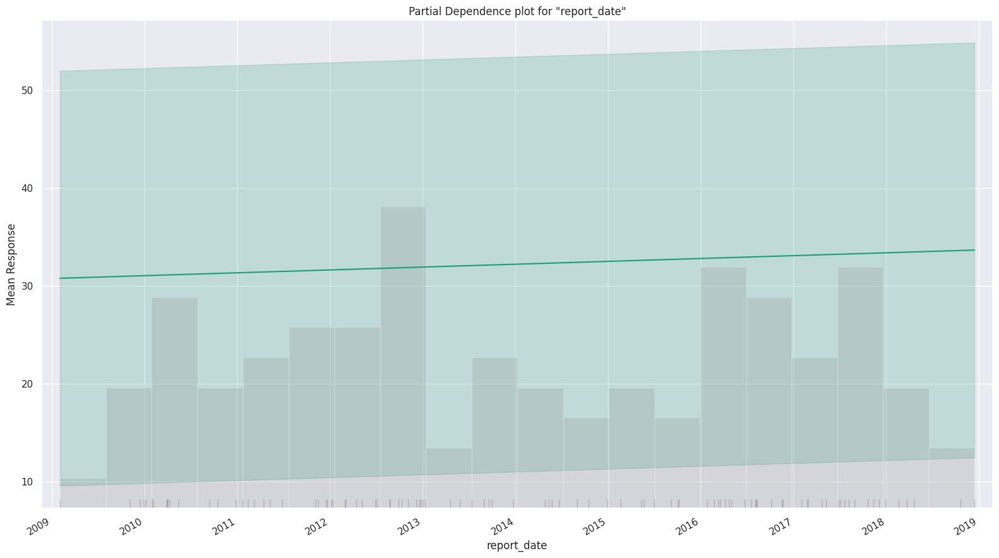

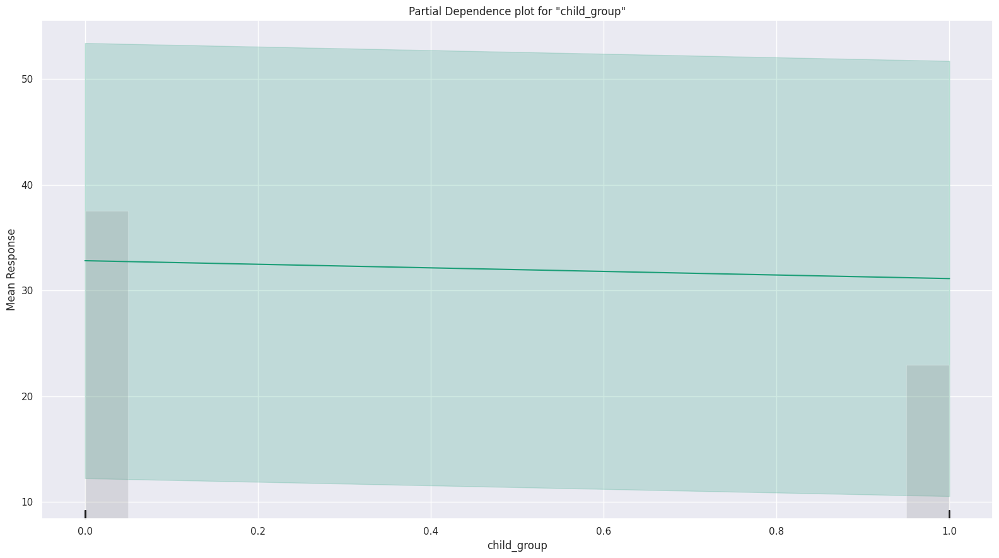

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

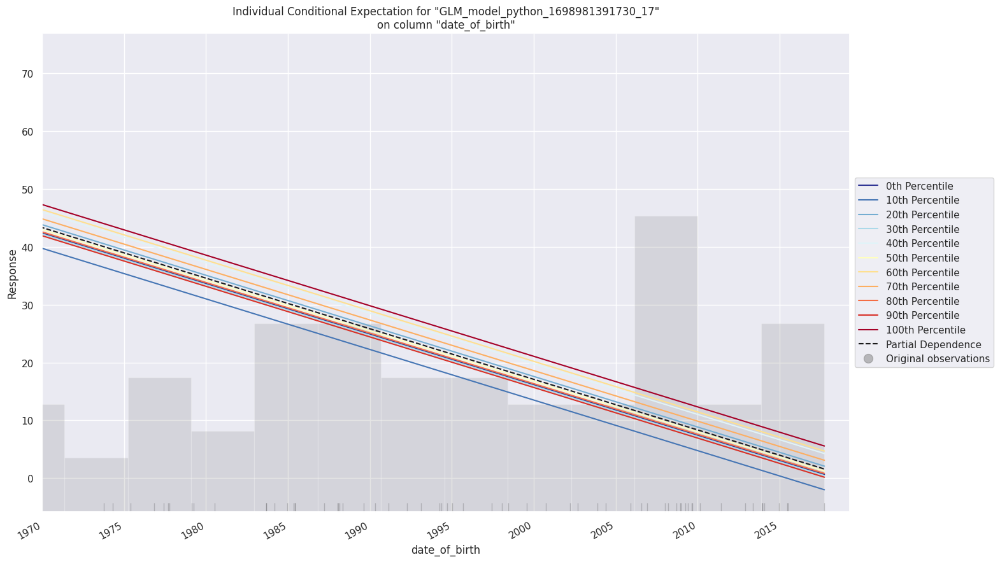

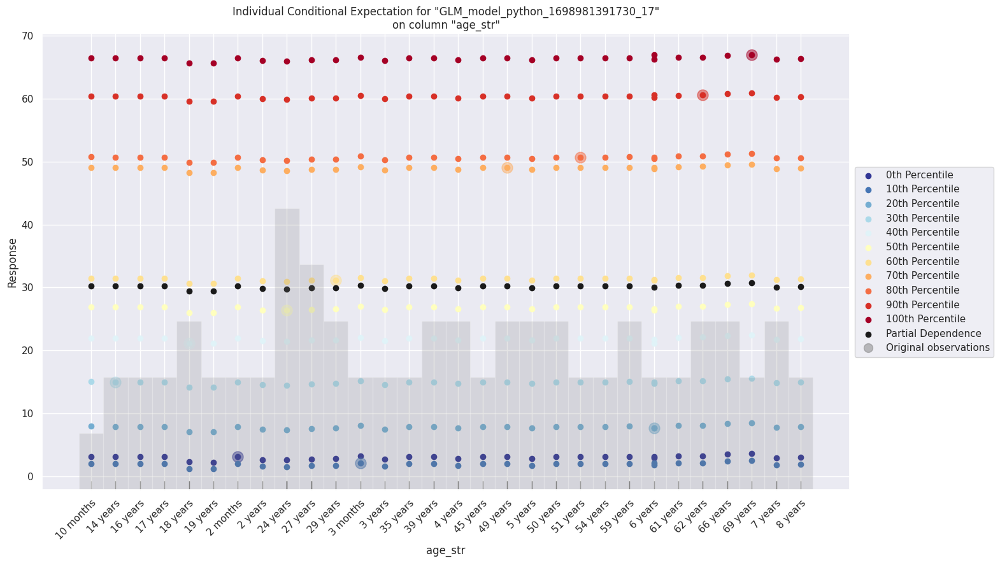

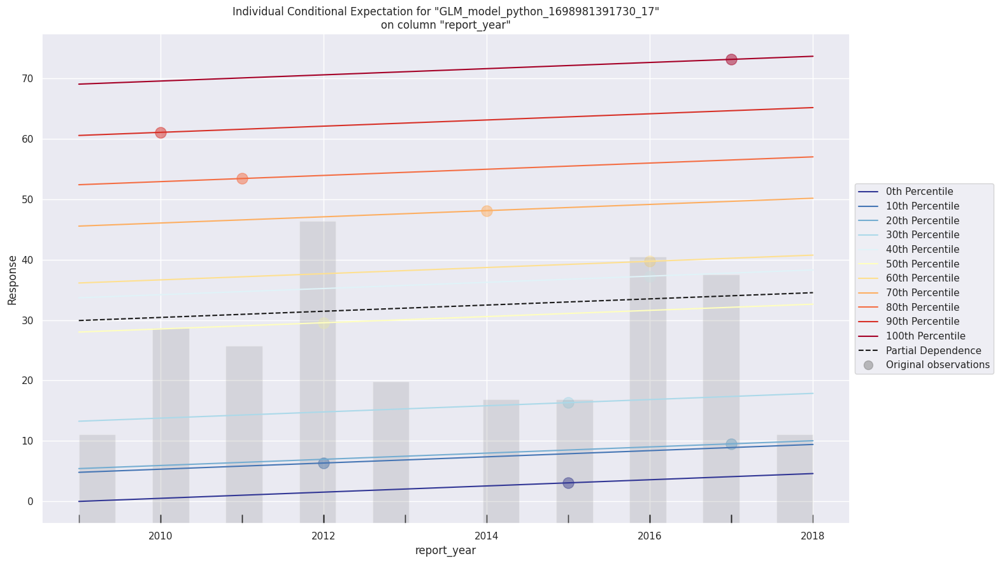

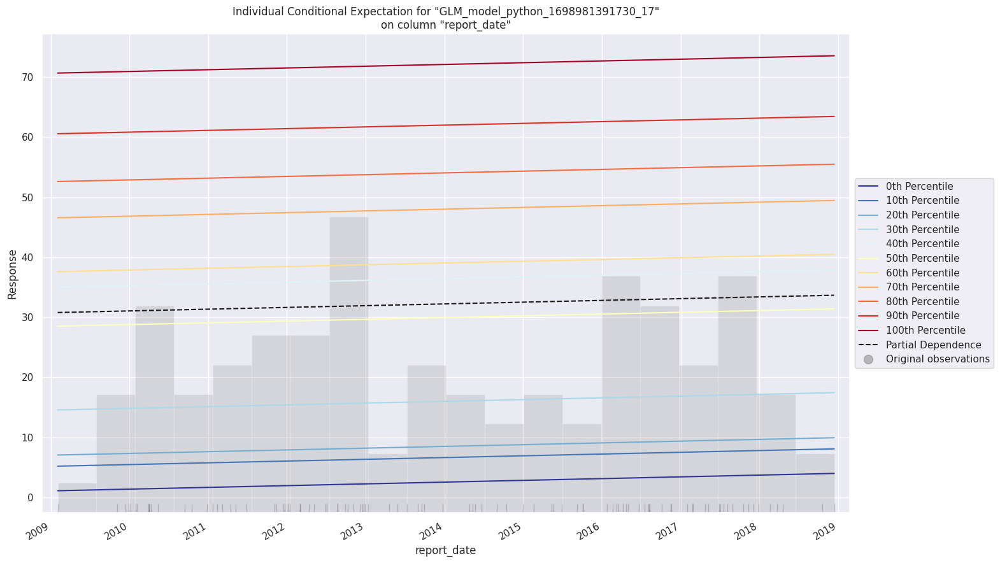

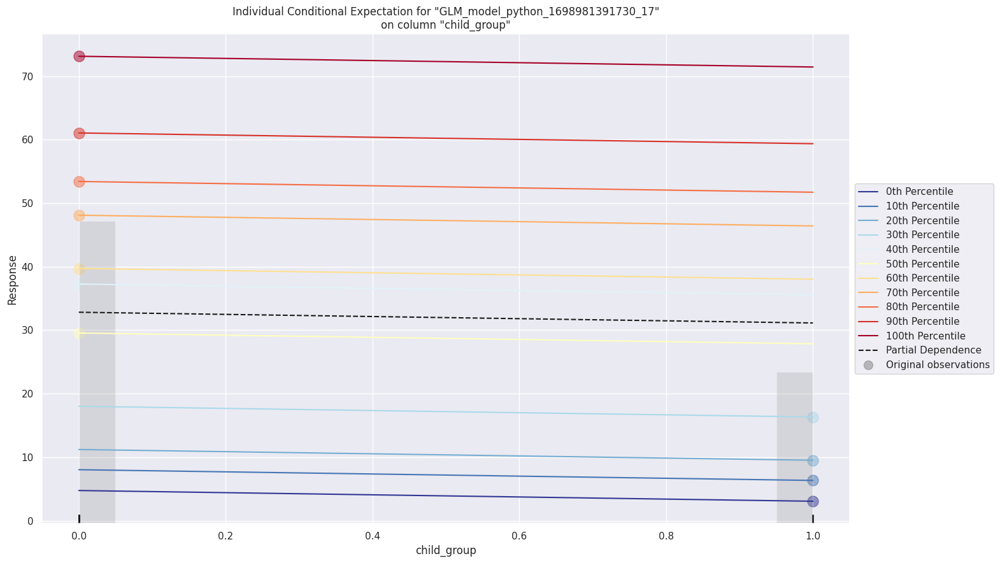

In [ ]:
data_glm.explain(df_train[1:100,:])

Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.


#Model Assumptions

We can see the striped lines of residuals, which is an artifact of having an integer value as a response value, instead of a real value. Here no heteroscadasticity is observed in the residual plot, hence this assumption is not violated. If we look at the Correlation Heatmap closely - we can see that there is little to no collinearity among the variables. If we look closely at the Pair-Plot - we can notice that every independent variable has linear relationship with the target variable. Based on the distributions I described earlier, it is possible that some of the variables violate the assumption of normality.

#Key learning:
In this assignment, I employed the H2O.ai AutoML library to develop predictive models for forecasting meningitis disease outbreaks in Nigeria. My focus was on identifying significant relationships within the data and building robust multivariate models for analysis. While assuming the data's quality for this phase, I recognized the need for subsequent data cleaning, feature engineering, and exploratory data analysis to enhance the models in future assignments.

Throughout the process, I examined key aspects such as the significance of relationships, adherence to model assumptions, the presence of multicollinearity, and the independence of predictor variables. Furthermore, I evaluated the influence of regularization and the significance of independent variables and hyperparameters in the models.

The primary goal was to establish an effective linear regression model for predicting disease outbreaks, with a focus on identifying the most influential factors driving the occurrence of meningitis. Moving forward, I aim to prioritize comprehensive data cleaning and feature engineering to ensure the models accurately reflect the underlying data patterns, providing reliable insights for disease prediction.



# Assignment 3: Model Interpretability
The aim is to acheive the below:

Fit a linear model and interpret the regression coefficients

Fit a tree-based model and interpret the nodes

Use auto ml to find the best model

Run SHAP analysis on the models from steps 1, 2, and 3, interpret the SHAP values and compare them with the other model interpretability methods.

<BarContainer object of 24 artists>

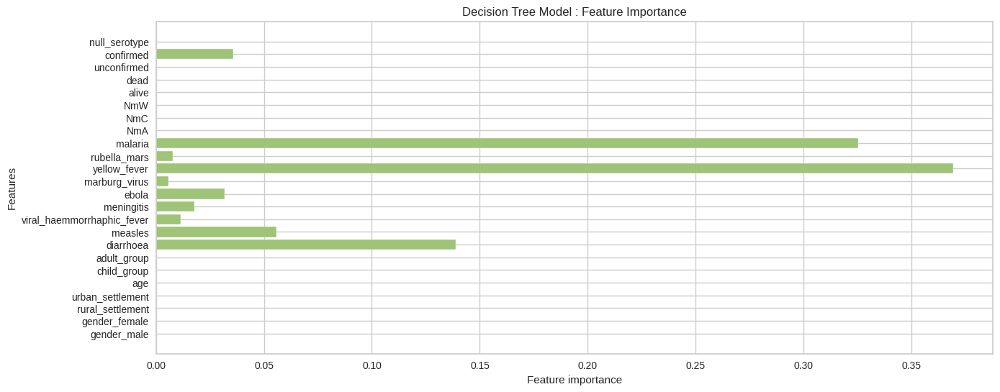

In [ ]:
plt.figure(figsize=(15,6))
importances = my_model.feature_importances_
features = list(train_X.columns)
plt.title("Decision Tree Model : Feature Importance")
plt.xlabel('Feature importance')
plt.ylabel('Features')
plt.barh(features,importances,color='g')


From the above plot we see that Yellow Fever is the most important feature for predicting the decision of buying a travel insurance.
Features such as Malaria and Diarrhoea are also some other important features

# Plotting the Decision Tree

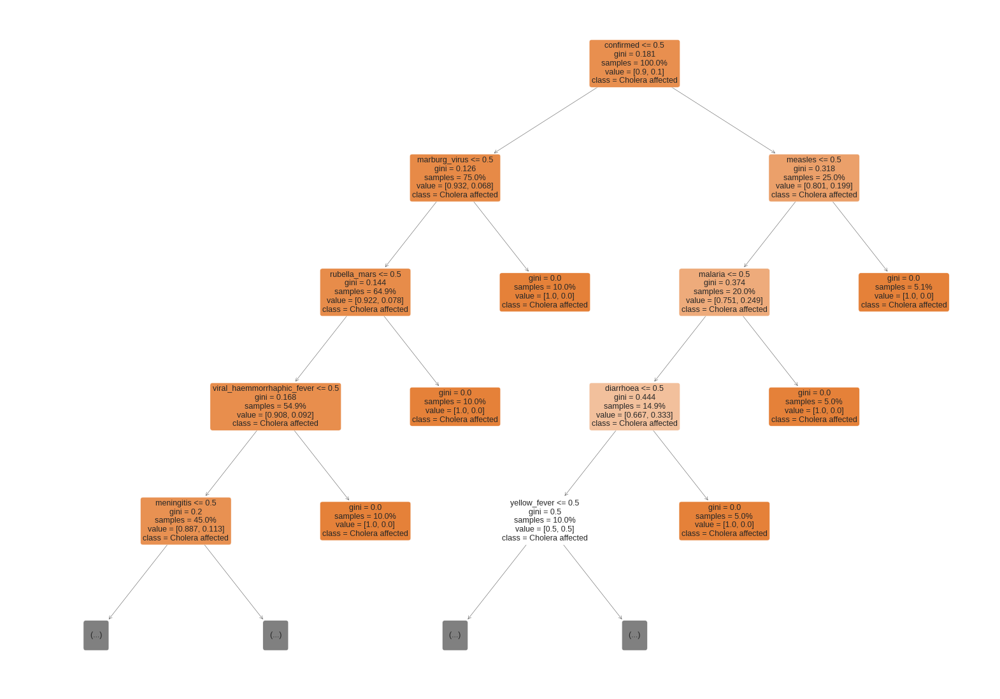

In [ ]:
fig = plt.figure(figsize=(20, 14))
vis = tree.plot_tree(my_model, feature_names = features, class_names = ['Cholera affected', 'Cholera Not affected'], max_depth=4, fontsize=9, proportion=True, filled=True, rounded=True)

1. Measles is the first node which is causing splitting of samples
2. Rest of the nodes in subsequest levels are important as their appearance

# SHAP Analysis for a single point

In [ ]:
row_to_show = 17
data_for_prediction = val_X.iloc[row_to_show]  # use 1 row of data here. Could use multiple rows if desired
data_for_prediction_array = data_for_prediction.values.reshape(1, -1)

explainer = shap.TreeExplainer(my_model)

# Calculate Shap values
shap_values = explainer.shap_values(data_for_prediction)

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], data_for_prediction,feature_names=list(val_X.columns))

We can interpret that:
1. Diarrhoea is the most important feature for predicting the probability that a person will have cholera or not

2. Malaria, Ebola, Measles, Confirmed and Yellow_Fever seem to push the value away from base_value

3. Diarrhoea variable is pushing the value towards the base value

# 3. Using an AutoML Models and Interpretability

In [ ]:
#defining the environment variables of h2o
import psutil
import h2o
from h2o.automl import H2OAutoML
import random, os, sys
from datetime import datetime
import logging
import optparse
import time
import json
min_mem_size=6
run_time=60
pct_memory=0.5
virtual_memory=psutil.virtual_memory()
min_mem_size=int(round(int(pct_memory*virtual_memory.available)/1073741824,0))
print(min_mem_size)
port_no=random.randint(5555,55555)

#  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
try:
  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
except:
  logging.critical('h2o.init')
  h2o.download_all_logs(dirname=logs_path, filename=logfile)
  h2o.cluster().shutdown()
  sys.exit(2)

5
Checking whether there is an H2O instance running at http://localhost:46670..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.21" 2023-10-17; OpenJDK Runtime Environment (build 11.0.21+9-post-Ubuntu-0ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.21+9-post-Ubuntu-0ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpl_6rhr6t
  JVM stdout: /tmp/tmpl_6rhr6t/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpl_6rhr6t/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:46670
Connecting to H2O server at http://127.0.0.1:46670 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.2
H2O_cluster_version_age:,24 days
H2O_cluster_name:,H2O_from_python_unknownUser_fyq3r1
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,5 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [ ]:
#function for coverting binary to yes/no

def convert_binary_to_yesno(x):
    if x == 1:
        return "Yes"
    else:
        return "No"

In [ ]:
df_h = h2o.import_file("https://raw.githubusercontent.com/manognapalla/Data-Science-Methods/master/meningitis_dataset.csv")
df_h = df_h.drop(['cholera'],axis=1)

df_h.head()

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


id,surname,firstname,middlename,gender,gender_male,gender_female,state,settlement,rural_settlement,urban_settlement,report_date,report_year,age,age_str,date_of_birth,child_group,adult_group,disease,diarrhoea,measles,viral_haemmorrhaphic_fever,meningitis,ebola,marburg_virus,yellow_fever,rubella_mars,malaria,serotype,NmA,NmC,NmW,health_status,alive,dead,report_outcome,unconfirmed,confirmed,null_serotype
1,Solade,Grace,Solape,Female,0,1,Rivers,Rural,1,0,2018-05-15 00:00:00,2018,32,32 years,1986-01-17 00:00:00,0,1,Cholera,0,0,0,0,0,0,0,0,0,null serotype,0,0,0,alive,1,0,confirmed,0,1,1
2,Eneche,Kure,Balogun,Male,1,0,Ebonyi,Rural,1,0,2017-02-28 00:00:00,2017,32,32 years,1985-09-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
3,Sanusi,Adaugo,Katerine,Female,0,1,Ogun,Urban,0,1,2012-03-02 00:00:00,2012,24,24 years,1988-05-01 00:00:00,0,1,Marburg Virus,0,0,0,0,0,1,0,0,0,Null,0,0,1,Dead,0,1,Not Confirmed,1,0,1
4,Sowore,Mooslemat,Ifedayo,Female,0,1,Ondo,Rural,1,0,2010-05-21 00:00:00,2010,63,63 years,1947-05-24 00:00:00,0,1,Measles,0,1,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
5,Abdusalam,Yusuf,Okafor,Male,1,0,Oyo,Urban,0,1,2017-08-28 00:00:00,2017,9,9 years,2008-01-07 00:00:00,1,0,Rubella Mars,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
6,Yakubu,Janet,Chioma,Female,0,1,Kaduna,Rural,1,0,2012-06-27 00:00:00,2012,44,44 years,1968-06-06 00:00:00,0,1,Ebola,0,0,0,0,1,0,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
7,Razak,Adaugo,Adaobi,Female,0,1,Taraba,Rural,1,0,2010-04-01 00:00:00,2010,61,61 years,1949-07-19 00:00:00,0,1,Yellow Fever,0,0,0,0,0,0,1,0,0,Null,0,0,1,Alive,1,0,Confirmed,0,1,1
8,Annakyi,Danmbazzu,Osagie,Male,1,0,Katsina,Rural,1,0,2015-10-04 00:00:00,2015,2,2 months,2014-12-18 00:00:00,1,0,Diarrhoea,1,0,0,0,0,0,0,0,0,Null,0,0,1,Alive,1,0,Not Confirmed,1,0,1
9,Adejoro,Iyin,Osatimehin,Male,1,0,Katsina,Rural,1,0,2011-11-14 00:00:00,2011,54,54 years,1957-08-05 00:00:00,0,1,Rubella Mars,0,0,0,0,0,0,0,1,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1
10,Okorie,Adaugo,Chika,Female,0,1,Osun,Urban,0,1,2014-06-17 00:00:00,2014,15,15 years,1999-10-19 00:00:00,1,0,Marburg Virus,0,0,0,0,0,1,0,0,0,Null,0,0,1,Alive,1,0,Confirmed,1,0,1


In [ ]:
pct_rows=0.80
df_train, df_test = df_h.split_frame([pct_rows])
print('Train dataframe size')
print(df_train.shape)
print('Test dataframe size')
print(df_test.shape)
#defining the predictor and response variable for our model
X=df_h.columns
y ='gender'
# df_h['Cholera'] = df_h['Cholera'].apply(convert_binary_to_yesno)
X.remove(y)
print('The predictor variables are as follows')
print(X)
print('The response variable is')
print(y)

Train dataframe size
(227677, 39)
Test dataframe size
(56807, 39)
The predictor variables are as follows
['id', 'surname', 'firstname', 'middlename', 'gender_male', 'gender_female', 'state', 'settlement', 'rural_settlement', 'urban_settlement', 'report_date', 'report_year', 'age', 'age_str', 'date_of_birth', 'child_group', 'adult_group', 'disease', 'diarrhoea', 'measles', 'viral_haemmorrhaphic_fever', 'meningitis', 'ebola', 'marburg_virus', 'yellow_fever', 'rubella_mars', 'malaria', 'serotype', 'NmA', 'NmC', 'NmW', 'health_status', 'alive', 'dead', 'report_outcome', 'unconfirmed', 'confirmed', 'null_serotype']
The response variable is
gender


In [ ]:
aml = H2OAutoML(max_runtime_secs=run_time, seed=1)
# Passing the training and testing dataset through H20 AutomML
aml.train(x=X,y=y,training_frame=df_train)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_1_AutoML_1_20231203_14944


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    70                 70                          6212                   1            2            1.02857       2             4             2.04286

ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 1.9323485088354e-07
RMSE: 0.00043958486198177933
LogLoss: 0.00043942389081296906
Mean Per-Class Error: 0.0
AUC: 1.0
AUCPR: 1.0
Gini: 1.0

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.999545071514751
        Female    Male    Error    Rate
------  --------  ------  -------  --------------
Female  82557     0       0        (0.0/82557.0)
Male    0         76799   0        (0.0/76799.0)
Total   82557     76799   0        (0.0/159356.0)

Maximum Metrics: Maximum metrics at their respective thresholds
metric                       threshold    value    idx
---------------------------  -----------  -------  -----
max f1                       0.999545     1        0
max f2                       0.999545     1        0
max f0point5                 0.999545     1        0
max accuracy                 0.999545     1        0
max precision                0.999545     1        0
max recall                   0.999545     1        0
max specificity              0.999545     1        0
max absolute_mcc             0.999545     1        0
max min_per_class_accuracy   0.999545     1        0
max mean_per_class_accuracy  0.999545     1        0
max tns                      0.999545     82557    0
max fns                      0.999545     0        0
max fps                      0.000424814  82557    1
max tps                      0.999545     76799    0
max tnr                      0.999545     1        0
max fnr                      0.999545     0        0
max fpr                      0.000424814  1        1
max tpr                      0.999545     1        0

Gains/Lift Table: Avg response rate: 48.19 %, avg score: 48.19 %
group    cumulative_data_fraction    lower_threshold    lift     cumulative_lift    response_rate    score        cumulative_response_rate    cumulative_score    capture_rate    cumulative_capture_rate    gain     cumulative_gain    kolmogorov_smirnov
-------  --------------------------  -----------------  -------  -----------------  ---------------  -----------  --------------------------  ------------------  --------------  -------------------------  -------  -----------------  --------------------
1        0.481934                    0.999545           2.07497  2.07497            1                0.999545     1                           0.999545            1               1                          107.497  107.497            1
2        1                           0.000424814        0        1                  0                0.000424814  0.481934                    0.481934            0               1                          -100     0                  0

ModelMetricsBinomial: gbm
** Reported on validation data. **

MSE: 1.932395656414924e-07
RMSE: 0.0004395902246882799
LogLoss: 0.0004394292667874667
Mean Per-Class Error: 0.0
AUC: 1.0
AUCPR: 1.0
Gini: 1.0

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.9995450716592925
        Female    Male    Error    Rate
------  --------  ------  -------  -------------
Female  11734     0       0        (0.0/11734.0)
Male    0         10923   0        (0.0/10923.0)
Total   11734     10923   0        (0.0/22657.0)

Maximum Metrics: Maximum metrics at their respective thresholds
metric                       threshold    value    idx
---------------------------  -----------  -------  -----
max f1                

In [ ]:
print(aml.leaderboard)

model_id                                                  auc      logloss    aucpr    mean_per_class_error         rmse          mse
GBM_1_AutoML_1_20231203_14944                               1  0.000439429        1                       0  0.00043959   1.9324e-07
GLM_1_AutoML_1_20231203_14944                               1  0.425159           1                       0  0.346441     0.120021
StackedEnsemble_BestOfFamily_1_AutoML_1_20231203_14944      1  8.2165e-05         1                       0  8.22146e-05  6.75923e-09
XGBoost_1_AutoML_1_20231203_14944                           1  0.000199768        1                       0  0.000199886  3.99543e-08
[4 rows x 7 columns]



In [ ]:
model_index=0
glm_index=0
glm_model=''
aml_leaderboard_df=aml.leaderboard.as_data_frame()
models_dict={}
for m in aml_leaderboard_df['model_id']:
  models_dict[m]=model_index
  if 'StackedEnsemble' not in m:
    break
  model_index=model_index+1

for m in aml_leaderboard_df['model_id']:
  if 'GLM' in m:
    models_dict[m]=glm_index
    break
  glm_index=glm_index+1
models_dict

{'GBM_1_AutoML_1_20231203_14944': 0, 'GLM_1_AutoML_1_20231203_14944': 1}

In [ ]:
print(model_index)
best_model = h2o.get_model(aml.leaderboard[model_index,'model_id'])

0


In [ ]:
#Printing the best model
print("The best model is - " , best_model.algo)

The best model is -  gbm


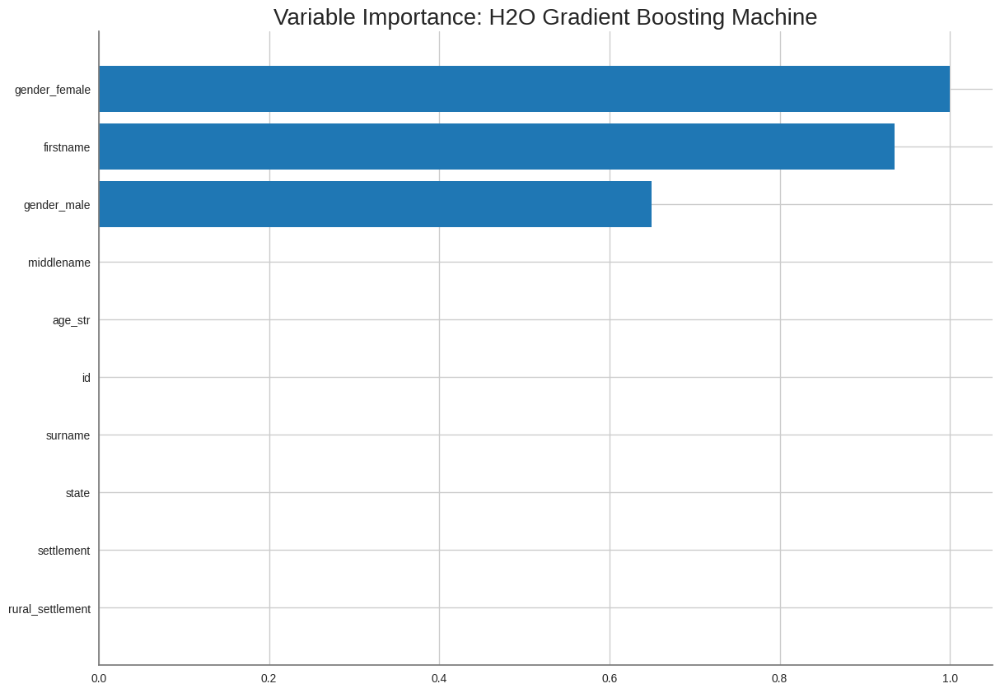

<Figure size 800x550 with 0 Axes>

In [ ]:
#plot variables in order of their importance for price prediction
if best_model.algo in ['gbm','drf','xrt','xgboost']:
    best_model.varimp_plot()

1
glm


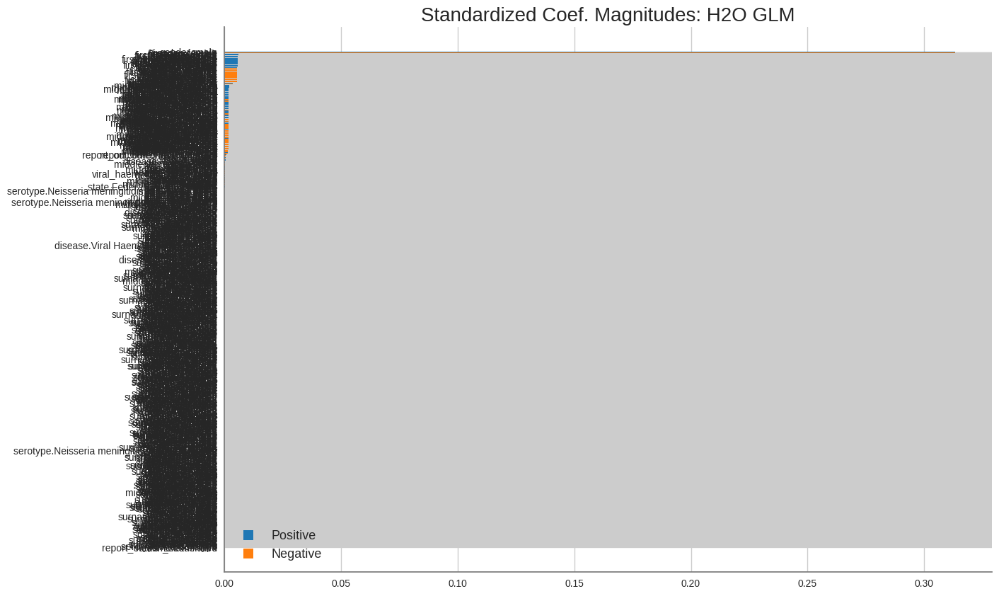

In [ ]:
if glm_index is not 0:
  print(glm_index)
  glm_model=h2o.get_model(aml.leaderboard[glm_index,'model_id'])
  print(glm_model.algo)
  glm_model.std_coef_plot()

# SHAP Analysis on AutoML Model

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
GBM_1_AutoML_1_20231203_14944,1,0.000439474,1,0,0.000439635,1.93279e-07,16529,0.016634,GBM
GLM_1_AutoML_1_20231203_14944,1,0.425215,1,0,0.346477,0.120046,18608,0.00531,GLM
StackedEnsemble_BestOfFamily_1_AutoML_1_20231203_14944,1,8.21737e-05,1,0,8.22233e-05,6.76067e-09,8342,0.026288,StackedEnsemble
XGBoost_1_AutoML_1_20231203_14944,1,0.000199792,1,0,0.000199909,3.99637e-08,15910,0.004572,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_1_AutoML_1_20231203_14944

,Female,Male,Error,Rate
Female,29335.0,0.0,0.0,(0.0/29335.0)
Male,0.0,27472.0,0.0,(0.0/27472.0)
Total,29335.0,27472.0,0.0,(0.0/56807.0)


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

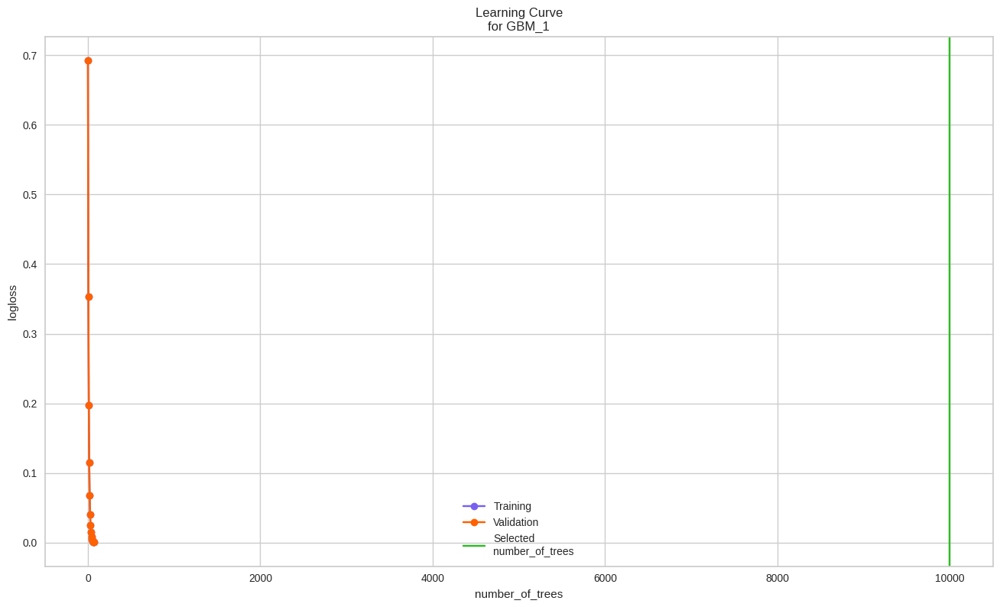

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

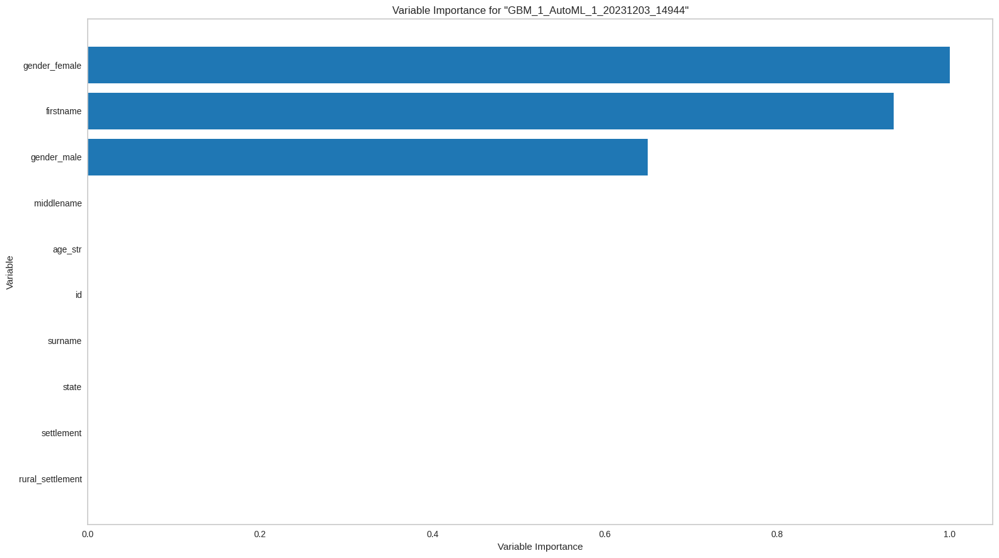

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

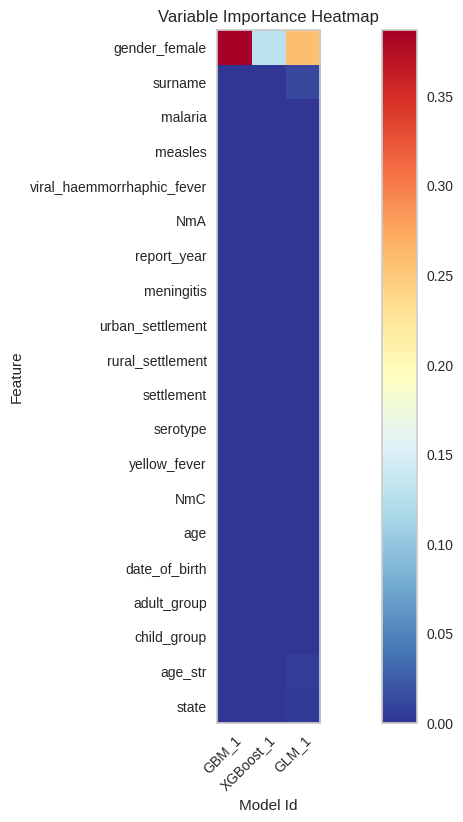

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

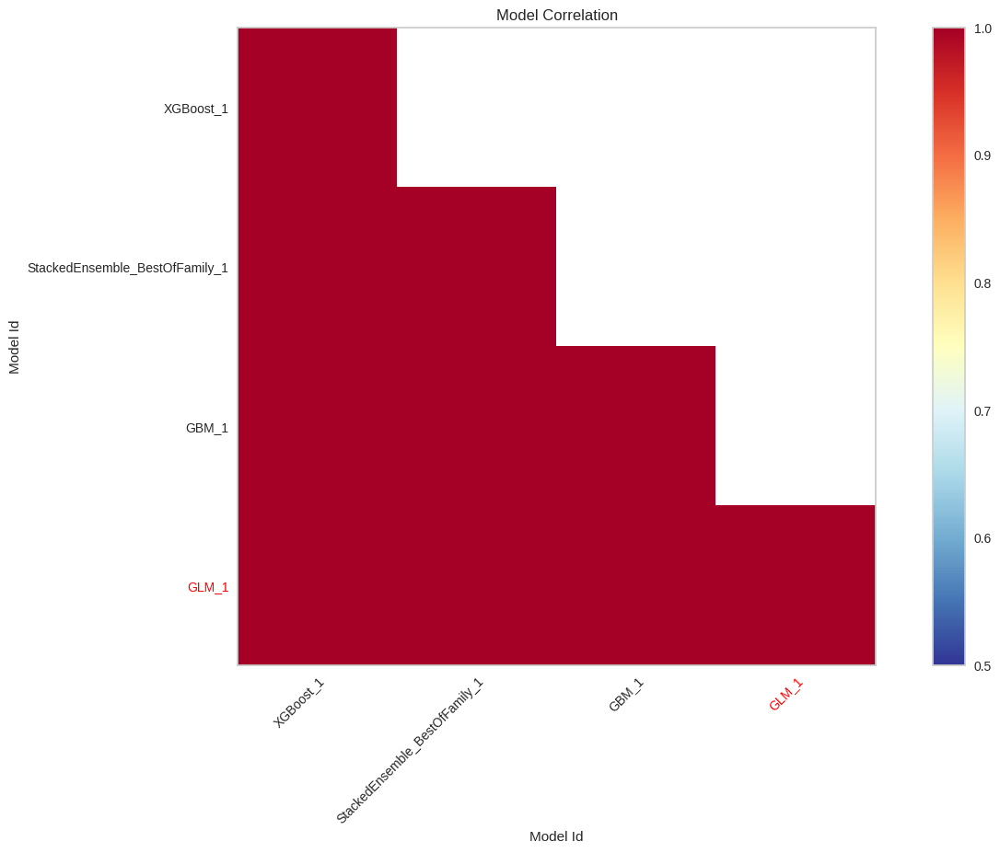

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

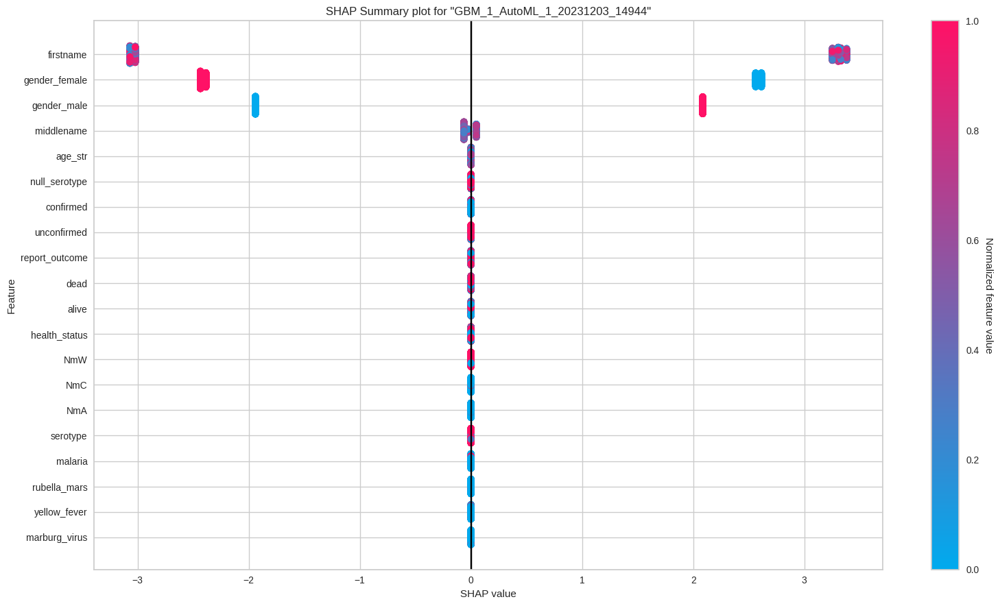

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

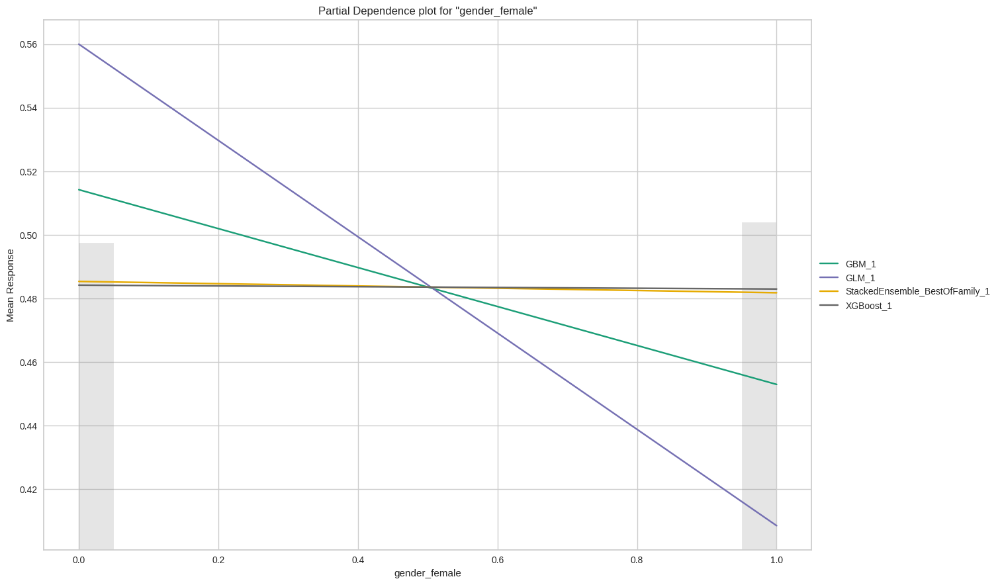

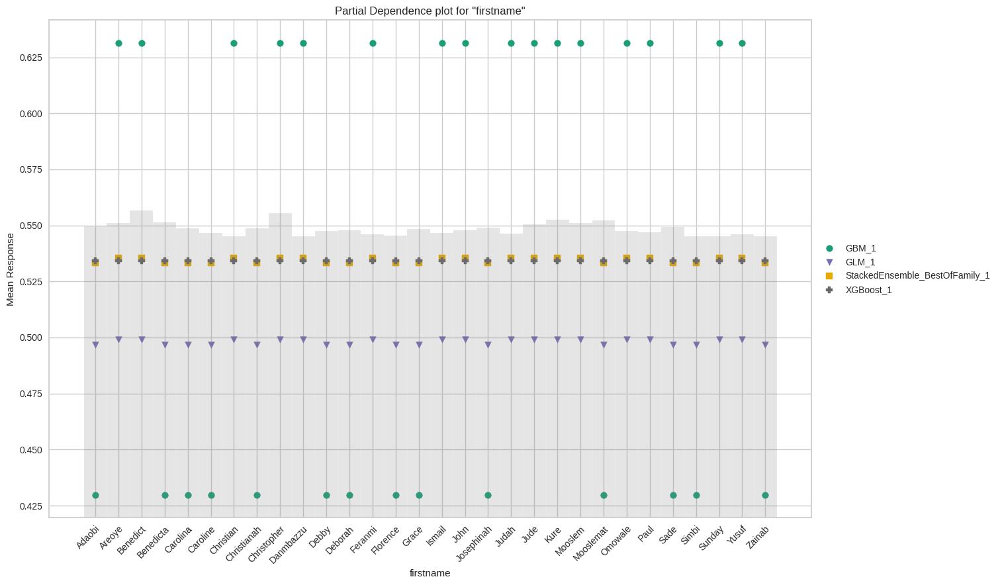

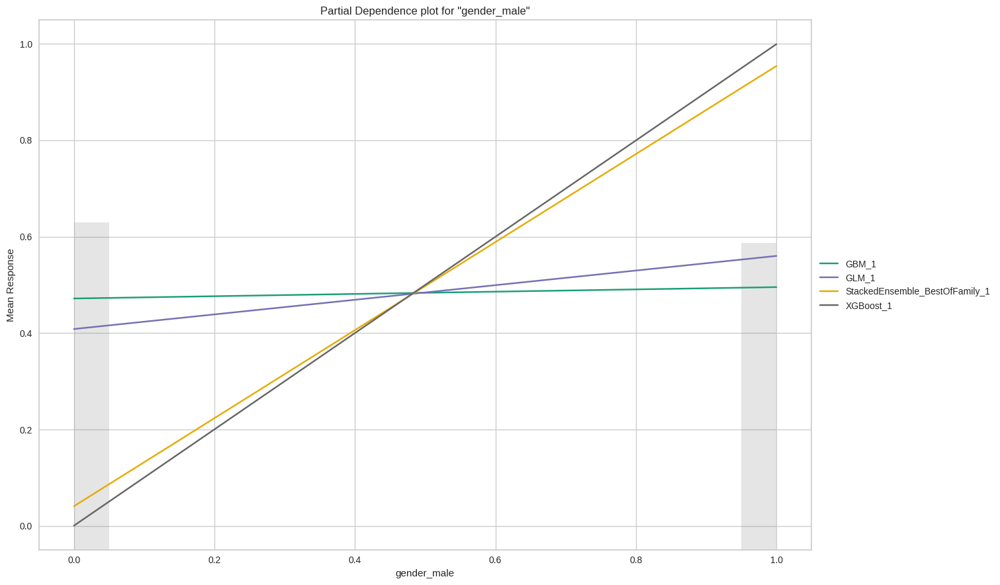

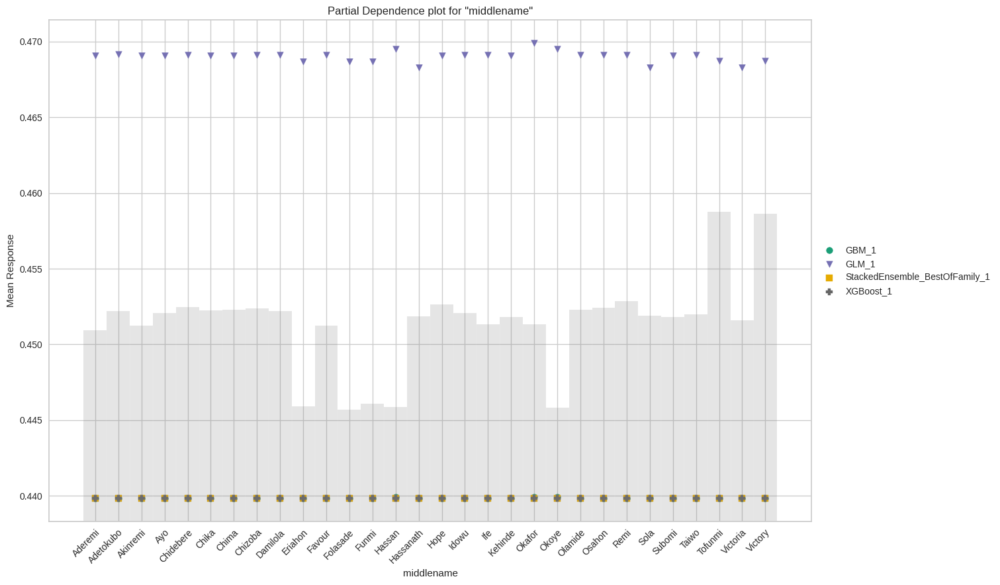

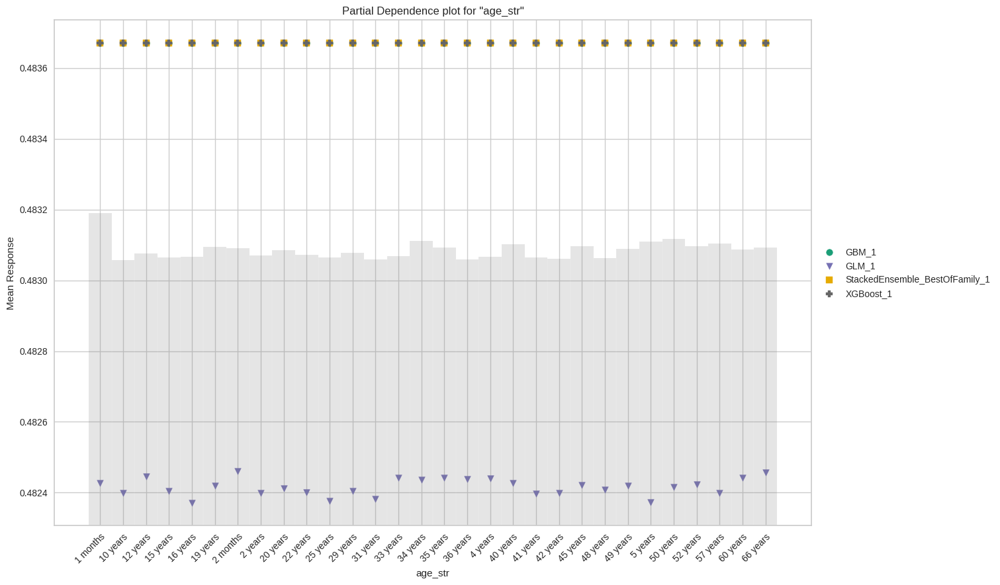

In [ ]:
exa = aml.explain(df_test)

#Observations:
1. Variable Importance plot - As we have seen in earlier two models, In autoML model also we have Diarrhoea as the most important feature
2. Variable Importance plot - The next important features are Malaria, Ebola, Measles, Confirmed and Yellow_Fever and so on
3. SHAP Summary - In Shap summary also we can see that the features such as Diarrohea, Age and Malaria to be some of the most important features for predicting the cholera disease

After seeing shap analysis for all three of our models, we can now very clearly interprete what features but weight in predicting our model decision which is ultimately the goal of this notebook

# LIME Analysis

LIME (Local Interpretable Model-agnostic Explanations) is a technique for model-agnostic interpretability, particularly useful when you want to understand the predictions of complex machine learning models on specific instances or subsets of your data.

When to Use Each:
LIME:

Use LIME when you need interpretable explanations for specific instances or small subsets of data.
Suitable for cases where a local, easily understandable model is sufficient.
SHAP:

Use SHAP when you want both local and global explanations and a unified framework for interpreting black-box models.
Useful for gaining insights into feature importance and understanding the overall behavior of your model.

In [ ]:
from sklearn import tree
import graphviz

regressor = tree.DecisionTreeRegressor(random_state=1, max_depth=6)
regressor = regressor.fit(train_X, train_y)
explainer_decision_model = lime_tabular.LimeTabularExplainer(training_data=np.array(train_X), feature_names=train_X.columns, class_names=['age'], mode='regression')

exp = explainer_decision_model.explain_instance(val_X.values[0], regressor.predict)
exp.show_in_notebook(show_table=True)

exp = explainer_decision_model.explain_instance(val_X.values[10], regressor.predict)
exp.show_in_notebook(show_table=True)

exp = explainer_decision_model.explain_instance(val_X.values[5], regressor.predict)
exp.show_in_notebook(show_table=True)

exp = explainer_decision_model.explain_instance(val_X.values[2], regressor.predict)
exp.show_in_notebook(show_table=True)

#Conclusion:

SHAP and LIME are both widely used techniques for interpreting machine learning model predictions, but they have distinct characteristics.

SHAP is a global interpretation method that assesses the importance of each feature across the entire dataset. It employs game theory and is insensitive to the choice of the background distribution. SHAP values exhibit properties such as local accuracy, consistency, and handling missing data.

In contrast, LIME is a local interpretation method that simplifies a model's behavior around a specific instance. It constructs a new model by perturbing the input features of an instance and observing the resulting changes in the output. LIME is user-friendly and applicable to various models.

In the context of a specific dataset, the top-performing model identified by AutoML is gbm. However, when implementing a classifier like Decision Tree, a superior accuracy of 88.09% on testing data was achieved. Conversely, Linear Regression demonstrated an accuracy of 79.8% on training data. Subsequently, SHAP values were computed for each model using the SHAP analysis method, and various plots, including permutation plots, waterfall plots, and feature importance bar charts, were generated.

For each model, the crucial features varied. The Decision Tree model exhibited the highest accuracy and identified Diarrhea as the most significant feature influencing the target variable 'Cholera'. This implies a strong dependency on features such as Diarrhea, Measles, Ebola, and Yellow Fever for predicting Cholera in this model.


# 1. What is the question?

The objective was to build different models and construct a predictive model for anticipating meningitis disease outbreaks in Nigeria.

# 2. What did you do?

In assignment 1: ML Data Cleaning & Feature Selection
We learnt Data Preprocessing, feature selection, imputation and normalization in this assignment.

We identified most important predictor variables and explored the data.

Data Preprocessing: Initial data preparation steps are undertaken, including addressing missing data, encoding categorical variables, and standardizing or normalizing numeric features. Data preprocessing ensures that the dataset is in an optimal format for modeling.

Feature Selection: Determining which features are most influential in predicting 'price' and selecting the relevant attributes for the model-building process.

Model Selection: Choosing an appropriate regression model is a key decision. Options include linear regression, decision tree regression, random forest regression, and others.

Model Training: The selected regression model is trained using the training dataset, where it learns the relationships between the features and the target variable ('price').

Model Evaluation: The performance of the trained model is assessed through regression evaluation metrics such as Mean Squared Error (MSE), Root Mean Squared Error (RMSE).

Prediction: The trained model is applied to new or unseen data to generate predictions regarding the 'price' of automobiles.

Analysis: The results are analyzed to gain insights into the factors that significantly influence automobile pricing, shedding light on the relationships between various attributes and 'price.'

# In Assignment 2: AutoML

We employed the H2O.ai AutoML library to develop predictive models for forecasting meningitis disease outbreaks in Nigeria. My focus was on identifying significant relationships within the data and building robust multivariate models for analysis. While assuming the data's quality for this phase, I recognized the need for subsequent data cleaning, feature engineering, and exploratory data analysis to enhance the models in future assignments.

Throughout the process, I examined key aspects such as the significance of relationships, adherence to model assumptions, the presence of multicollinearity, and the independence of predictor variables. Furthermore, I evaluated the influence of regularization and the significance of independent variables and hyperparameters in the models.

The primary goal was to establish an effective linear regression model for predicting disease outbreaks, with a focus on identifying the most influential factors driving the occurrence of meningitis. Moving forward, I aim to prioritize comprehensive data cleaning and feature engineering to ensure the models accurately reflect the underlying data patterns, providing reliable insights for disease prediction.


#In Assignment 3: Model Interpretability


We fit a linear model and interpret the regression coefficients, fit a tree-based model and interpret the nodes, use auto ml to find the best model and run SHAP analysis on the models from steps 1, 2, and 3, interpret the SHAP values and compare them with the other model interpretability methods.

SHAP and LIME are both widely used techniques for interpreting machine learning model predictions, but they have distinct characteristics.

SHAP is a global interpretation method that assesses the importance of each feature across the entire dataset. It employs game theory and is insensitive to the choice of the background distribution. SHAP values exhibit properties such as local accuracy, consistency, and handling missing data.

In contrast, LIME is a local interpretation method that simplifies a model's behavior around a specific instance. It constructs a new model by perturbing the input features of an instance and observing the resulting changes in the output. LIME is user-friendly and applicable to various models.

In the context of a specific dataset, the top-performing model identified by AutoML is gbm. However, when implementing a classifier like Decision Tree, a superior accuracy of 88.09% on testing data was achieved. Conversely, Linear Regression demonstrated an accuracy of 79.8% on training data. Subsequently, SHAP values were computed for each model using the SHAP analysis method, and various plots, including permutation plots, waterfall plots, and feature importance bar charts, were generated.

For each model, the crucial features varied. The Decision Tree model exhibited the highest accuracy and identified Diarrhea as the most significant feature influencing the target variable 'Cholera'. This implies a strong dependency on features such as Diarrhea, Measles, Ebola, and Yellow Fever for predicting Cholera in this model.


3. How well did it work?

Although, there were some limitations with the datasets, in the end the models worked well. The dataset needed some work i.e normalozation and pre-processing. But in the 10 different models by h2O gbm and other models gave good results.

4. What did you learn?

Learnt a lot of ML model building, data processing, value of good datasets and how to evaluate models and compare methods. Provided a comprehensive hands-on experience in data preprocessing and exploratory data analysis for predictive modeling. learnt to identify and handle missing values, assess likely distributions of numeric variables, and determine the importance of independent variables using multiple methods. Additionally, the assignment covered evaluating the independence of predictor variables, checking the consistency between training and test sets, and exploring the impact of removing outliers on the final model. also gained practical insights into imputing missing data and assessing model performance for categorical variables. Overall, assignment offers a holistic understanding of the key steps involved in preparing data for machine learning, emphasizing the importance of thoughtful feature selection and preprocessing choices in building robust predictive models.

License:
Copyright (c) 2023 Manogna Pallapothu

Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.